# Telecom Churn Prediction 

# 0. Problem statement

In the telecom industry, customers are able to choose from multiple service providers and actively switch from one operator to another. In this highly competitive market, the telecommunications industry experiences an average of 15-25% annual churn rate. Given the fact that it costs 5-10 times more to acquire a new customer than to retain an existing one, customer retention has now become even more important than customer acquisition.

For many incumbent operators, retaining high profitable customers is the number one business
goal. To reduce customer churn, telecom companies need to predict which customers are at high risk of churn. In this project, you will analyze customer-level data of a leading telecom firm, build predictive models to identify customers at high risk of churn, and identify the main indicators of churn.

In this competition, your goal is *to build a machine learning model that is able to predict churning customers based on the features provided for their usage.*

**Customer behaviour during churn:**

Customers usually do not decide to switch to another competitor instantly, but rather over a
period of time (this is especially applicable to high-value customers). In churn prediction, we
assume that there are three phases of customer lifecycle :

1. <u>The ‘good’ phase:</u> In this phase, the customer is happy with the service and behaves as usual.

2. <u>The ‘action’ phase:</u> The customer experience starts to sore in this phase, for e.g. he/she gets a compelling offer from a competitor, faces unjust charges, becomes unhappy with service quality etc. In this phase, the customer usually shows different behaviour than the ‘good’ months. It is crucial to identify high-churn-risk customers in this phase, since some corrective actions can be taken at this point (such as matching the competitor’s offer/improving the service quality etc.)

3. <u>The ‘churn’ phase:</u> In this phase, the customer is said to have churned. In this case, since you are working over a four-month window, the first two months are the ‘good’ phase, the third month is the ‘action’ phase, while the fourth month (September) is the ‘churn’ phase.

### Objective   
The goal of this assignment is to build a machine learning model that is able to predict churning customers based on the features provided for their usage.

- Identify customers at high risk of churn by building a predicitve ML model
- To Identify important churn predictors (variables, features )
- Improve the overall accuracy of the model, using different models and explain the business objectives
- Recommend different strategies to cointain the churn based on observations from models.

**The Data**

Training data in a CSV file along with metadata is provided. The data has 172 columns highlighting the customer behavior, usage, payment, and other patterns that might be relevant. The target variable is "churn_probability".

Steps followed in solving the Telecom churn case study

<b>Step-0 Loading dependencies and datasets :</b> Import train data, test data, data dictionary

<b>Step-1 Data Understanding :</b> Import train data, understanding data, columns, data types, missing values percentage.

<b>Step-2 Data Preparation, cleaning, imputation and EDA:</b> Class imbalance, dummy variables, and scaling, train test split.

<b>Step-3 Model Development and Evaluation:</b> Try out logistic classification, random forest, XGBoost models to predict the class of unseen data. Try out grid search cv and random search cv to determine best hyper parameters. 

<b>Step-4 Submission:</b> Create csv file to upload to kaggle portal

# Loading dependencies & datasets


In [6]:
#Data Structures
import pandas as pd
import numpy as np
import re
import os
from pandas.api.types import is_numeric_dtype

import missingno as msno

#Sklearn
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, precision_score, recall_score
from sklearn.decomposition import IncrementalPCA
from sklearn import metrics
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb

#Plotting
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

#Others
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

# display all columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 200)

## 1. Understanding the Data

In [8]:
data = pd.read_csv("train.csv")
unseen = pd.read_csv("test.csv")
data_dict = pd.read_csv("data_dictionary.csv")

print(data.shape)
print(unseen.shape)
print(data_dict.shape)

(69999, 172)
(30000, 171)
(36, 2)


In [9]:
data_dict

,Acronyms,Description
0,CIRCLE_ID,Telecom circle area to which the customer belo...
1,LOC,Local calls within same telecom circle
2,STD,STD calls outside the calling circle
3,IC,Incoming calls
4,OG,Outgoing calls
5,T2T,Operator T to T ie within same operator mobile...
6,T2M,Operator T to other operator mobile
7,T2O,Operator T to other operator fixed line
8,T2F,Operator T to fixed lines of T
9,T2C,Operator T to its own call center


In [10]:
print("Telecom training data :",len(data))

Telecom training data : 69999


In [11]:
data.shape

(69999, 172)

In [12]:

data.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Data columns (total 172 columns):
 #    Column                    Non-Null Count  Dtype  
---   ------                    --------------  -----  
 0    id                        69999 non-null  int64  
 1    circle_id                 69999 non-null  int64  
 2    loc_og_t2o_mou            69297 non-null  float64
 3    std_og_t2o_mou            69297 non-null  float64
 4    loc_ic_t2o_mou            69297 non-null  float64
 5    last_date_of_month_6      69999 non-null  object 
 6    last_date_of_month_7      69600 non-null  object 
 7    last_date_of_month_8      69266 non-null  object 
 8    arpu_6                    69999 non-null  float64
 9    arpu_7                    69999 non-null  float64
 10   arpu_8                    69999 non-null  float64
 11   onnet_mou_6               67231 non-null  float64
 12   onnet_mou_7               67312 non-null  float64
 13   onnet_mou_8               66296 non-null  fl

In [13]:
#check the target variable
round(data.churn_probability.value_counts()/len(data),2)

churn_probability
0    0.9
1    0.1
Name: count, dtype: float64

In [14]:
# Checking for missing values in terms of percentage 

round(data.isnull().mean() * 100,2)

id                           0.00
circle_id                    0.00
loc_og_t2o_mou               1.00
std_og_t2o_mou               1.00
loc_ic_t2o_mou               1.00
last_date_of_month_6         0.00
last_date_of_month_7         0.57
last_date_of_month_8         1.05
arpu_6                       0.00
arpu_7                       0.00
arpu_8                       0.00
onnet_mou_6                  3.95
onnet_mou_7                  3.84
onnet_mou_8                  5.29
offnet_mou_6                 3.95
offnet_mou_7                 3.84
offnet_mou_8                 5.29
roam_ic_mou_6                3.95
roam_ic_mou_7                3.84
roam_ic_mou_8                5.29
roam_og_mou_6                3.95
roam_og_mou_7                3.84
roam_og_mou_8                5.29
loc_og_t2t_mou_6             3.95
loc_og_t2t_mou_7             3.84
loc_og_t2t_mou_8             5.29
loc_og_t2m_mou_6             3.95
loc_og_t2m_mou_7             3.84
loc_og_t2m_mou_8             5.29
loc_og_t2f_mou

In [15]:
# to check for row duplication
data.duplicated().sum()

0

In [16]:
data.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,0,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,0.0,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.00,0.00,0.0,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1958,0.0,0.0,0.0,0
1,1,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,NaN,7/8/2014,NaN,NaN,1.0,NaN,NaN,145.0,NaN,NaN,0.0,NaN,NaN,1.0,NaN,Na

## <font color= Red> Observations
1. training data has 172 columns and 69999 rows
2. all data is the numeric formats except date representations which is in MM/DD/YYYY format
4. There are no duplicate rows observed in the dataset
5. Many null values are present in columns A pattern is seen here there are either missing values  under 6% or above 70% in different columns. Further study needed to impute or remove them.
6. There is a ID column which is not needed here

## 2.Data preparation

### 2.1 Data cleaning

In [20]:
#missing values, sorting based on the percentage 
(round(data.isnull().mean() * 100,2)).sort_values(ascending=False)

arpu_3g_6                   74.90
count_rech_2g_6             74.90
night_pck_user_6            74.90
arpu_2g_6                   74.90
date_of_last_rech_data_6    74.90
total_rech_data_6           74.90
av_rech_amt_data_6          74.90
max_rech_data_6             74.90
count_rech_3g_6             74.90
fb_user_6                   74.90
night_pck_user_7            74.48
date_of_last_rech_data_7    74.48
total_rech_data_7           74.48
max_rech_data_7             74.48
fb_user_7                   74.48
count_rech_2g_7             74.48
count_rech_3g_7             74.48
arpu_3g_7                   74.48
av_rech_amt_data_7          74.48
arpu_2g_7                   74.48
count_rech_2g_8             73.69
av_rech_amt_data_8          73.69
night_pck_user_8            73.69
max_rech_data_8             73.69
total_rech_data_8           73.69
arpu_2g_8                   73.69
arpu_3g_8                   73.69
date_of_last_rech_data_8    73.69
fb_user_8                   73.69
count_rech_3g_

Dropping values with missing values greater than 60% as they cannot be imputed and would leading to skewing of data if imputed

In [22]:
missing_val_60_list=data.columns[100*(data.isnull().sum()/len(data)) > 60]

print("Number of columns with more than 60% missing values = ",len(missing_val_60_list))
print(missing_val_60_list)

Number of columns with more than 60% missing values =  30
Index(['date_of_last_rech_data_6', 'date_of_last_rech_data_7',
       'date_of_last_rech_data_8', 'total_rech_data_6', 'total_rech_data_7',
       'total_rech_data_8', 'max_rech_data_6', 'max_rech_data_7',
       'max_rech_data_8', 'count_rech_2g_6', 'count_rech_2g_7',
       'count_rech_2g_8', 'count_rech_3g_6', 'count_rech_3g_7',
       'count_rech_3g_8', 'av_rech_amt_data_6', 'av_rech_amt_data_7',
       'av_rech_amt_data_8', 'arpu_3g_6', 'arpu_3g_7', 'arpu_3g_8',
       'arpu_2g_6', 'arpu_2g_7', 'arpu_2g_8', 'night_pck_user_6',
       'night_pck_user_7', 'night_pck_user_8', 'fb_user_6', 'fb_user_7',
       'fb_user_8'],
      dtype='object')


In [23]:
# Rows with single entry

j=0
single_entry_list=[]
for i in data.columns:
    if data[i].nunique() <= 10:
        j+=1
        print('\n', data[i].value_counts(),sep="")
        if data[i].nunique()==1:
            single_entry_list.append(i)
print ("Total columns with less than 11 entries:",j)
print (single_entry_list)


circle_id
109    69999
Name: count, dtype: int64

loc_og_t2o_mou
0.0    69297
Name: count, dtype: int64

std_og_t2o_mou
0.0    69297
Name: count, dtype: int64

loc_ic_t2o_mou
0.0    69297
Name: count, dtype: int64

last_date_of_month_6
6/30/2014    69999
Name: count, dtype: int64

last_date_of_month_7
7/31/2014    69600
Name: count, dtype: int64

last_date_of_month_8
8/31/2014    69266
Name: count, dtype: int64

std_og_t2c_mou_6
0.0    67231
Name: count, dtype: int64

std_og_t2c_mou_7
0.0    67312
Name: count, dtype: int64

std_og_t2c_mou_8
0.0    66296
Name: count, dtype: int64

std_ic_t2o_mou_6
0.0    67231
Name: count, dtype: int64

std_ic_t2o_mou_7
0.0    67312
Name: count, dtype: int64

std_ic_t2o_mou_8
0.0    66296
Name: count, dtype: int64

night_pck_user_6
0.0    17124
1.0      444
Name: count, dtype: int64

night_pck_user_7
0.0    17435
1.0      430
Name: count, dtype: int64

night_pck_user_8
0.0    18030
1.0      387
Name: count, dtype: int64

monthly_2g_6
0    64896
1     4

In [24]:
# columns from the data set for dropping
drop_list=list(missing_val_60_list)+single_entry_list
drop_list

['date_of_last_rech_data_6',
 'date_of_last_rech_data_7',
 'date_of_last_rech_data_8',
 'total_rech_data_6',
 'total_rech_data_7',
 'total_rech_data_8',
 'max_rech_data_6',
 'max_rech_data_7',
 'max_rech_data_8',
 'count_rech_2g_6',
 'count_rech_2g_7',
 'count_rech_2g_8',
 'count_rech_3g_6',
 'count_rech_3g_7',
 'count_rech_3g_8',
 'av_rech_amt_data_6',
 'av_rech_amt_data_7',
 'av_rech_amt_data_8',
 'arpu_3g_6',
 'arpu_3g_7',
 'arpu_3g_8',
 'arpu_2g_6',
 'arpu_2g_7',
 'arpu_2g_8',
 'night_pck_user_6',
 'night_pck_user_7',
 'night_pck_user_8',
 'fb_user_6',
 'fb_user_7',
 'fb_user_8',
 'circle_id',
 'loc_og_t2o_mou',
 'std_og_t2o_mou',
 'loc_ic_t2o_mou',
 'last_date_of_month_6',
 'last_date_of_month_7',
 'last_date_of_month_8',
 'std_og_t2c_mou_6',
 'std_og_t2c_mou_7',
 'std_og_t2c_mou_8',
 'std_ic_t2o_mou_6',
 'std_ic_t2o_mou_7',
 'std_ic_t2o_mou_8']

In [25]:
# Dropping all the columns with 60% missing values and single list values 

# dropping with id
data_v1 = data.drop(drop_list,axis=1)
data_v1 = data_v1.drop('id',axis=1)
print("Telecom dataset before dropping columns:",data.shape)
print("Telecom dataset after dropping columns:",data_v1.shape)

Telecom dataset before dropping columns: (69999, 172)
Telecom dataset after dropping columns: (69999, 128)


In [26]:
data_v1.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Data columns (total 128 columns):
 #    Column               Dtype  
---   ------               -----  
 0    arpu_6               float64
 1    arpu_7               float64
 2    arpu_8               float64
 3    onnet_mou_6          float64
 4    onnet_mou_7          float64
 5    onnet_mou_8          float64
 6    offnet_mou_6         float64
 7    offnet_mou_7         float64
 8    offnet_mou_8         float64
 9    roam_ic_mou_6        float64
 10   roam_ic_mou_7        float64
 11   roam_ic_mou_8        float64
 12   roam_og_mou_6        float64
 13   roam_og_mou_7        float64
 14   roam_og_mou_8        float64
 15   loc_og_t2t_mou_6     float64
 16   loc_og_t2t_mou_7     float64
 17   loc_og_t2t_mou_8     float64
 18   loc_og_t2m_mou_6     float64
 19   loc_og_t2m_mou_7     float64
 20   loc_og_t2m_mou_8     float64
 21   loc_og_t2f_mou_6     float64
 22   loc_og_t2f_mou_7     float64
 23   loc_og_t2

In [27]:
data_v1.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,0.0,0.00,0.00,0.0,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1958,0.0,0.0,0.0,0
1,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,0.0,352.91,0.00,0.0,3.96,0.0,0,0,0,0,0,0,0,1,0,0,0,0,710,0.0,0.0,0.0,0
2,60.806,103.176,0.000,0.53,15.93,0.00,53.99,82.05,0.00,0.00,0.0,0.0,0.00,0.0,0.00,0.53,12.98,0.00,24.11,0.00,0.00,0.00,0.00,0.00,2.14,0.00,0.00,24.64,12.98,0.00,0.00,2.94,0.00,28.94,82.05,0.0,0.00,0.0,0.0,28.94,84.99,0.00,0.0,0.0,0.0,2.89,1.38,0.00,0.00,0.0,0.0,56.49,99.36,0.00,4.51,6.16,6.49,89.86,25.18,23.51,0.00,0.00,0.00,94.38,31.34,30.01,11.69,0.00,0.00,18.21,2.48,6.38,0.0,0.0,0.0,29.91,2.48,6.38,124.29,33.83,36.64,0.0,0.0,0.00,0.0,0.0,0.0,0.00,0.00,0.25,2,4,2,70,120,0,70,70,0,6/11/2014,7/22/2014,8/24/2014,70,50,0,0.0,0.00,0.00,0.0,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,882,0.0,0.0,0.0,0
3,156.362,205.260,111.095,7.26,16.01,0.00,68.76,78.48,50.23,0.00,0.0,0.0,0.00,0.0,1.63,6.99,3.94,0.00,37.91,44.89,23.63,0.00,0.00,0.00,0.00,0.00,8.03,44.91,48.84,23.63,0.26,12.06,0.00,15.33,25.93,4.6,0.56,0.0,0.0,16.16,37.99,4.60,0.0,0.0,0.0,14.95,9.13,25.61,0.00,0.0,0.0,76.03,95.98,53.84,24.98,4.84,23.88,53.99,44.23,57.14,7.23,0.81,0.00,86.21,49.89,81.03,0.0

Dates can be dropped as we have monthly reacharge and their amounts

In [29]:
# capturing date columns
date_drop=[]
for i in data_v1.columns:
    if data_v1[i].dtype=='object':
        date_drop.append(i)

data_v1 = data_v1.drop(date_drop,axis=1)
data_v1.shape

(69999, 125)

In [30]:
#missing values, sorting based on the percentage 
(round(data_v1.isnull().mean() * 100,2)).sort_values(ascending=False)

loc_ic_t2f_mou_8      5.29
loc_og_t2t_mou_8      5.29
std_og_t2f_mou_8      5.29
isd_og_mou_8          5.29
spl_og_mou_8          5.29
std_og_t2m_mou_8      5.29
og_others_8           5.29
std_og_t2t_mou_8      5.29
loc_ic_t2t_mou_8      5.29
loc_og_mou_8          5.29
loc_ic_t2m_mou_8      5.29
loc_og_t2c_mou_8      5.29
loc_og_t2f_mou_8      5.29
loc_ic_mou_8          5.29
std_og_mou_8          5.29
std_ic_t2t_mou_8      5.29
loc_og_t2m_mou_8      5.29
std_ic_t2m_mou_8      5.29
ic_others_8           5.29
roam_og_mou_8         5.29
std_ic_t2f_mou_8      5.29
isd_ic_mou_8          5.29
onnet_mou_8           5.29
roam_ic_mou_8         5.29
std_ic_mou_8          5.29
spl_ic_mou_8          5.29
offnet_mou_8          5.29
loc_ic_t2t_mou_6      3.95
ic_others_6           3.95
og_others_6           3.95
isd_ic_mou_6          3.95
loc_ic_t2m_mou_6      3.95
spl_ic_mou_6          3.95
std_ic_t2m_mou_6      3.95
loc_ic_t2f_mou_6      3.95
loc_ic_mou_6          3.95
std_ic_mou_6          3.95
s

## 2.2 Data Imputation and EDA

In [32]:
# getting columns with null values

cols_with_nulls = data_v1.columns[100*(data_v1.isnull().sum()/len(data_v1)) > 0]
print("Total Columns with missing values in it = ",len(cols_with_nulls))
print(cols_with_nulls)

Total Columns with missing values in it =  81
Index(['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8', 'offnet_mou_6',
       'offnet_mou_7', 'offnet_mou_8', 'roam_ic_mou_6', 'roam_ic_mou_7',
       'roam_ic_mou_8', 'roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8',
       'loc_og_t2t_mou_6', 'loc_og_t2t_mou_7', 'loc_og_t2t_mou_8',
       'loc_og_t2m_mou_6', 'loc_og_t2m_mou_7', 'loc_og_t2m_mou_8',
       'loc_og_t2f_mou_6', 'loc_og_t2f_mou_7', 'loc_og_t2f_mou_8',
       'loc_og_t2c_mou_6', 'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8',
       'loc_og_mou_6', 'loc_og_mou_7', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2t_mou_7', 'std_og_t2t_mou_8', 'std_og_t2m_mou_6',
       'std_og_t2m_mou_7', 'std_og_t2m_mou_8', 'std_og_t2f_mou_6',
       'std_og_t2f_mou_7', 'std_og_t2f_mou_8', 'std_og_mou_6', 'std_og_mou_7',
       'std_og_mou_8', 'isd_og_mou_6', 'isd_og_mou_7', 'isd_og_mou_8',
       'spl_og_mou_6', 'spl_og_mou_7', 'spl_og_mou_8', 'og_others_6',
       'og_others_7', 'og_others_8', 'loc

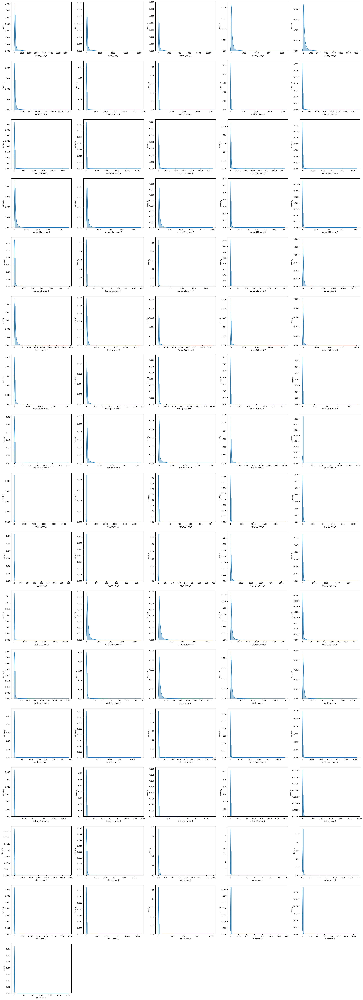

In [33]:
# Exploring the distribution for columns with null

plt.figure(figsize=(35, 100))
for i in range (0,len(cols_with_nulls)):
    plt.subplot(17,5,i+1)
    grp= sns.distplot(data_v1[cols_with_nulls[i]])
plt.show()

## <font color= Red> Observations

1. Most of the variables exhibit a wide distribution, but the majority of their values are either zero or fall within a range close to 100.  
2. Imputation using the mean is not appropriate, as the data is heavily skewed by outliers.  
3. Therefore, imputation will be performed using the median.

In [35]:
# Imputing with median
# Using simple imputer for this operation 

median_imputation = SimpleImputer(strategy='median', missing_values=np.nan)
data_v1[cols_with_nulls] = median_imputation.fit_transform(data_v1[cols_with_nulls])

In [36]:
data_v1.describe()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
count,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.00000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.00000,69999.000000
mean,283.134365,278.185912,278.858826,129.236765,129.993840,127.641721,194.825731,193.112523,191.002562,9.379276,6.745305,6.634328,13.625476,9.464386,9.254848,45.521038,44.838857,43.890335,91.173739,88.855772,88.435599,3.595161,3.632045,3.467948,1.081499,1.308807,1.345676,140.781376,137.782090,136.405430,77.431415,80.560009,79.055781,84.823656,88.167203,85.96945,1.081836,1.042449,1.001784,163.645994,170.062063,166.410655,0.812319,0.779964,0.797125,3.802082,4.785743,4.778142,0.444289,0.023487,0.031310,306.451436,310.572674,304.513065,46.765874,46.652352,45.605017,105

In [37]:
#missing values, sorting based on the percentage 
(round(data_v1.isnull().mean() * 100,2)).sort_values(ascending=False)

arpu_6                0.0
total_ic_mou_7        0.0
total_rech_num_8      0.0
total_rech_num_7      0.0
total_rech_num_6      0.0
ic_others_8           0.0
ic_others_7           0.0
ic_others_6           0.0
isd_ic_mou_8          0.0
isd_ic_mou_7          0.0
isd_ic_mou_6          0.0
spl_ic_mou_8          0.0
spl_ic_mou_7          0.0
spl_ic_mou_6          0.0
total_ic_mou_8        0.0
total_ic_mou_6        0.0
loc_ic_mou_6          0.0
std_ic_mou_8          0.0
std_ic_mou_7          0.0
std_ic_mou_6          0.0
std_ic_t2f_mou_8      0.0
std_ic_t2f_mou_7      0.0
std_ic_t2f_mou_6      0.0
std_ic_t2m_mou_8      0.0
std_ic_t2m_mou_7      0.0
std_ic_t2m_mou_6      0.0
std_ic_t2t_mou_8      0.0
std_ic_t2t_mou_7      0.0
std_ic_t2t_mou_6      0.0
loc_ic_mou_8          0.0
total_rech_amt_6      0.0
total_rech_amt_7      0.0
total_rech_amt_8      0.0
max_rech_amt_6        0.0
jun_vbc_3g            0.0
jul_vbc_3g            0.0
aug_vbc_3g            0.0
aon                   0.0
sachet_3g_8 

#### No missing values observed in after dropping and imputing missing values 

## <font color= Red> Conclusions

1. As per industry standards, dropped all the columns with more than 60% missing values. 
2. Dropped rows with single values   
3. Imputed the missing values for the columns with less than 7% with median values of the respective columns

#### We need to create a customer profile from this data to identify high-value customers. These customers may be characterized by a combination of high ARPU (Average Revenue Per User) and long AON (Age on Network). 

In [41]:
data_v1['aon_months'] = data_v1['aon'].apply(lambda x: round((x/365)*12,2))
data_v1['aon_months'].describe()

count    69999.000000
mean        40.130579
std         31.312540
min          5.920000
25%         15.390000
50%         28.540000
75%         59.610000
max        142.590000
Name: aon_months, dtype: float64

In [42]:
data_v1['mean_arpu'] = round((data_v1['arpu_6']+data_v1['arpu_7']+data_v1['arpu_8'])/3,2)
data_v1['mean_arpu'].describe()

count    69999.000000
mean       280.059710
std        310.243433
min         13.430000
25%        105.545000
50%        199.660000
75%        356.245000
max      32140.180000
Name: mean_arpu, dtype: float64

## <font color= Red> Observations
1. Age on network in months tells us the least usage was ~5 months an maximum of ~142 months on the network 
2. Mean revenue per user for 3 months is ~280 Units with median ~200 units
3. If we combine the aon_months and mean_arpu we can get the avg_customer_Spend and all other columns used for this imputation can be dropped

In [44]:
data_v1['avg_customer_Spend'] = data_v1['aon_months']*data_v1['mean_arpu']
data_v1['avg_customer_Spend'].describe()

count     69999.000000
mean      11536.980318
std       17394.719698
min          97.555700
25%        2418.859050
50%        5699.326500
75%       13618.172200
max      961875.738600
Name: avg_customer_Spend, dtype: float64

In [45]:
data_v1.drop(columns = ['aon','arpu_6','arpu_7','arpu_8','mean_arpu','aon_months'],axis=1,inplace=True)
data_v1.head()

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability,avg_customer_Spend
0,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,65,65,0,0.0,0.00,0.00,0.0,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,2699.6778
1,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,0,0,0,0.0,352.91,0.00,0.0,3.96,0.0,0,0,0,0,0,0,0,1,0,0,0,0,0.0,0.0,0.0,0,1289.5350
2,0.53,15.93,0.00,53.99,82.05,0.00,0.00,0.0,0.0,0.00,0.0,0.00,0.53,12.98,0.00,24.11,0.00,0.00,0.00,0.00,0.00,2.14,0.00,0.00,24.64,12.98,0.00,0.00,2.94,0.00,28.94,82.05,0.0,0.00,0.0,0.0,28.94,84.99,0.00,0.0,0.0,0.0,2.89,1.38,0.00,0.00,0.0,0.0,56.49,99.36,0.00,4.51,6.16,6.49,89.86,25.18,23.51,0.00,0.00,0.00,94.38,31.34,30.01,11.69,0.00,0.00,18.21,2.48,6.38,0.0,0.0,0.0,29.91,2.48,6.38,124.29,33.83,36.64,0.0,0.0,0.00,0.0,0.0,0.0,0.00,0.00,0.25,2,4,2,70,120,0,70,70,0,70,50,0,0.0,0.00,0.00,0.0,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1585.1400
3,7.26,16.01,0.00,68.76,78.48,50.23,0.00,0.0,0.0,0.00,0.0,1.63,6.99,3.94,0.00,37.91,44.89,23.63,0.00,0.00,0.00,0.00,0.00,8.03,44.91,48.84,23.63,0.26,12.06,0.00,15.33,25.93,4.6,0.56,0.0,0.0,16.16,37.99,4.60,0.0,0.0,0.0,14.95,9.13,25.61,0.00,0.0,0.0,76.03,95.98,53.84,24.98,4.84,23.88,53.99,44.23,57.14,7.23,0.81,0.00,86.21,49.89,81.03,0.00,0.00,0.00,8.89,0.28,2.81,0.0,0.0,0.0,8.89,0.28,2.81,95.11,50.18,83.84,0.0,0.0,0.00,0.0,0.0,0.0,0.00,0.00,0.00,2,4,3,160,240,130,110,110,50,110,110,50,0.0,0.00,0.00,0.0,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,5086.359

In [46]:
data_v1.shape

(69999, 122)

In [47]:
HVC = data_v1['avg_customer_Spend'].quantile(0.65) #High value customers
LVC = data_v1['avg_customer_Spend'].quantile(0.2) #low value customers

data_v1['customer_value'] = data_v1['avg_customer_Spend'].apply(
    lambda x: 'HVC' if x > HVC else ('LVC' if x < LVC else 'MVC')) # MVC- Medium value customers

data_v1['customer_value'].value_counts()

customer_value
MVC    31499
HVC    24500
LVC    14000
Name: count, dtype: int64

## <font color= Red> Observations
1. We now have a clear understanding of customer value, allowing the telecom operator to identify and prioritize customers for maximum retention.

## 2.3 Outlier treatment and Visualization (EDA)

maximum value for onnet_mou_6 is: 7376.71 
minimum value for onnet_mou_6 is: 0.0 
median value for onnet_mou_6 is: 34.11


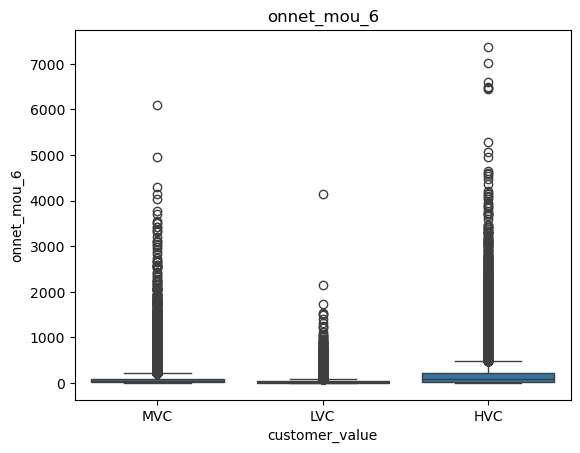

maximum value for onnet_mou_7 is: 8157.78 
minimum value for onnet_mou_7 is: 0.0 
median value for onnet_mou_7 is: 32.28


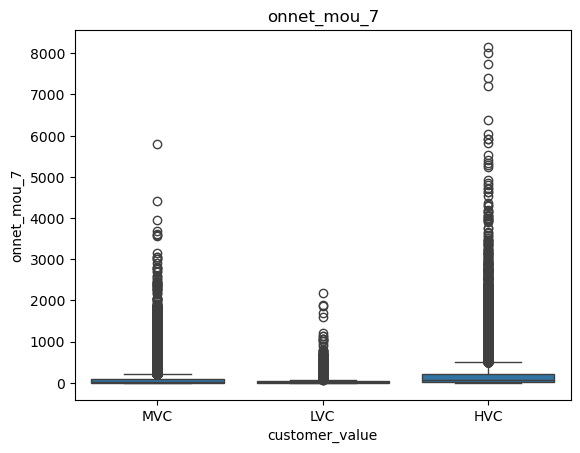

maximum value for onnet_mou_8 is: 10752.56 
minimum value for onnet_mou_8 is: 0.0 
median value for onnet_mou_8 is: 32.1


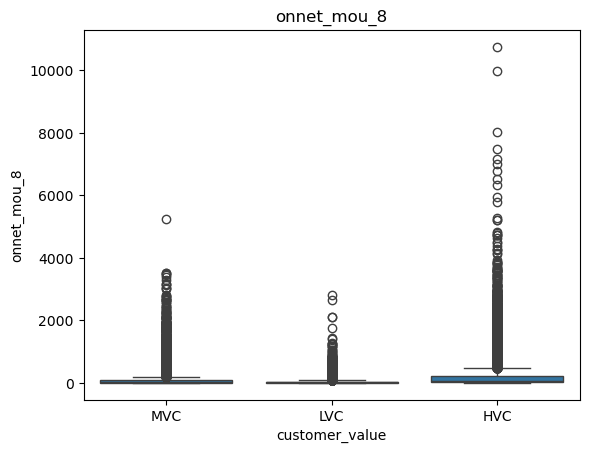

maximum value for offnet_mou_6 is: 8362.36 
minimum value for offnet_mou_6 is: 0.0 
median value for offnet_mou_6 is: 96.48


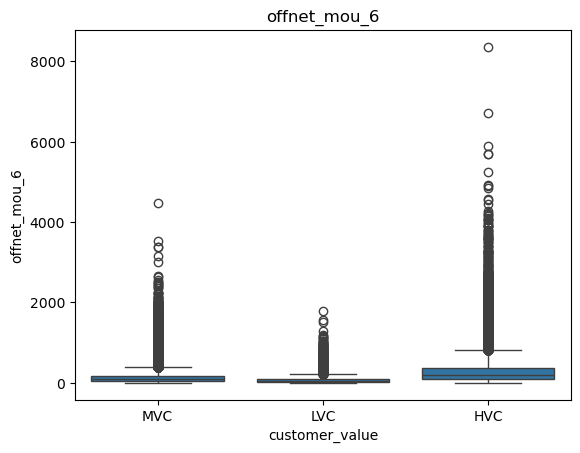

maximum value for offnet_mou_7 is: 7043.98 
minimum value for offnet_mou_7 is: 0.0 
median value for offnet_mou_7 is: 91.88499999999999


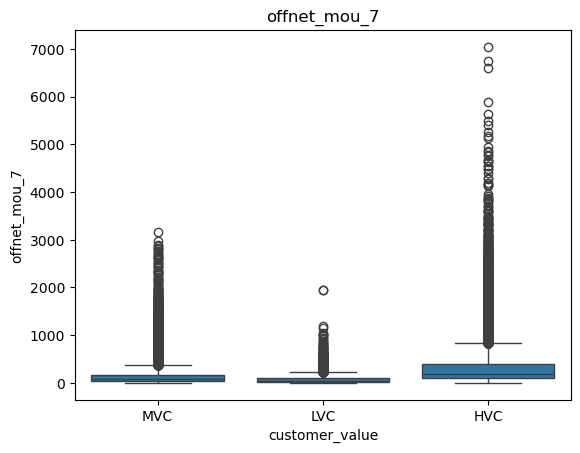

maximum value for offnet_mou_8 is: 14007.34 
minimum value for offnet_mou_8 is: 0.0 
median value for offnet_mou_8 is: 91.80000000000001


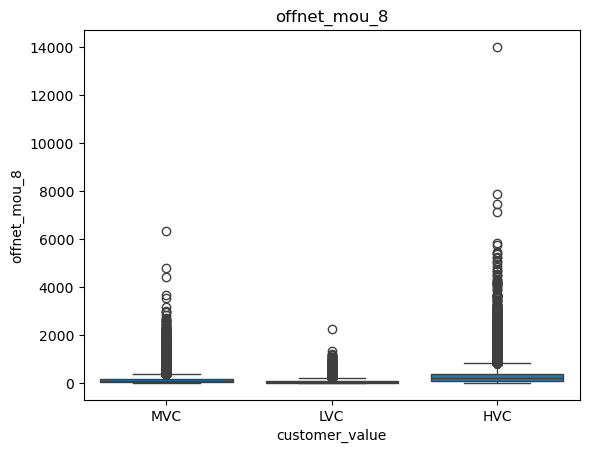

maximum value for roam_ic_mou_6 is: 2850.98 
minimum value for roam_ic_mou_6 is: 0.0 
median value for roam_ic_mou_6 is: 0.0


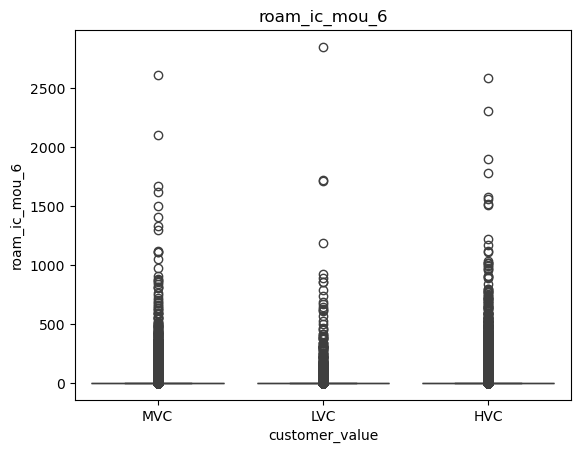

maximum value for roam_ic_mou_7 is: 4155.83 
minimum value for roam_ic_mou_7 is: 0.0 
median value for roam_ic_mou_7 is: 0.0


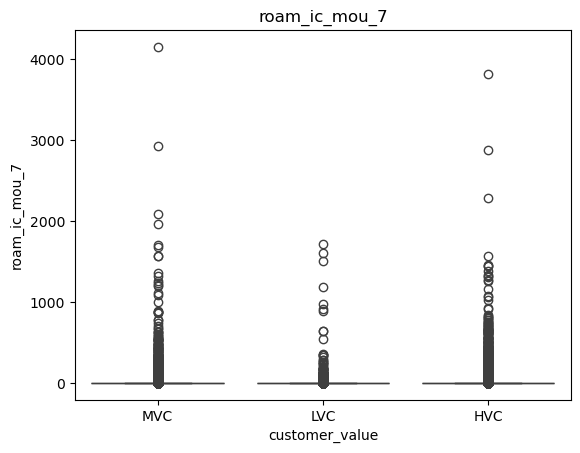

maximum value for roam_ic_mou_8 is: 4169.81 
minimum value for roam_ic_mou_8 is: 0.0 
median value for roam_ic_mou_8 is: 0.0


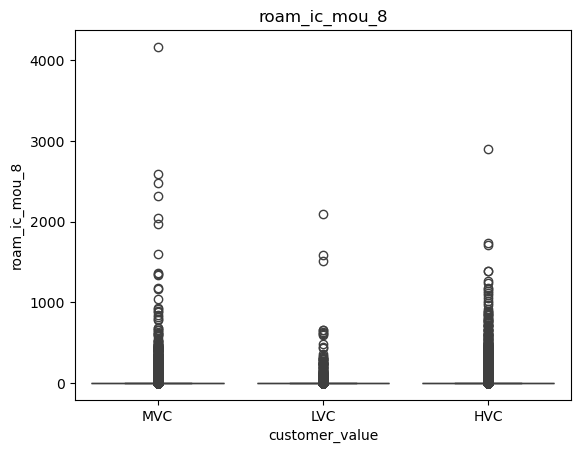

maximum value for roam_og_mou_6 is: 3775.11 
minimum value for roam_og_mou_6 is: 0.0 
median value for roam_og_mou_6 is: 0.0


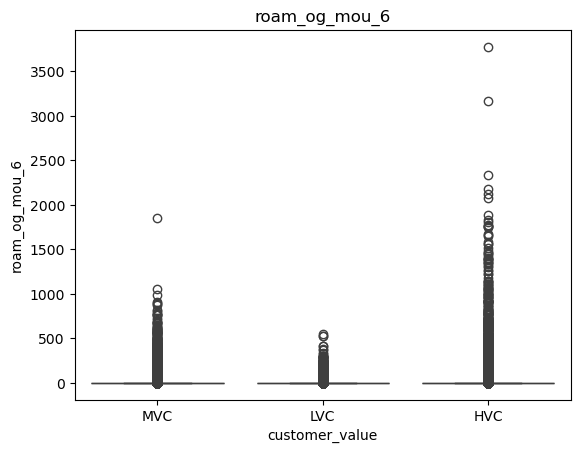

maximum value for roam_og_mou_7 is: 2812.04 
minimum value for roam_og_mou_7 is: 0.0 
median value for roam_og_mou_7 is: 0.0


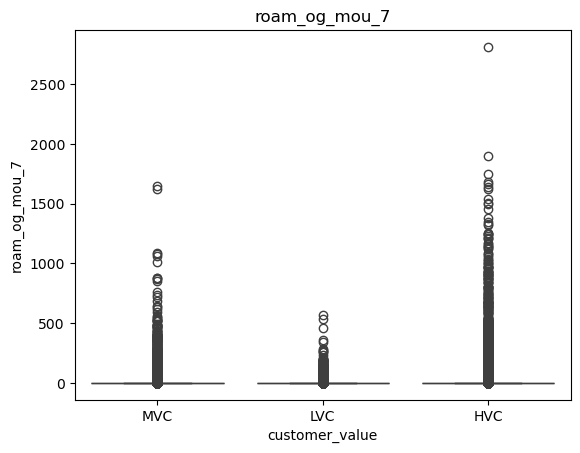

maximum value for roam_og_mou_8 is: 5337.04 
minimum value for roam_og_mou_8 is: 0.0 
median value for roam_og_mou_8 is: 0.0


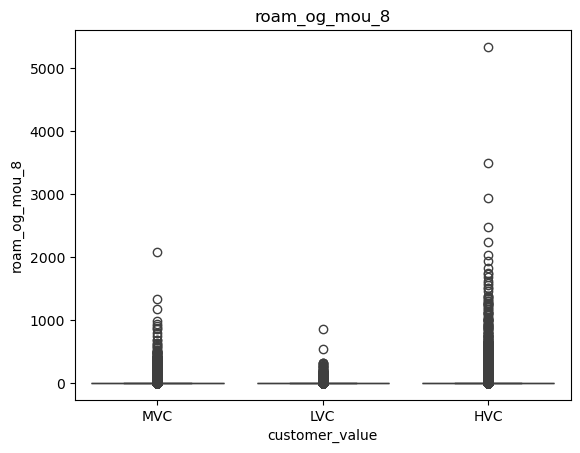

maximum value for loc_og_t2t_mou_6 is: 6431.33 
minimum value for loc_og_t2t_mou_6 is: 0.0 
median value for loc_og_t2t_mou_6 is: 11.91


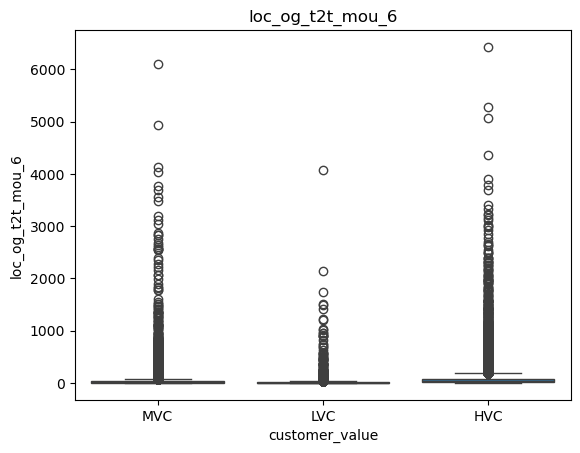

maximum value for loc_og_t2t_mou_7 is: 7400.66 
minimum value for loc_og_t2t_mou_7 is: 0.0 
median value for loc_og_t2t_mou_7 is: 11.58


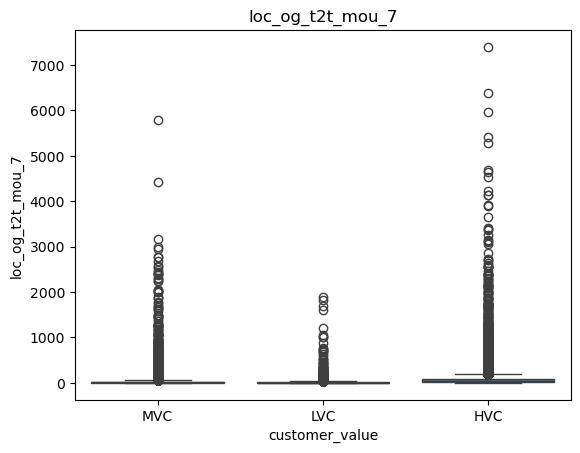

maximum value for loc_og_t2t_mou_8 is: 10752.56 
minimum value for loc_og_t2t_mou_8 is: 0.0 
median value for loc_og_t2t_mou_8 is: 11.74


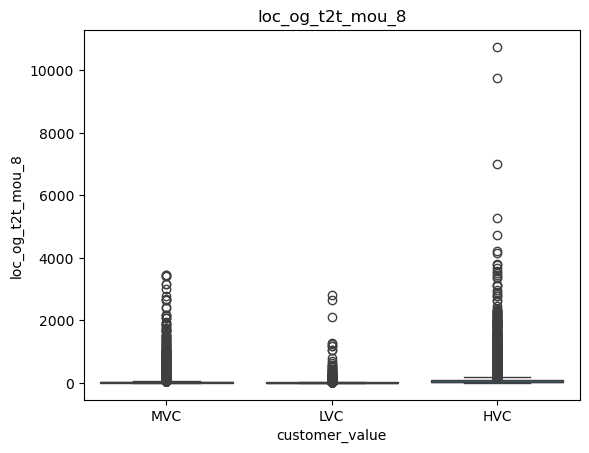

maximum value for loc_og_t2m_mou_6 is: 4696.83 
minimum value for loc_og_t2m_mou_6 is: 0.0 
median value for loc_og_t2m_mou_6 is: 41.03


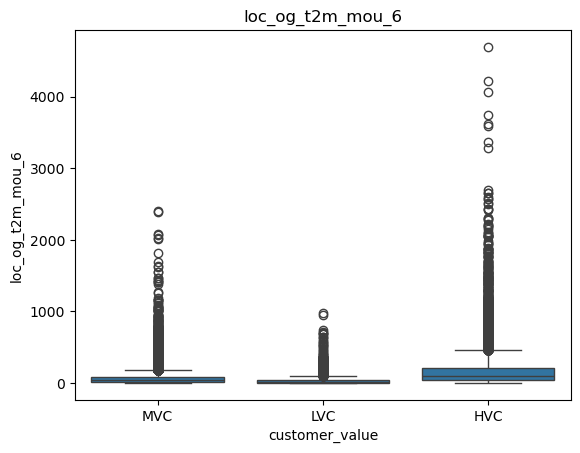

maximum value for loc_og_t2m_mou_7 is: 4557.14 
minimum value for loc_og_t2m_mou_7 is: 0.0 
median value for loc_og_t2m_mou_7 is: 40.17


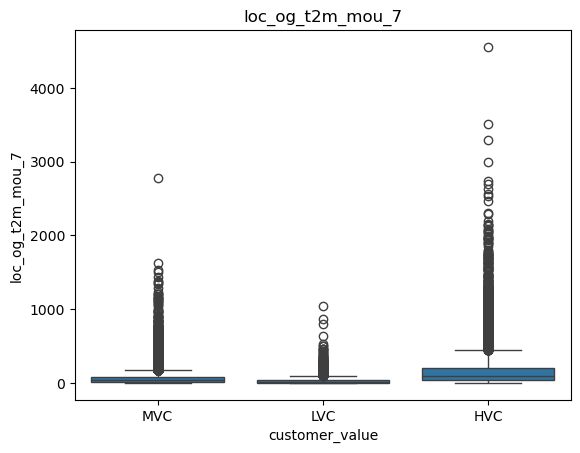

maximum value for loc_og_t2m_mou_8 is: 4961.33 
minimum value for loc_og_t2m_mou_8 is: 0.0 
median value for loc_og_t2m_mou_8 is: 40.35


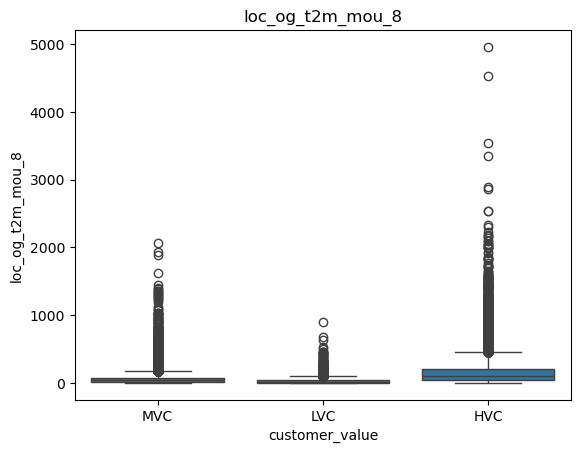

maximum value for loc_og_t2f_mou_6 is: 617.58 
minimum value for loc_og_t2f_mou_6 is: 0.0 
median value for loc_og_t2f_mou_6 is: 0.0


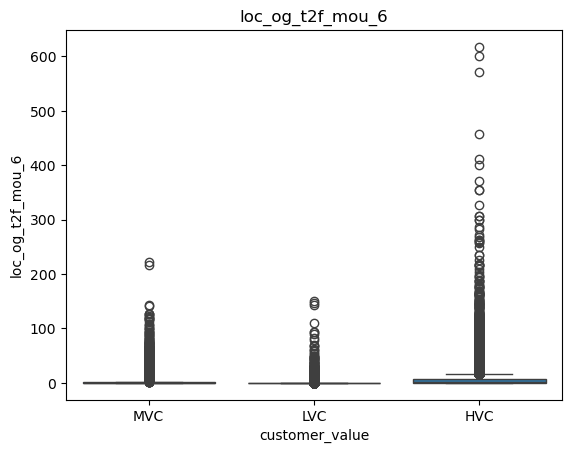

maximum value for loc_og_t2f_mou_7 is: 815.33 
minimum value for loc_og_t2f_mou_7 is: 0.0 
median value for loc_og_t2f_mou_7 is: 0.0


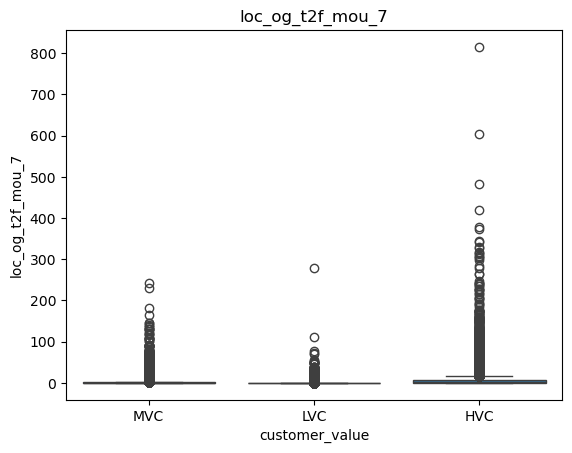

maximum value for loc_og_t2f_mou_8 is: 588.29 
minimum value for loc_og_t2f_mou_8 is: 0.0 
median value for loc_og_t2f_mou_8 is: 0.0


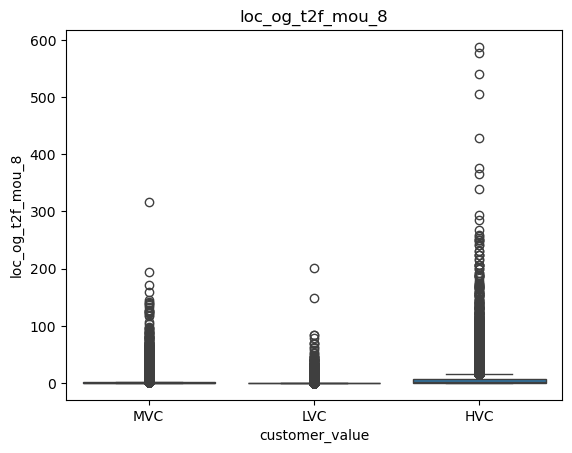

maximum value for loc_og_t2c_mou_6 is: 342.86 
minimum value for loc_og_t2c_mou_6 is: 0.0 
median value for loc_og_t2c_mou_6 is: 0.0


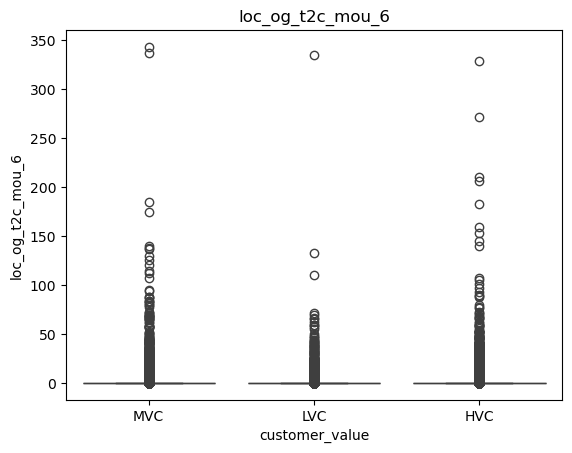

maximum value for loc_og_t2c_mou_7 is: 916.24 
minimum value for loc_og_t2c_mou_7 is: 0.0 
median value for loc_og_t2c_mou_7 is: 0.0


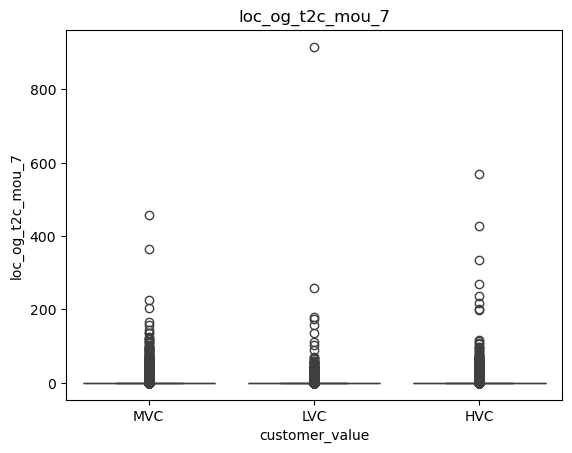

maximum value for loc_og_t2c_mou_8 is: 351.83 
minimum value for loc_og_t2c_mou_8 is: 0.0 
median value for loc_og_t2c_mou_8 is: 0.0


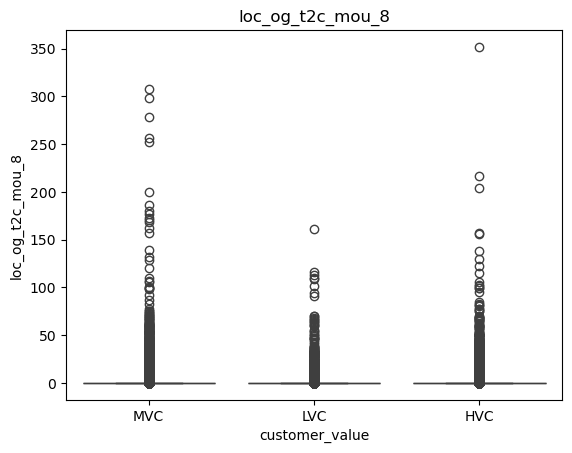

maximum value for loc_og_mou_6 is: 10643.38 
minimum value for loc_og_mou_6 is: 0.0 
median value for loc_og_mou_6 is: 65.19


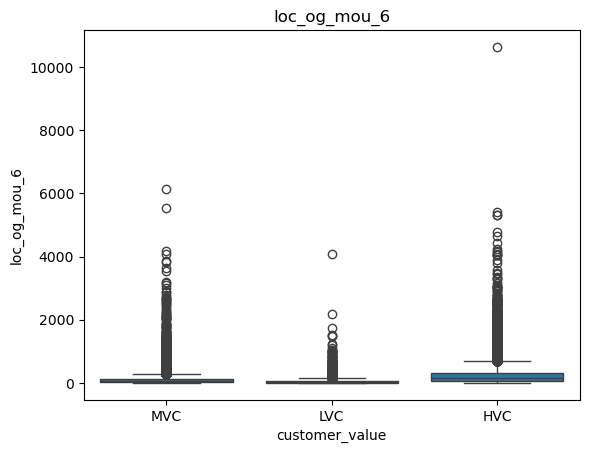

maximum value for loc_og_mou_7 is: 7674.78 
minimum value for loc_og_mou_7 is: 0.0 
median value for loc_og_mou_7 is: 63.43


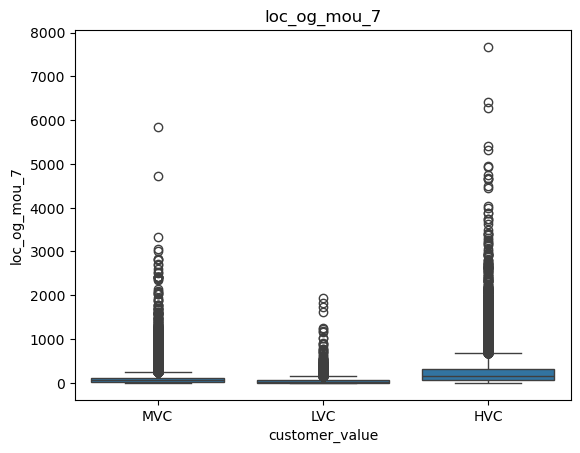

maximum value for loc_og_mou_8 is: 11039.91 
minimum value for loc_og_mou_8 is: 0.0 
median value for loc_og_mou_8 is: 63.519999999999996


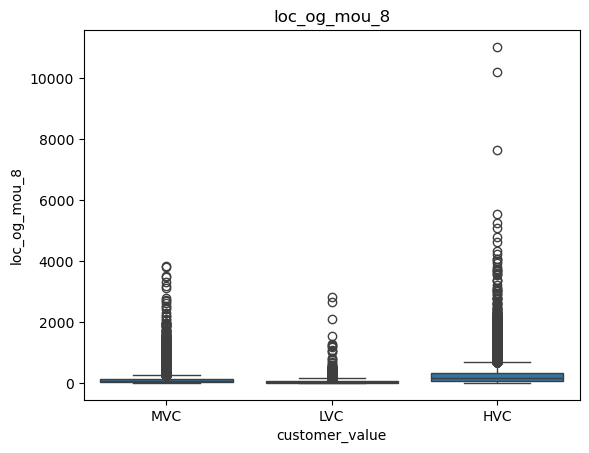

maximum value for std_og_t2t_mou_6 is: 7366.58 
minimum value for std_og_t2t_mou_6 is: 0.0 
median value for std_og_t2t_mou_6 is: 0.0


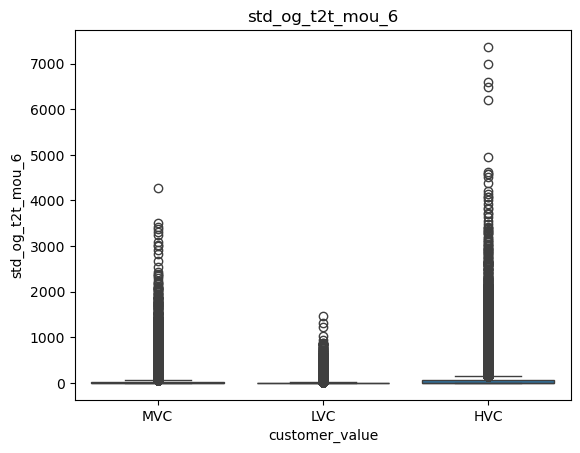

maximum value for std_og_t2t_mou_7 is: 8133.66 
minimum value for std_og_t2t_mou_7 is: 0.0 
median value for std_og_t2t_mou_7 is: 0.0


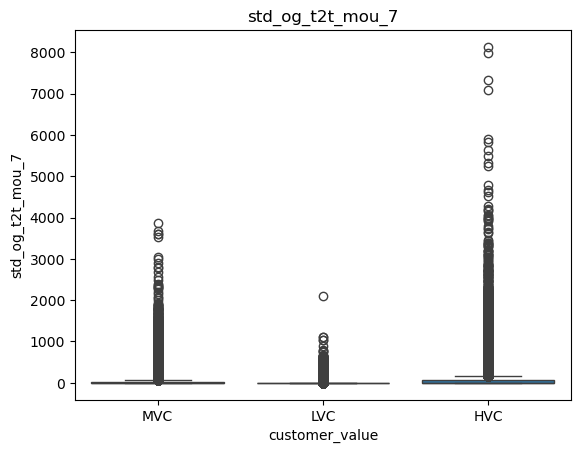

maximum value for std_og_t2t_mou_8 is: 8014.43 
minimum value for std_og_t2t_mou_8 is: 0.0 
median value for std_og_t2t_mou_8 is: 0.0


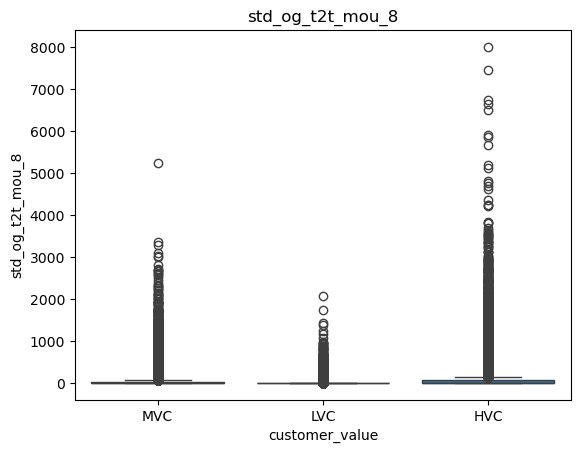

maximum value for std_og_t2m_mou_6 is: 8314.76 
minimum value for std_og_t2m_mou_6 is: 0.0 
median value for std_og_t2m_mou_6 is: 3.98


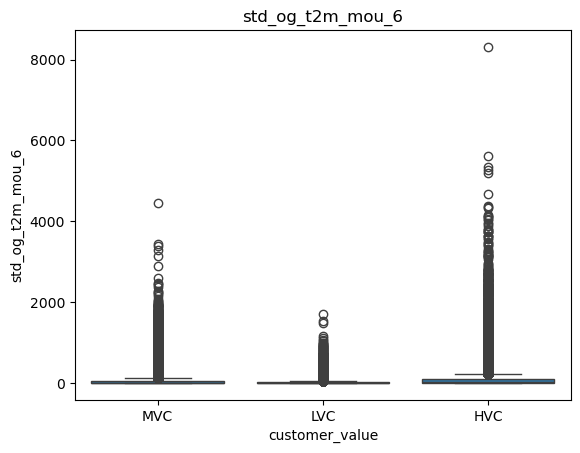

maximum value for std_og_t2m_mou_7 is: 6622.54 
minimum value for std_og_t2m_mou_7 is: 0.0 
median value for std_og_t2m_mou_7 is: 3.71


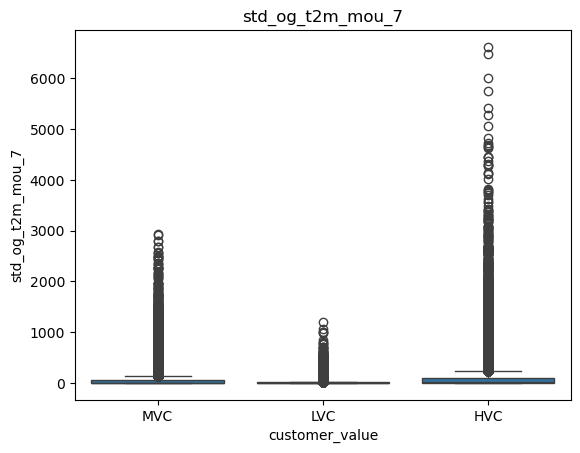

maximum value for std_og_t2m_mou_8 is: 13950.04 
minimum value for std_og_t2m_mou_8 is: 0.0 
median value for std_og_t2m_mou_8 is: 3.3


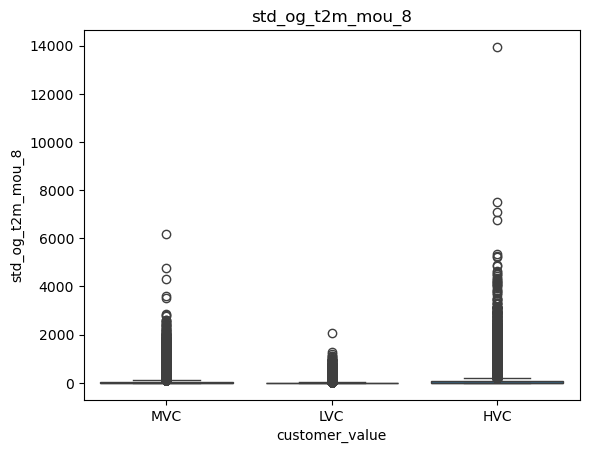

maximum value for std_og_t2f_mou_6 is: 628.56 
minimum value for std_og_t2f_mou_6 is: 0.0 
median value for std_og_t2f_mou_6 is: 0.0


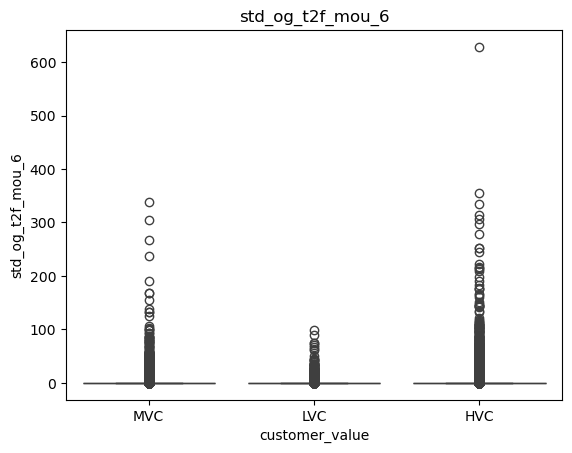

maximum value for std_og_t2f_mou_7 is: 465.79 
minimum value for std_og_t2f_mou_7 is: 0.0 
median value for std_og_t2f_mou_7 is: 0.0


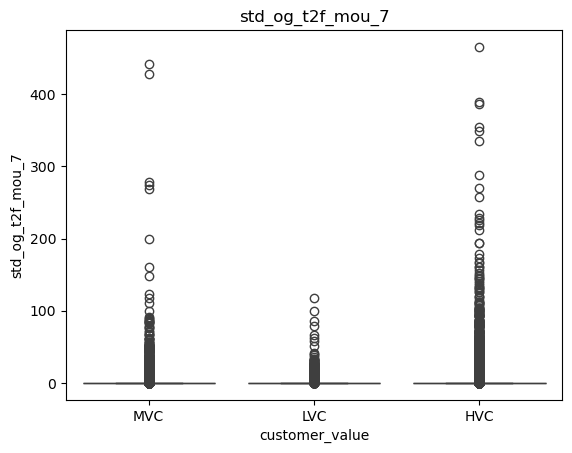

maximum value for std_og_t2f_mou_8 is: 354.16 
minimum value for std_og_t2f_mou_8 is: 0.0 
median value for std_og_t2f_mou_8 is: 0.0


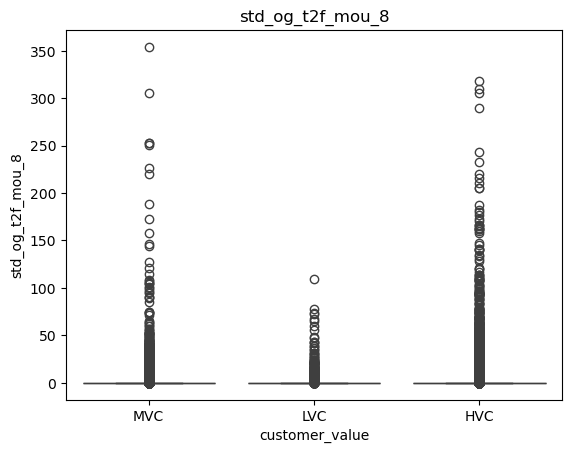

maximum value for std_og_mou_6 is: 8432.99 
minimum value for std_og_mou_6 is: 0.0 
median value for std_og_mou_6 is: 11.73


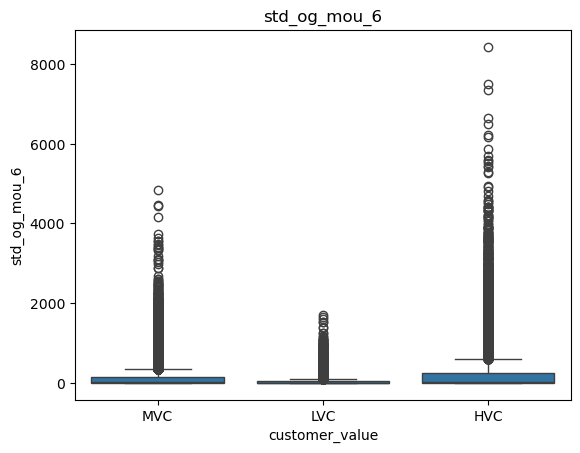

maximum value for std_og_mou_7 is: 8155.53 
minimum value for std_og_mou_7 is: 0.0 
median value for std_og_mou_7 is: 11.26


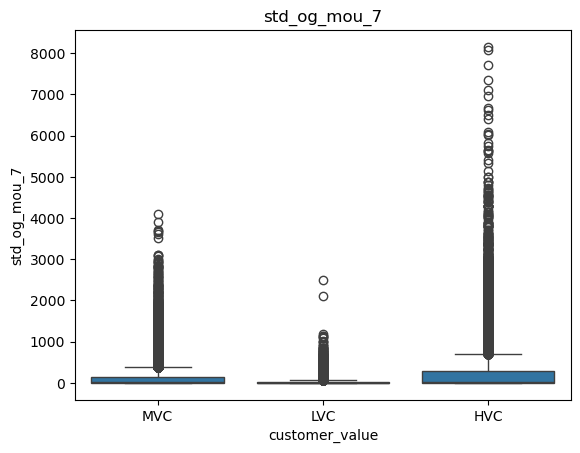

maximum value for std_og_mou_8 is: 13980.06 
minimum value for std_og_mou_8 is: 0.0 
median value for std_og_mou_8 is: 10.504999999999999


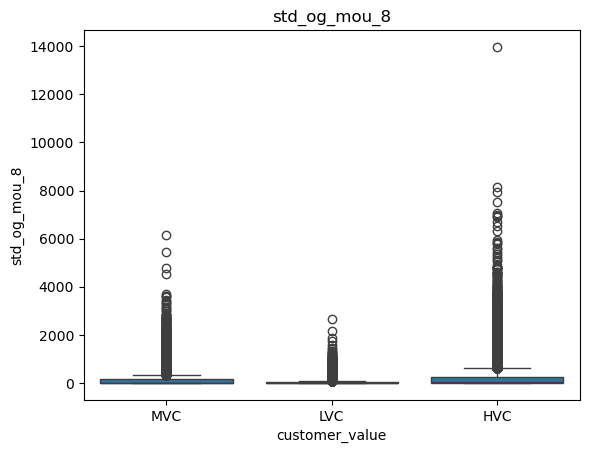

maximum value for isd_og_mou_6 is: 5900.66 
minimum value for isd_og_mou_6 is: 0.0 
median value for isd_og_mou_6 is: 0.0


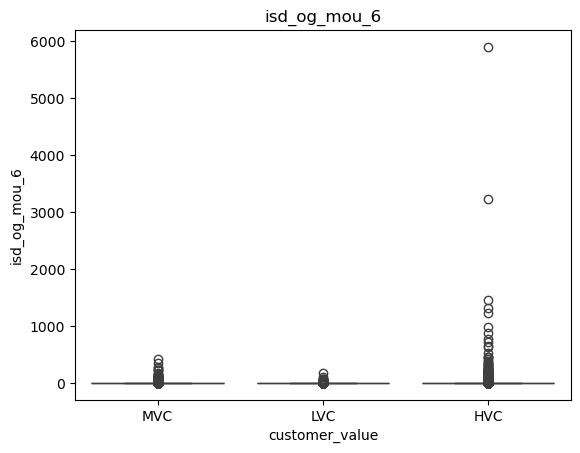

maximum value for isd_og_mou_7 is: 5490.28 
minimum value for isd_og_mou_7 is: 0.0 
median value for isd_og_mou_7 is: 0.0


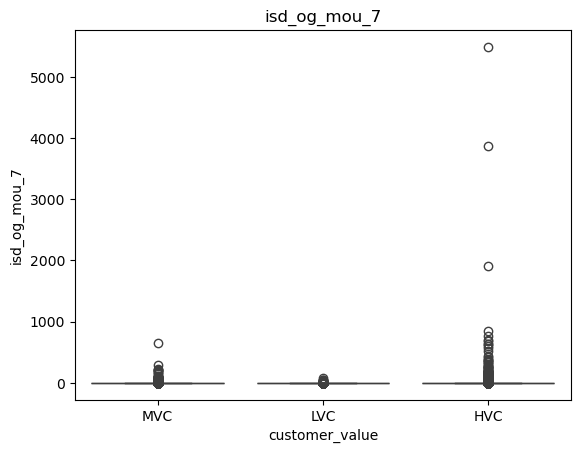

maximum value for isd_og_mou_8 is: 5681.54 
minimum value for isd_og_mou_8 is: 0.0 
median value for isd_og_mou_8 is: 0.0


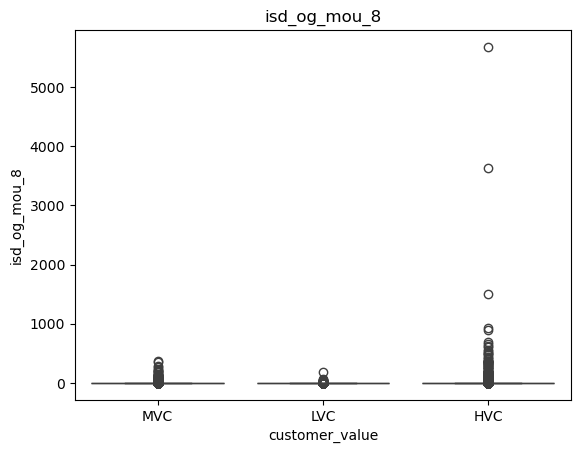

maximum value for spl_og_mou_6 is: 1023.21 
minimum value for spl_og_mou_6 is: 0.0 
median value for spl_og_mou_6 is: 0.0


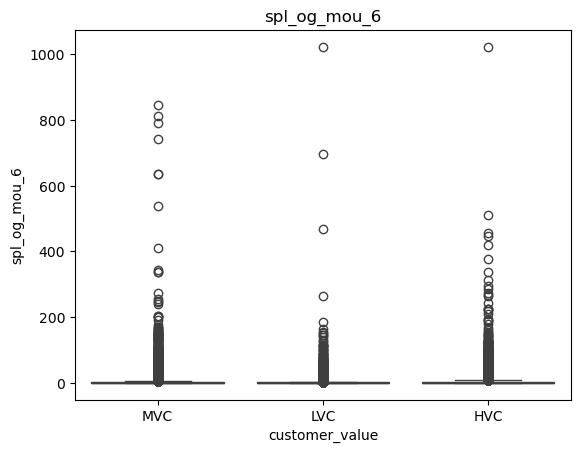

maximum value for spl_og_mou_7 is: 2372.51 
minimum value for spl_og_mou_7 is: 0.0 
median value for spl_og_mou_7 is: 0.0


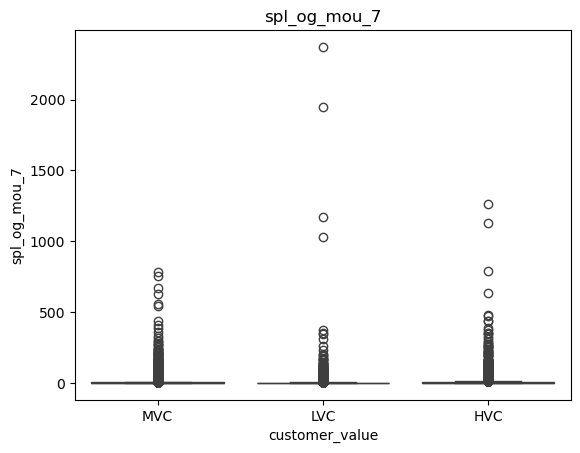

maximum value for spl_og_mou_8 is: 1075.08 
minimum value for spl_og_mou_8 is: 0.0 
median value for spl_og_mou_8 is: 0.0


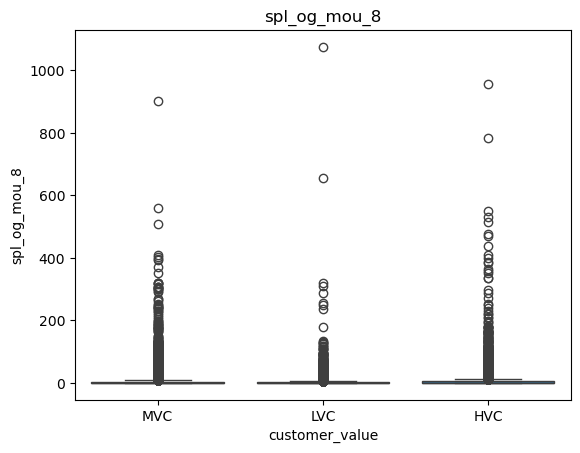

maximum value for og_others_6 is: 800.89 
minimum value for og_others_6 is: 0.0 
median value for og_others_6 is: 0.0


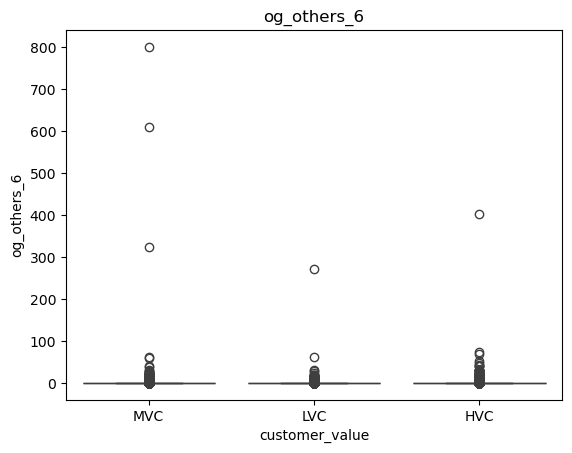

maximum value for og_others_7 is: 270.24 
minimum value for og_others_7 is: 0.0 
median value for og_others_7 is: 0.0


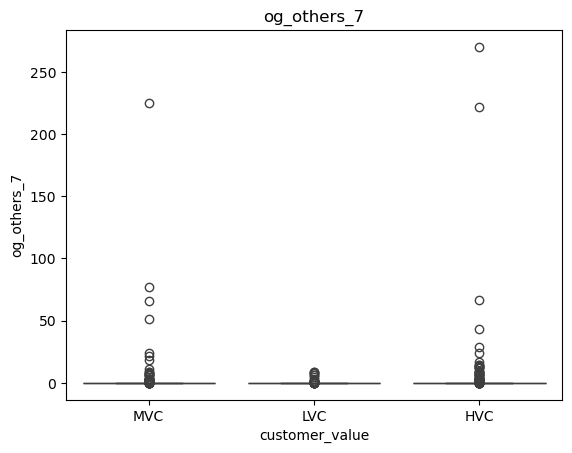

maximum value for og_others_8 is: 394.93 
minimum value for og_others_8 is: 0.0 
median value for og_others_8 is: 0.0


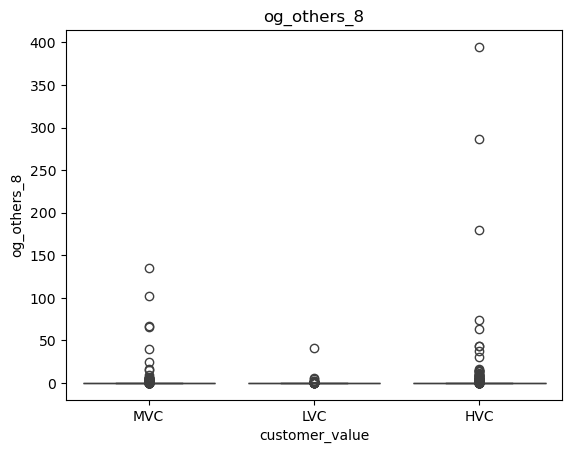

maximum value for total_og_mou_6 is: 10674.03 
minimum value for total_og_mou_6 is: 0.0 
median value for total_og_mou_6 is: 145.28


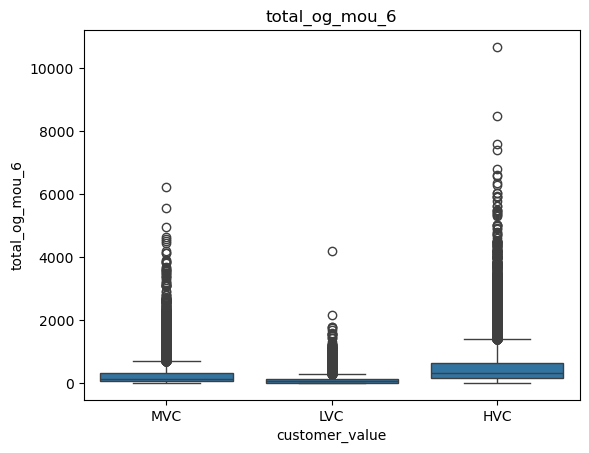

maximum value for total_og_mou_7 is: 8285.64 
minimum value for total_og_mou_7 is: 0.0 
median value for total_og_mou_7 is: 141.23


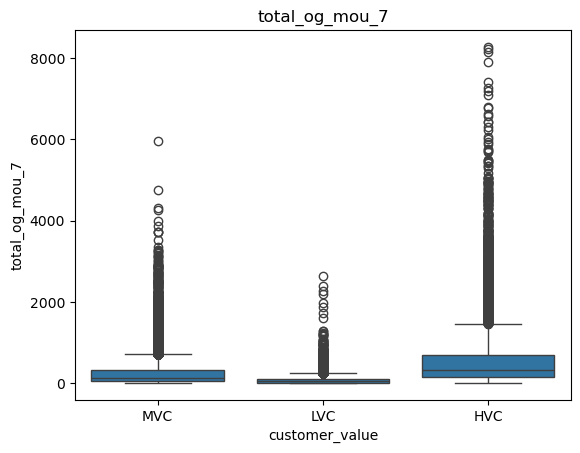

maximum value for total_og_mou_8 is: 14043.06 
minimum value for total_og_mou_8 is: 0.0 
median value for total_og_mou_8 is: 138.36


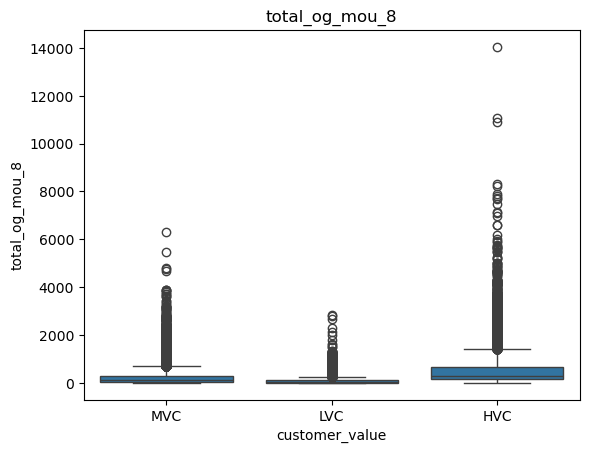

maximum value for loc_ic_t2t_mou_6 is: 5315.59 
minimum value for loc_ic_t2t_mou_6 is: 0.0 
median value for loc_ic_t2t_mou_6 is: 15.74


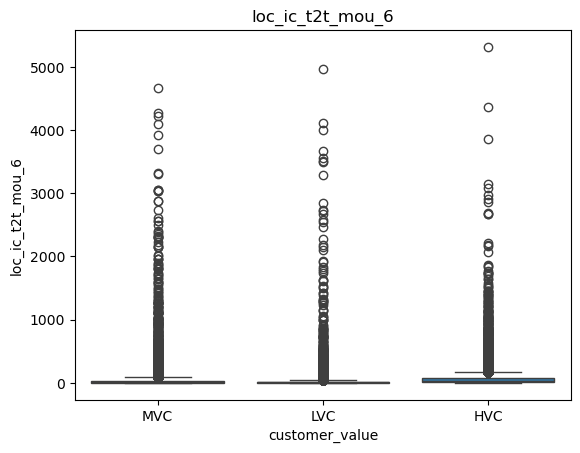

maximum value for loc_ic_t2t_mou_7 is: 9324.66 
minimum value for loc_ic_t2t_mou_7 is: 0.0 
median value for loc_ic_t2t_mou_7 is: 15.83


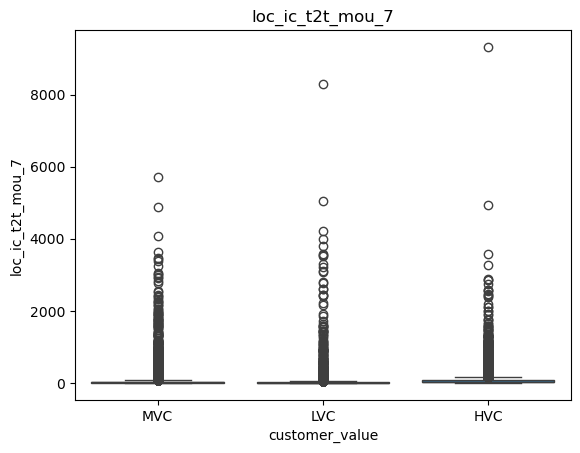

maximum value for loc_ic_t2t_mou_8 is: 10696.23 
minimum value for loc_ic_t2t_mou_8 is: 0.0 
median value for loc_ic_t2t_mou_8 is: 16.04


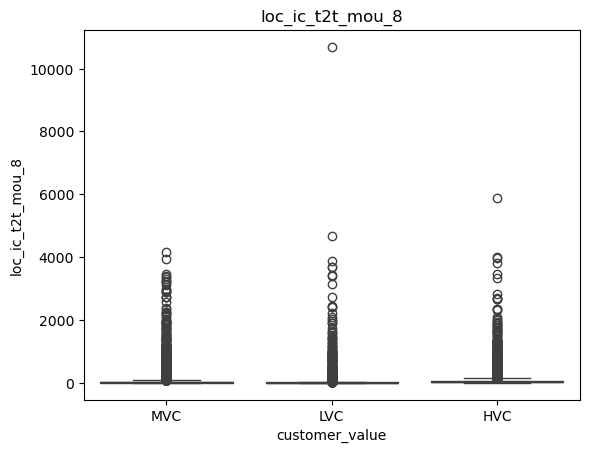

maximum value for loc_ic_t2m_mou_6 is: 4450.74 
minimum value for loc_ic_t2m_mou_6 is: 0.0 
median value for loc_ic_t2m_mou_6 is: 56.46


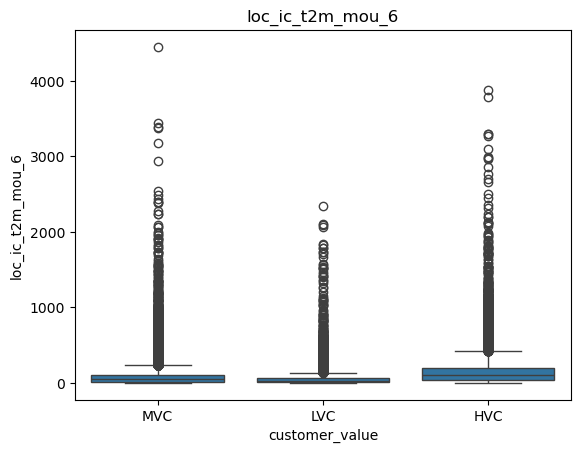

maximum value for loc_ic_t2m_mou_7 is: 4455.83 
minimum value for loc_ic_t2m_mou_7 is: 0.0 
median value for loc_ic_t2m_mou_7 is: 56.93


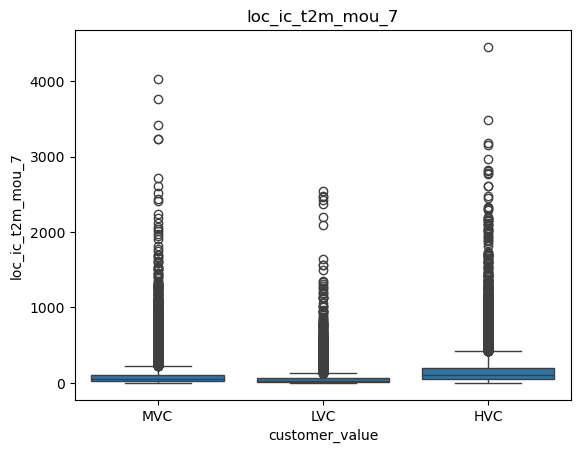

maximum value for loc_ic_t2m_mou_8 is: 6274.19 
minimum value for loc_ic_t2m_mou_8 is: 0.0 
median value for loc_ic_t2m_mou_8 is: 58.21


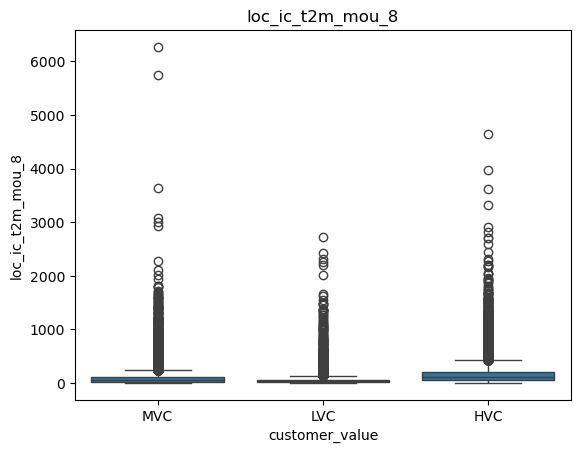

maximum value for loc_ic_t2f_mou_6 is: 1872.34 
minimum value for loc_ic_t2f_mou_6 is: 0.0 
median value for loc_ic_t2f_mou_6 is: 0.88


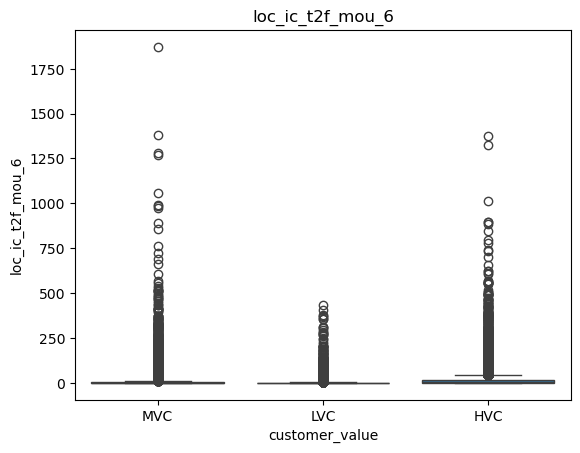

maximum value for loc_ic_t2f_mou_7 is: 1983.01 
minimum value for loc_ic_t2f_mou_7 is: 0.0 
median value for loc_ic_t2f_mou_7 is: 0.91


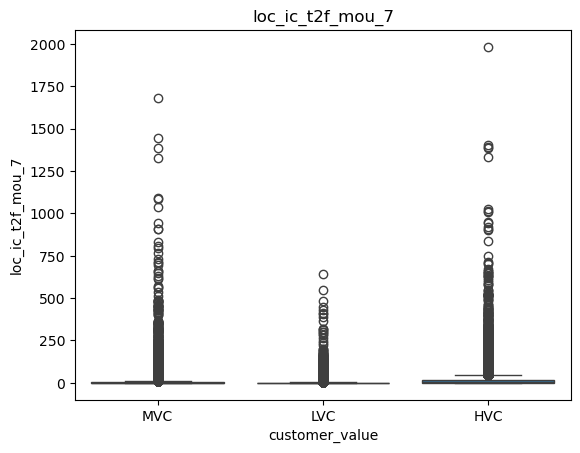

maximum value for loc_ic_t2f_mou_8 is: 1676.58 
minimum value for loc_ic_t2f_mou_8 is: 0.0 
median value for loc_ic_t2f_mou_8 is: 0.93


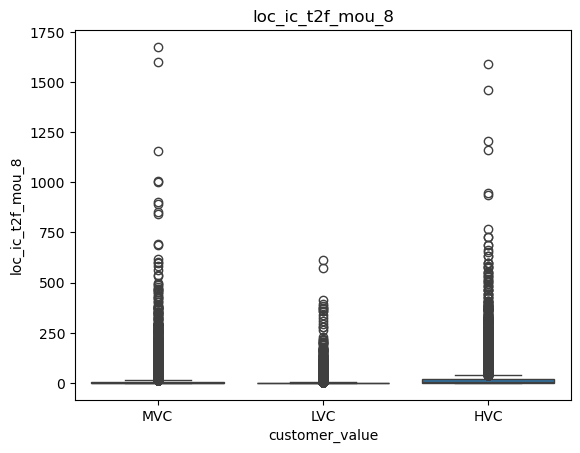

maximum value for loc_ic_mou_6 is: 7454.63 
minimum value for loc_ic_mou_6 is: 0.0 
median value for loc_ic_mou_6 is: 92.43


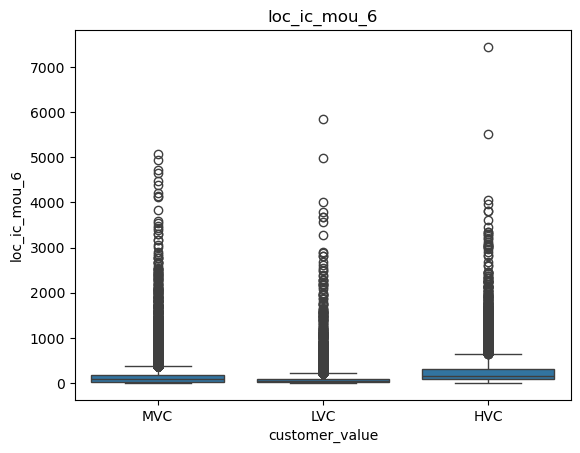

maximum value for loc_ic_mou_7 is: 9669.91 
minimum value for loc_ic_mou_7 is: 0.0 
median value for loc_ic_mou_7 is: 92.51


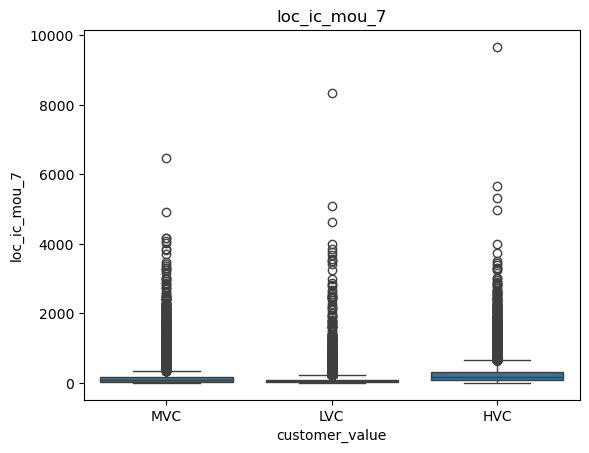

maximum value for loc_ic_mou_8 is: 10830.16 
minimum value for loc_ic_mou_8 is: 0.0 
median value for loc_ic_mou_8 is: 93.89


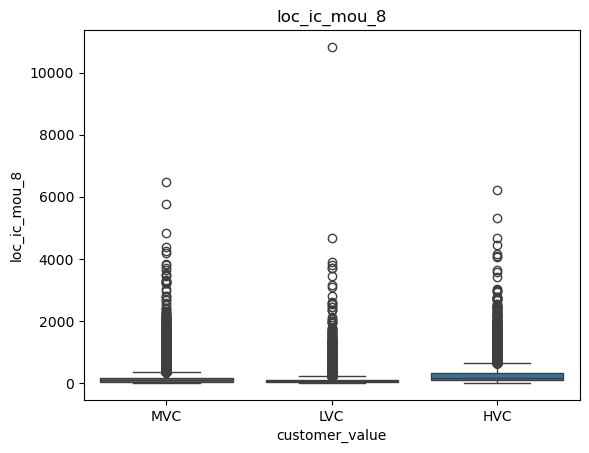

maximum value for std_ic_t2t_mou_6 is: 3336.38 
minimum value for std_ic_t2t_mou_6 is: 0.0 
median value for std_ic_t2t_mou_6 is: 0.0


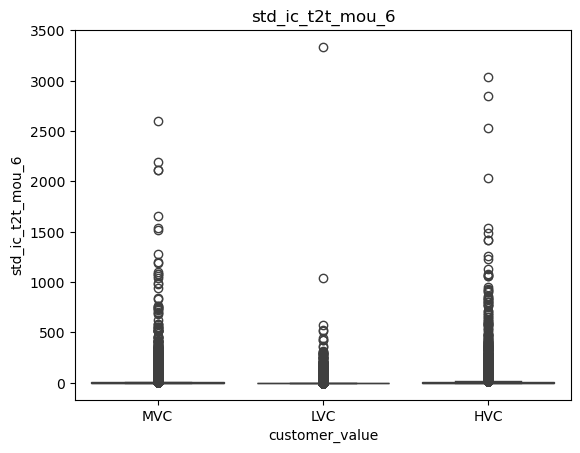

maximum value for std_ic_t2t_mou_7 is: 4708.71 
minimum value for std_ic_t2t_mou_7 is: 0.0 
median value for std_ic_t2t_mou_7 is: 0.0


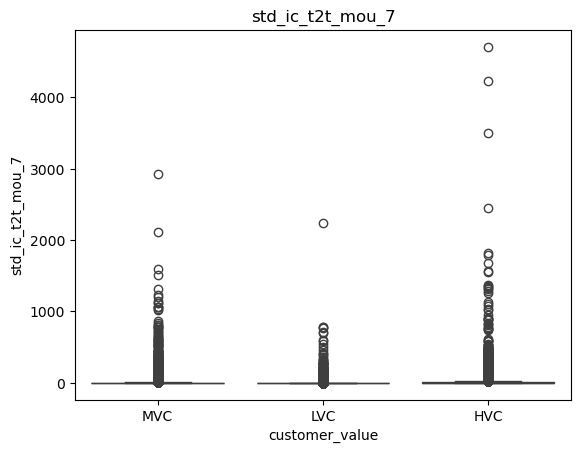

maximum value for std_ic_t2t_mou_8 is: 3930.24 
minimum value for std_ic_t2t_mou_8 is: 0.0 
median value for std_ic_t2t_mou_8 is: 0.0


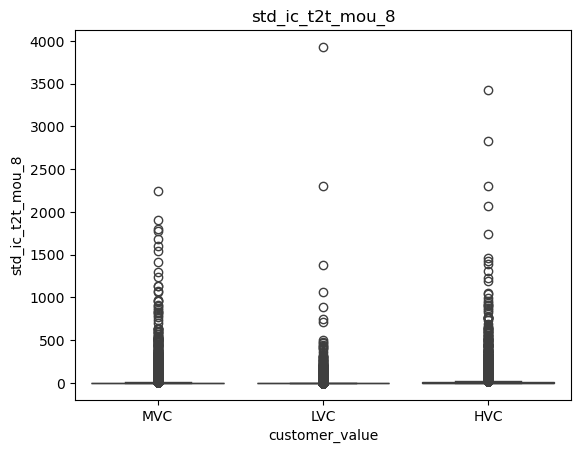

maximum value for std_ic_t2m_mou_6 is: 5647.16 
minimum value for std_ic_t2m_mou_6 is: 0.0 
median value for std_ic_t2m_mou_6 is: 2.04


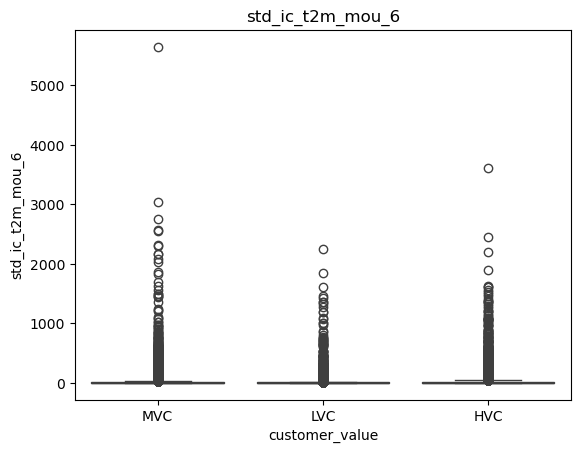

maximum value for std_ic_t2m_mou_7 is: 6141.88 
minimum value for std_ic_t2m_mou_7 is: 0.0 
median value for std_ic_t2m_mou_7 is: 2.06


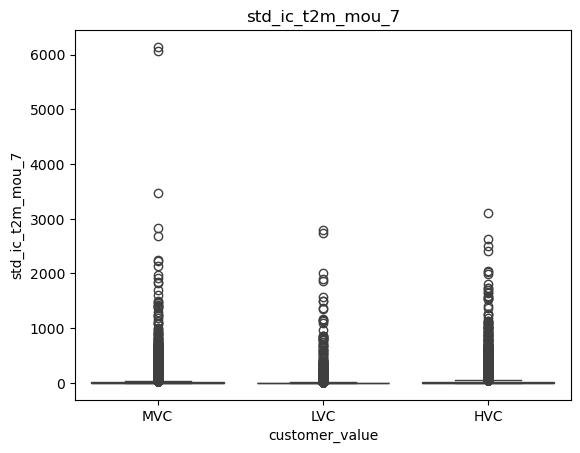

maximum value for std_ic_t2m_mou_8 is: 5512.76 
minimum value for std_ic_t2m_mou_8 is: 0.0 
median value for std_ic_t2m_mou_8 is: 2.03


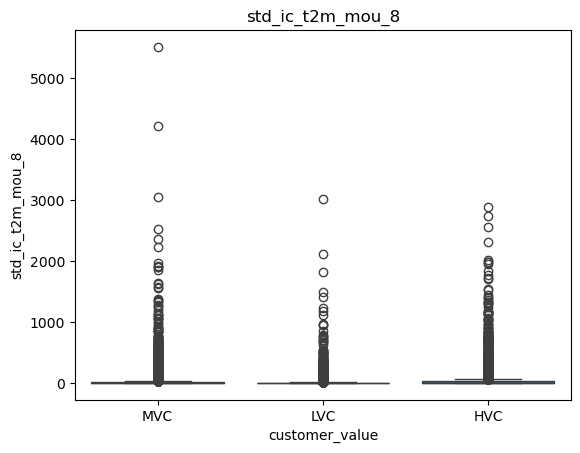

maximum value for std_ic_t2f_mou_6 is: 1351.11 
minimum value for std_ic_t2f_mou_6 is: 0.0 
median value for std_ic_t2f_mou_6 is: 0.0


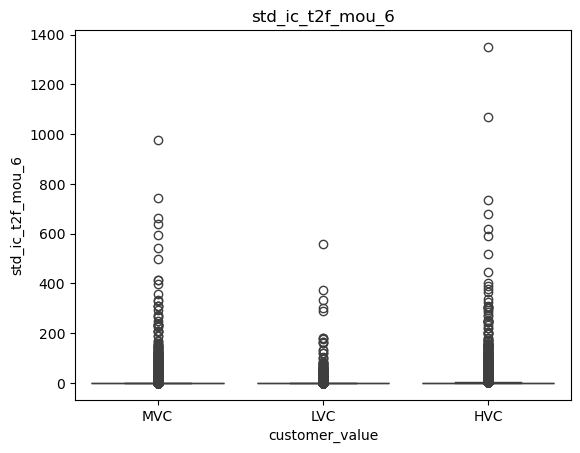

maximum value for std_ic_t2f_mou_7 is: 1136.08 
minimum value for std_ic_t2f_mou_7 is: 0.0 
median value for std_ic_t2f_mou_7 is: 0.0


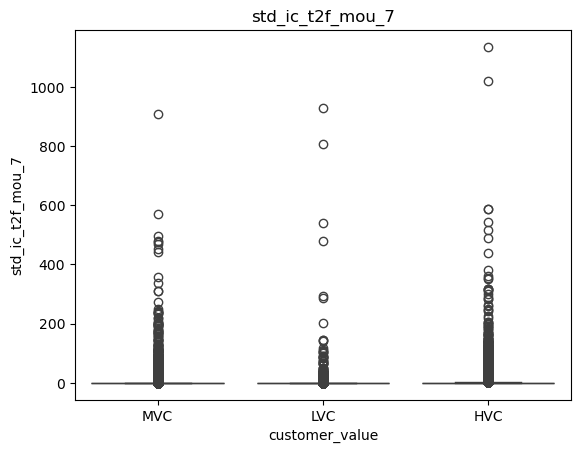

maximum value for std_ic_t2f_mou_8 is: 1394.89 
minimum value for std_ic_t2f_mou_8 is: 0.0 
median value for std_ic_t2f_mou_8 is: 0.0


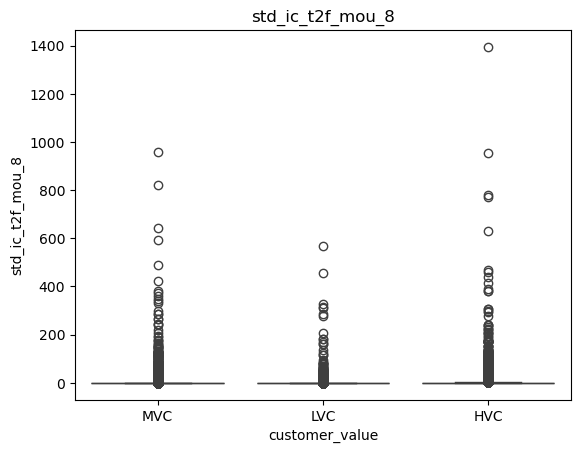

maximum value for std_ic_mou_6 is: 5712.11 
minimum value for std_ic_mou_6 is: 0.0 
median value for std_ic_mou_6 is: 5.91


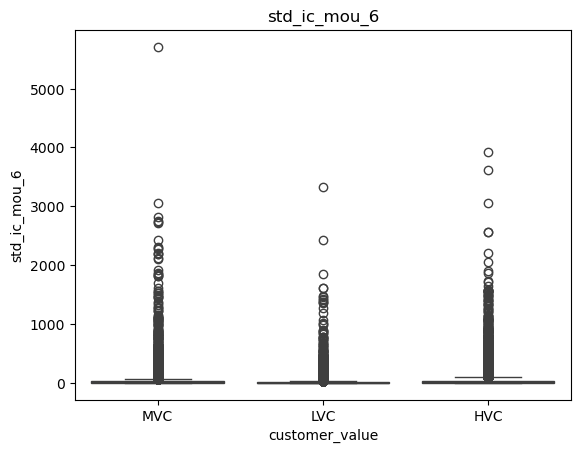

maximum value for std_ic_mou_7 is: 6745.76 
minimum value for std_ic_mou_7 is: 0.0 
median value for std_ic_mou_7 is: 5.98


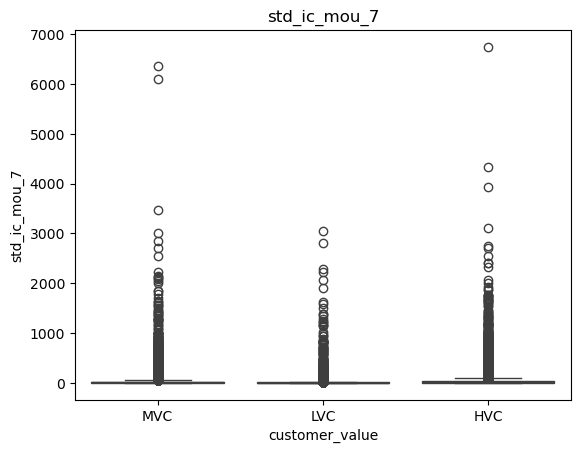

maximum value for std_ic_mou_8 is: 5658.74 
minimum value for std_ic_mou_8 is: 0.0 
median value for std_ic_mou_8 is: 5.83


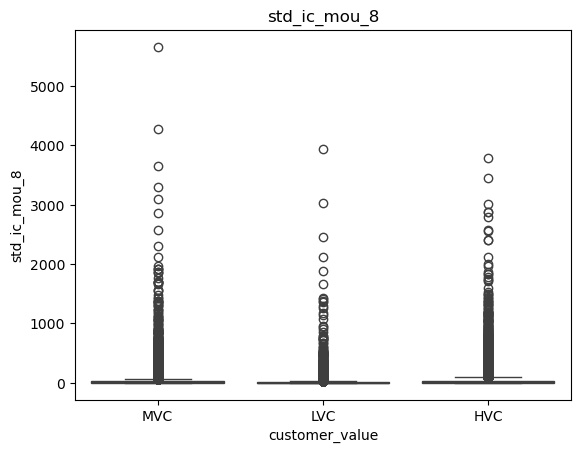

maximum value for total_ic_mou_6 is: 7716.14 
minimum value for total_ic_mou_6 is: 0.0 
median value for total_ic_mou_6 is: 114.78


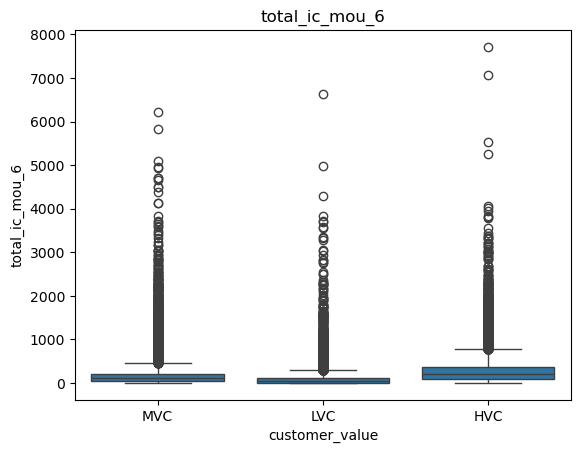

maximum value for total_ic_mou_7 is: 9699.01 
minimum value for total_ic_mou_7 is: 0.0 
median value for total_ic_mou_7 is: 116.33


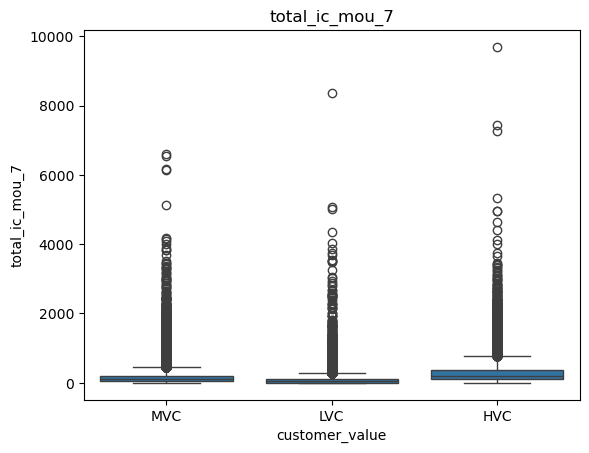

maximum value for total_ic_mou_8 is: 10830.38 
minimum value for total_ic_mou_8 is: 0.0 
median value for total_ic_mou_8 is: 114.61


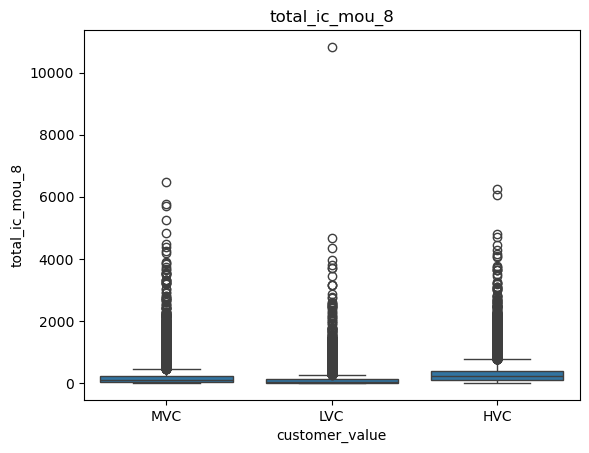

maximum value for spl_ic_mou_6 is: 19.76 
minimum value for spl_ic_mou_6 is: 0.0 
median value for spl_ic_mou_6 is: 0.0


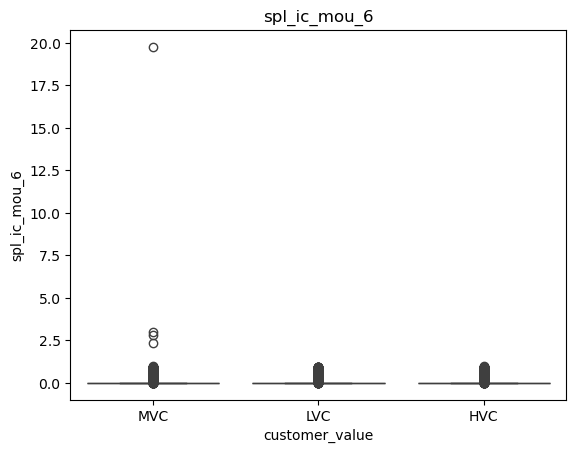

maximum value for spl_ic_mou_7 is: 13.46 
minimum value for spl_ic_mou_7 is: 0.0 
median value for spl_ic_mou_7 is: 0.0


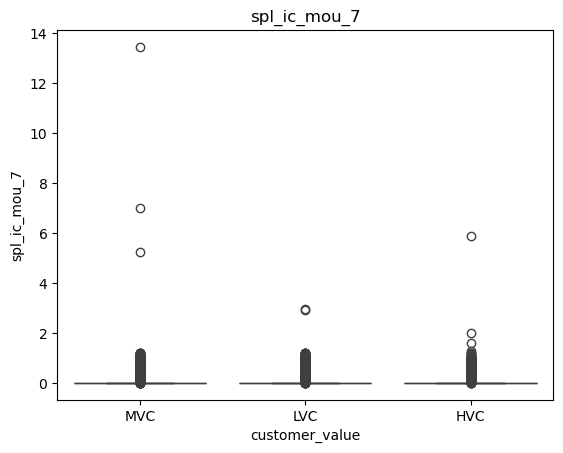

maximum value for spl_ic_mou_8 is: 16.86 
minimum value for spl_ic_mou_8 is: 0.0 
median value for spl_ic_mou_8 is: 0.0


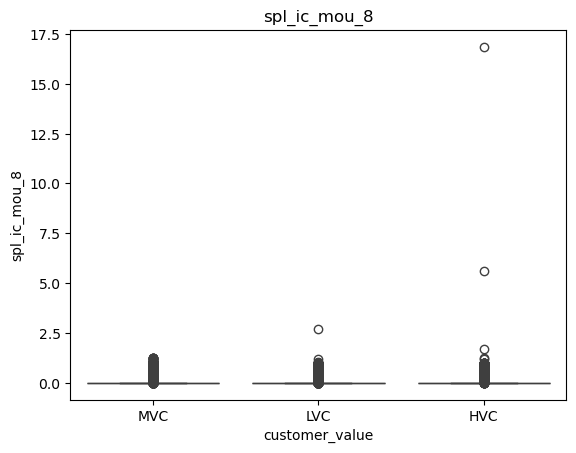

maximum value for isd_ic_mou_6 is: 6789.41 
minimum value for isd_ic_mou_6 is: 0.0 
median value for isd_ic_mou_6 is: 0.0


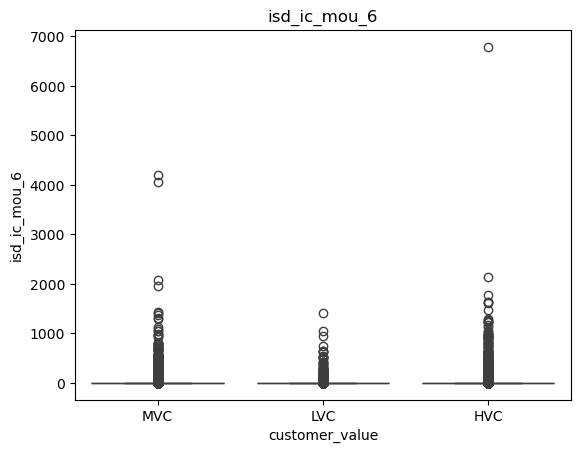

maximum value for isd_ic_mou_7 is: 5289.54 
minimum value for isd_ic_mou_7 is: 0.0 
median value for isd_ic_mou_7 is: 0.0


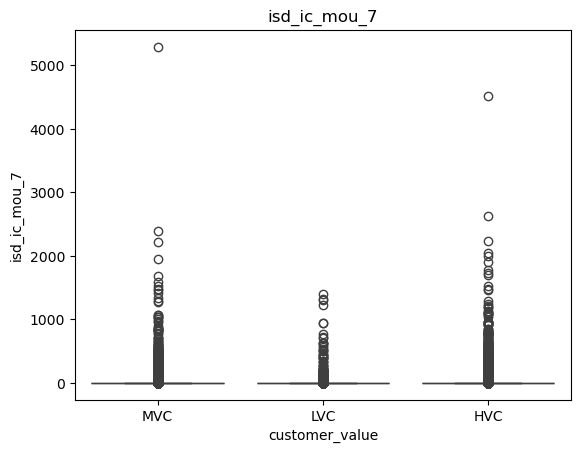

maximum value for isd_ic_mou_8 is: 4127.01 
minimum value for isd_ic_mou_8 is: 0.0 
median value for isd_ic_mou_8 is: 0.0


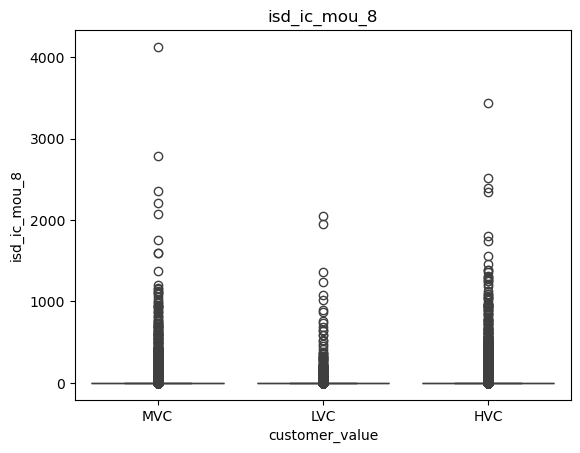

maximum value for ic_others_6 is: 1362.94 
minimum value for ic_others_6 is: 0.0 
median value for ic_others_6 is: 0.0


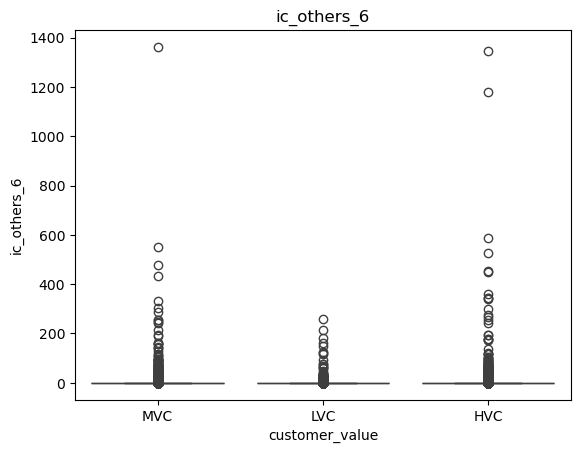

maximum value for ic_others_7 is: 1495.94 
minimum value for ic_others_7 is: 0.0 
median value for ic_others_7 is: 0.0


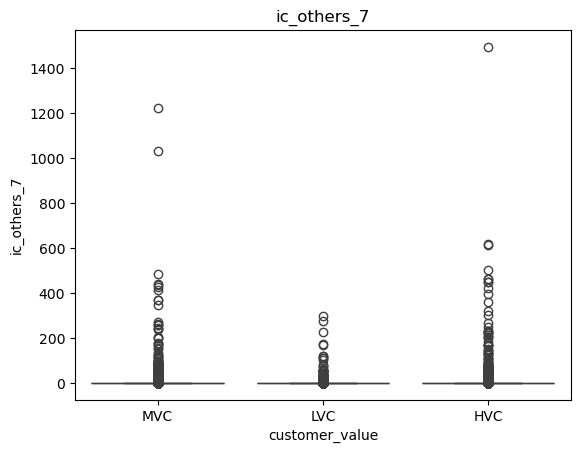

maximum value for ic_others_8 is: 1209.86 
minimum value for ic_others_8 is: 0.0 
median value for ic_others_8 is: 0.0


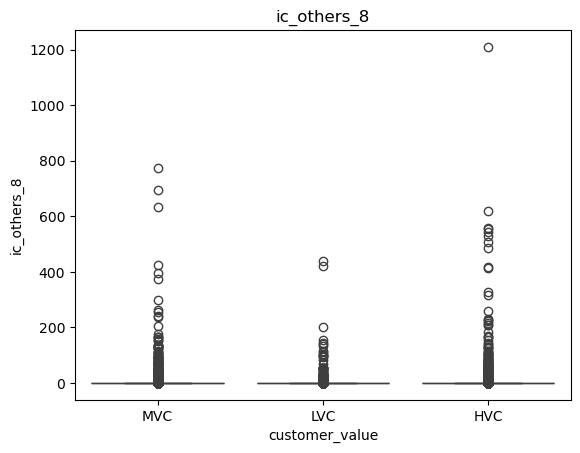

maximum value for total_rech_num_6 is: 170 
minimum value for total_rech_num_6 is: 0 
median value for total_rech_num_6 is: 6.0


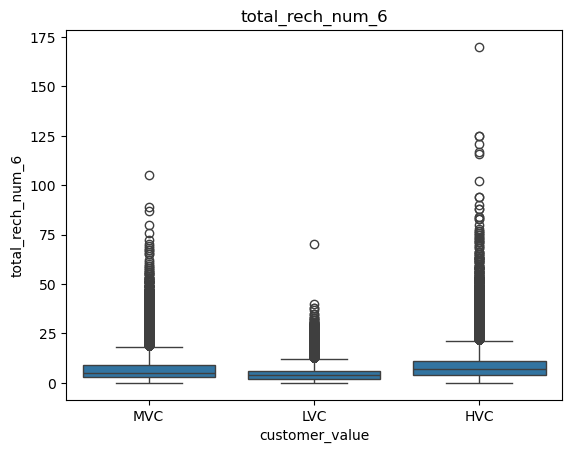

maximum value for total_rech_num_7 is: 138 
minimum value for total_rech_num_7 is: 0 
median value for total_rech_num_7 is: 6.0


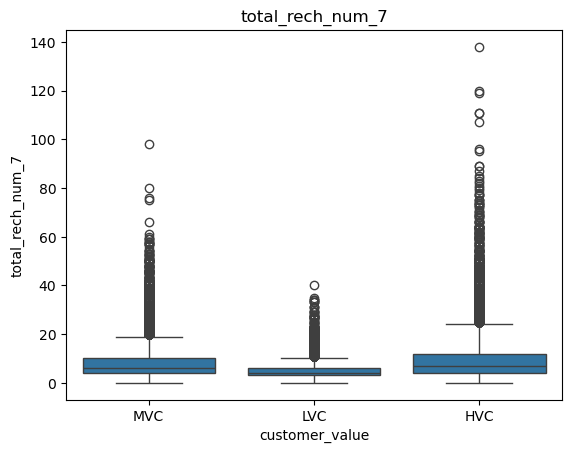

maximum value for total_rech_num_8 is: 138 
minimum value for total_rech_num_8 is: 0 
median value for total_rech_num_8 is: 5.0


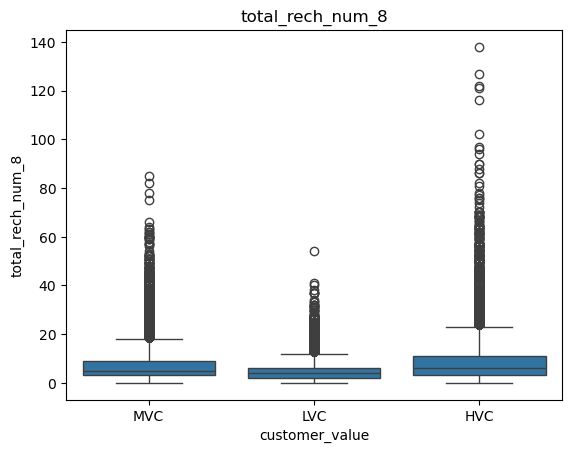

maximum value for total_rech_amt_6 is: 35190 
minimum value for total_rech_amt_6 is: 0 
median value for total_rech_amt_6 is: 229.0


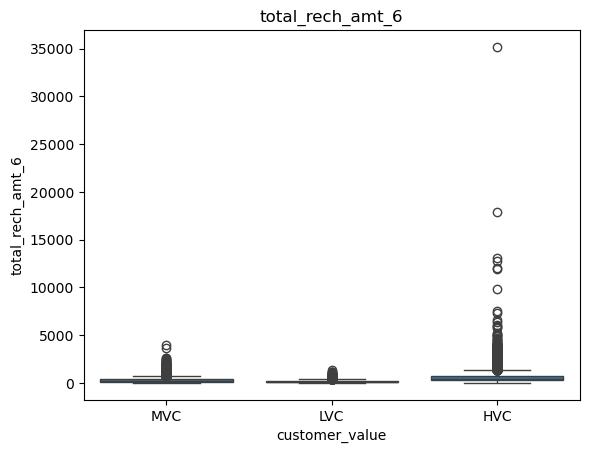

maximum value for total_rech_amt_7 is: 40335 
minimum value for total_rech_amt_7 is: 0 
median value for total_rech_amt_7 is: 220.0


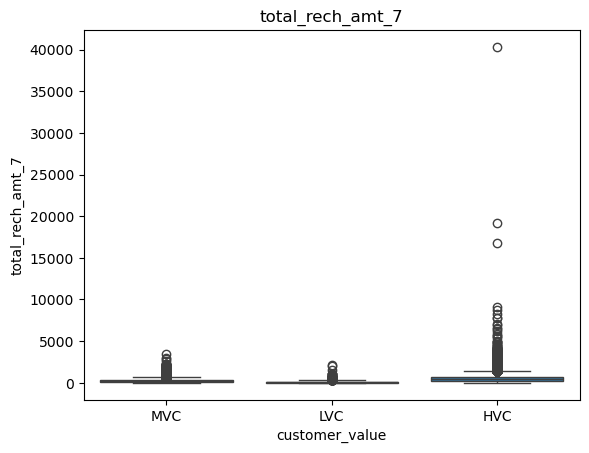

maximum value for total_rech_amt_8 is: 45320 
minimum value for total_rech_amt_8 is: 0 
median value for total_rech_amt_8 is: 225.0


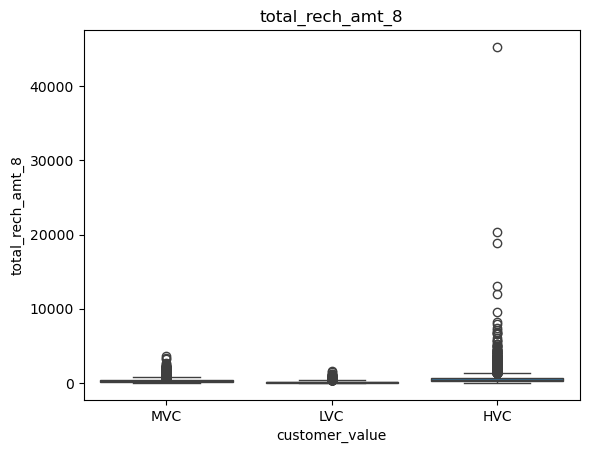

maximum value for max_rech_amt_6 is: 4010 
minimum value for max_rech_amt_6 is: 0 
median value for max_rech_amt_6 is: 110.0


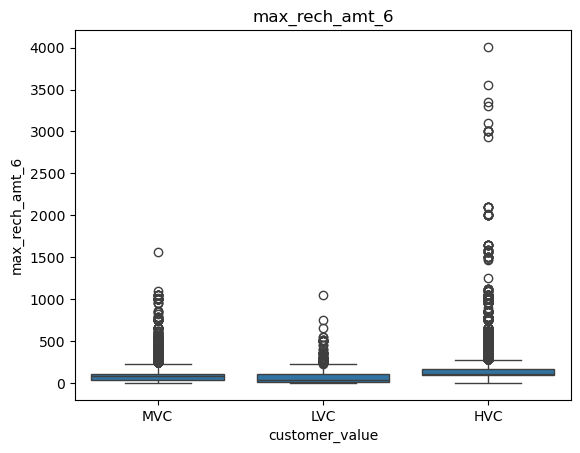

maximum value for max_rech_amt_7 is: 3299 
minimum value for max_rech_amt_7 is: 0 
median value for max_rech_amt_7 is: 110.0


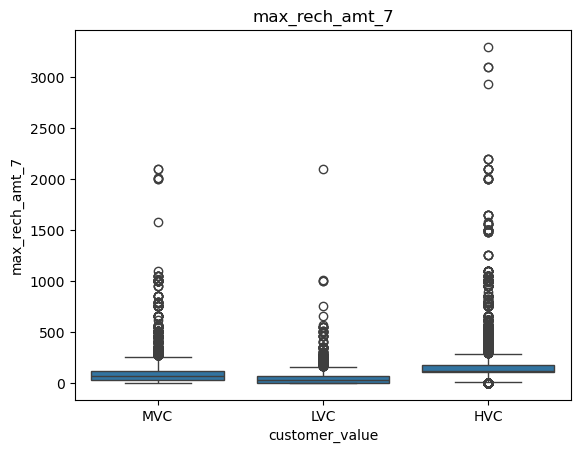

maximum value for max_rech_amt_8 is: 4449 
minimum value for max_rech_amt_8 is: 0 
median value for max_rech_amt_8 is: 98.0


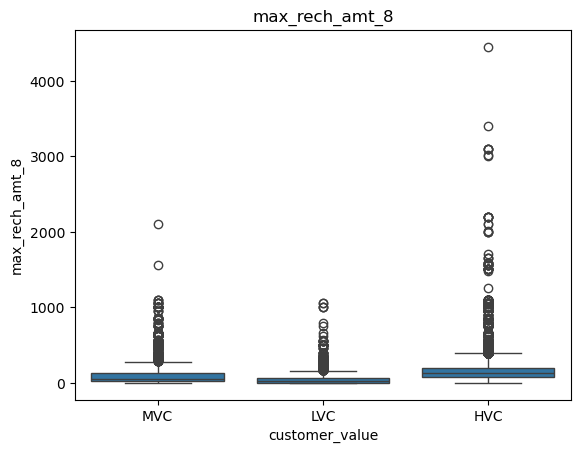

maximum value for last_day_rch_amt_6 is: 4010 
minimum value for last_day_rch_amt_6 is: 0 
median value for last_day_rch_amt_6 is: 30.0


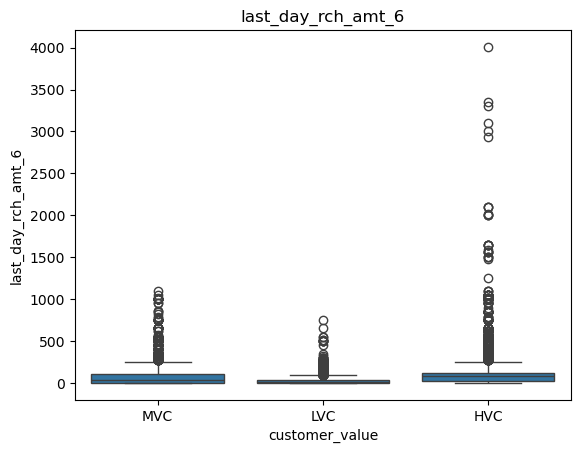

maximum value for last_day_rch_amt_7 is: 3100 
minimum value for last_day_rch_amt_7 is: 0 
median value for last_day_rch_amt_7 is: 30.0


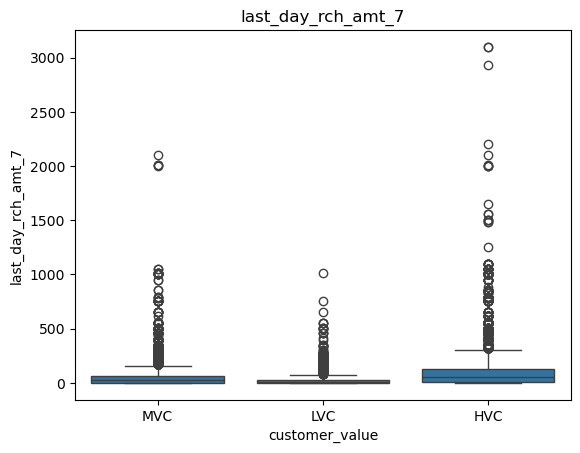

maximum value for last_day_rch_amt_8 is: 4449 
minimum value for last_day_rch_amt_8 is: 0 
median value for last_day_rch_amt_8 is: 30.0


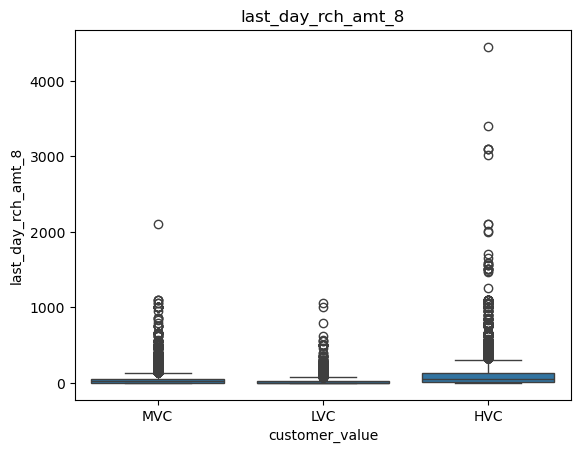

maximum value for vol_2g_mb_6 is: 10285.9 
minimum value for vol_2g_mb_6 is: 0.0 
median value for vol_2g_mb_6 is: 0.0


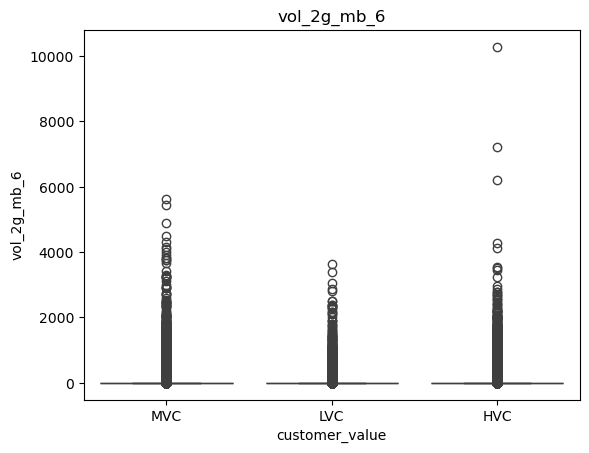

maximum value for vol_2g_mb_7 is: 7873.55 
minimum value for vol_2g_mb_7 is: 0.0 
median value for vol_2g_mb_7 is: 0.0


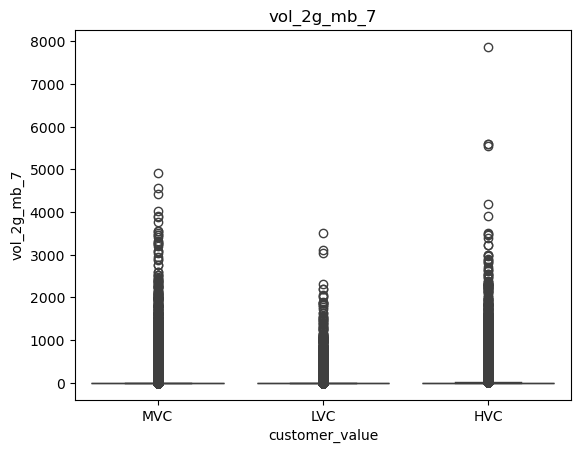

maximum value for vol_2g_mb_8 is: 11117.61 
minimum value for vol_2g_mb_8 is: 0.0 
median value for vol_2g_mb_8 is: 0.0


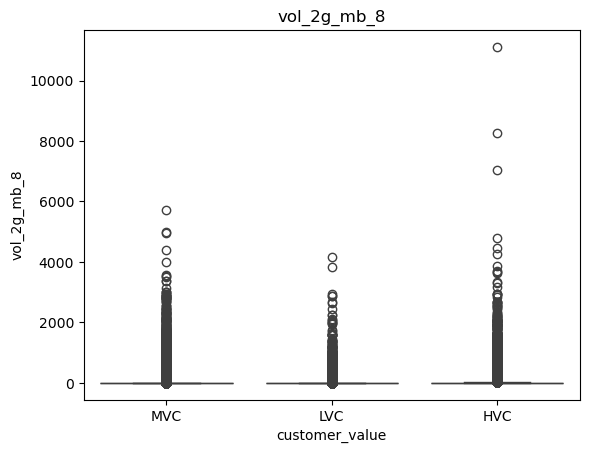

maximum value for vol_3g_mb_6 is: 45735.4 
minimum value for vol_3g_mb_6 is: 0.0 
median value for vol_3g_mb_6 is: 0.0


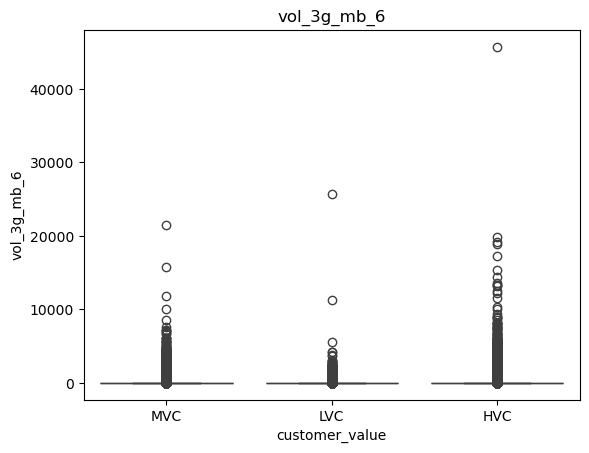

maximum value for vol_3g_mb_7 is: 28144.12 
minimum value for vol_3g_mb_7 is: 0.0 
median value for vol_3g_mb_7 is: 0.0


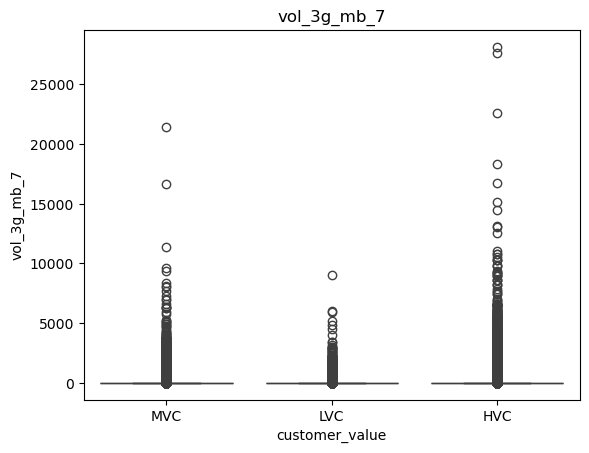

maximum value for vol_3g_mb_8 is: 30036.06 
minimum value for vol_3g_mb_8 is: 0.0 
median value for vol_3g_mb_8 is: 0.0


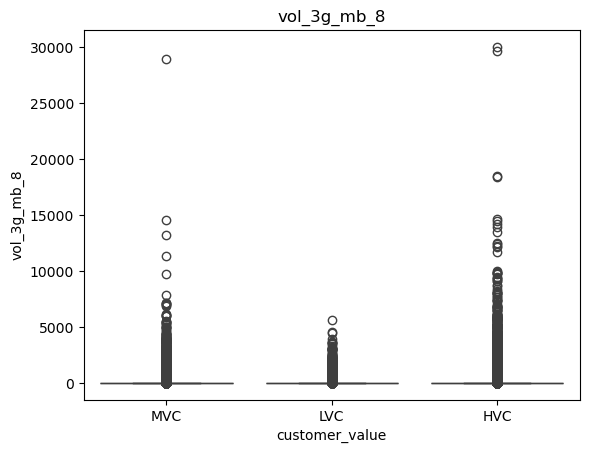

maximum value for monthly_2g_6 is: 4 
minimum value for monthly_2g_6 is: 0 
median value for monthly_2g_6 is: 0.0


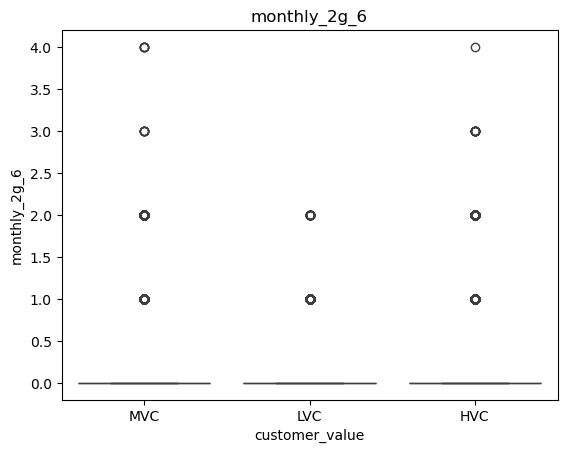

maximum value for monthly_2g_7 is: 5 
minimum value for monthly_2g_7 is: 0 
median value for monthly_2g_7 is: 0.0


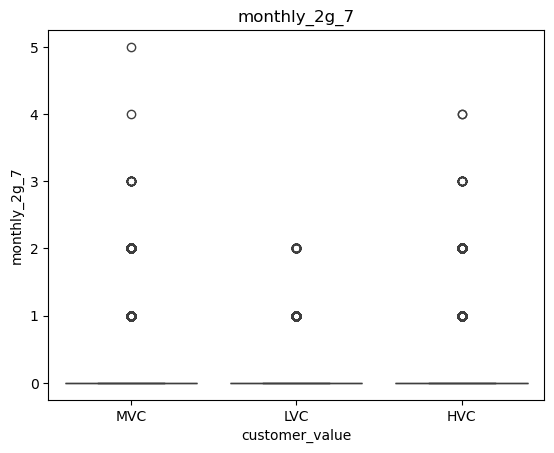

maximum value for monthly_2g_8 is: 5 
minimum value for monthly_2g_8 is: 0 
median value for monthly_2g_8 is: 0.0


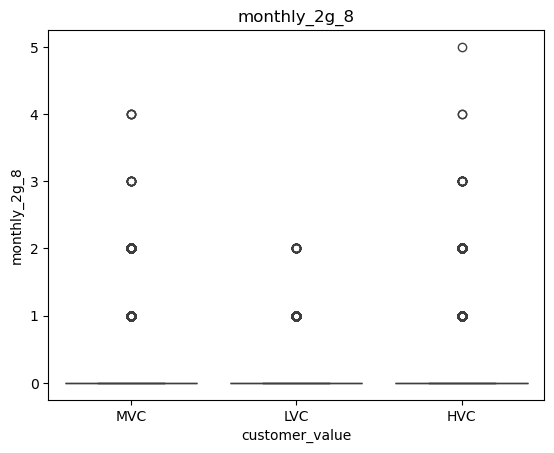

maximum value for sachet_2g_6 is: 42 
minimum value for sachet_2g_6 is: 0 
median value for sachet_2g_6 is: 0.0


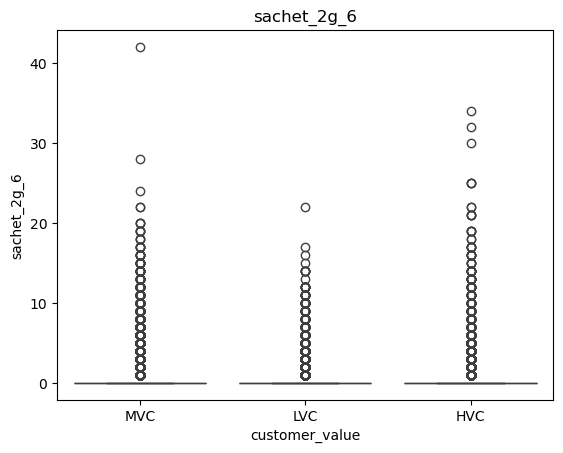

maximum value for sachet_2g_7 is: 48 
minimum value for sachet_2g_7 is: 0 
median value for sachet_2g_7 is: 0.0


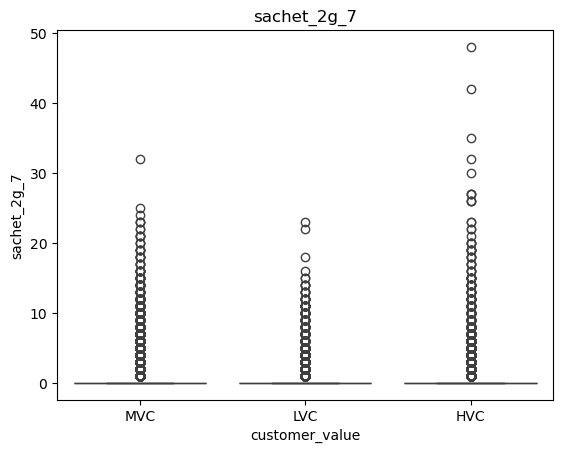

maximum value for sachet_2g_8 is: 44 
minimum value for sachet_2g_8 is: 0 
median value for sachet_2g_8 is: 0.0


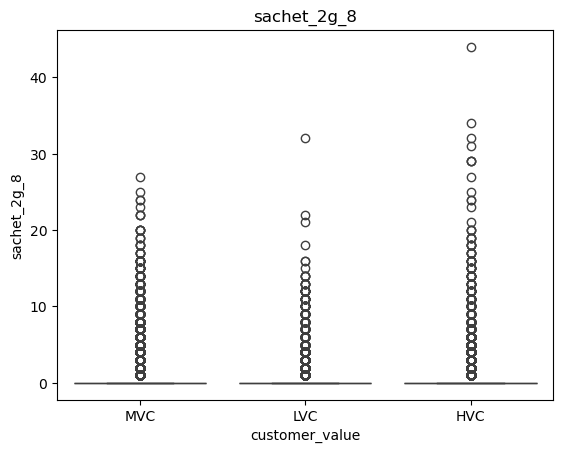

maximum value for monthly_3g_6 is: 9 
minimum value for monthly_3g_6 is: 0 
median value for monthly_3g_6 is: 0.0


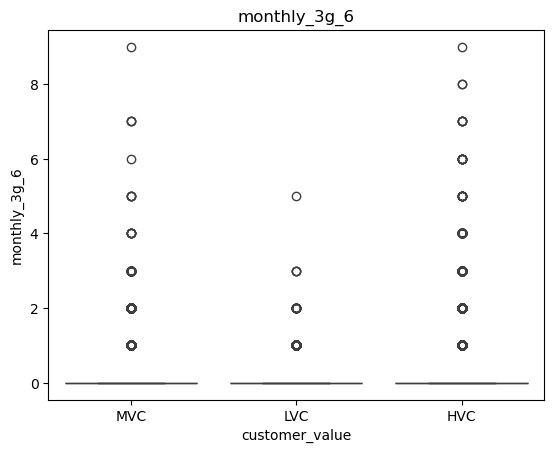

maximum value for monthly_3g_7 is: 16 
minimum value for monthly_3g_7 is: 0 
median value for monthly_3g_7 is: 0.0


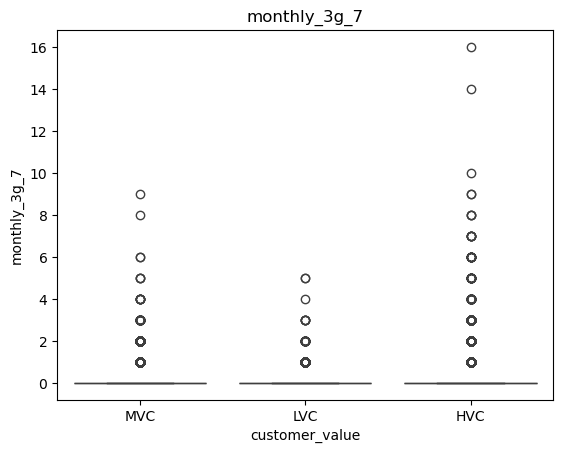

maximum value for monthly_3g_8 is: 16 
minimum value for monthly_3g_8 is: 0 
median value for monthly_3g_8 is: 0.0


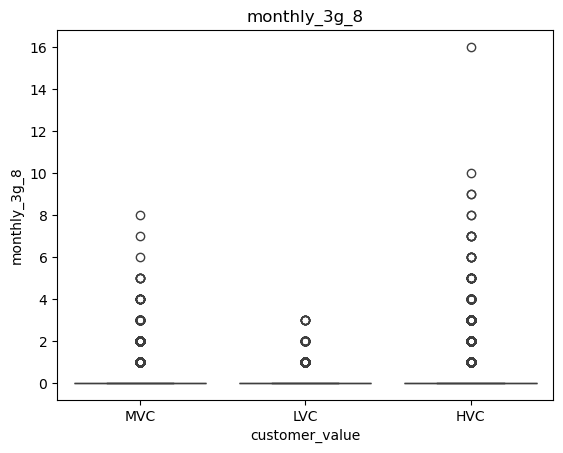

maximum value for sachet_3g_6 is: 29 
minimum value for sachet_3g_6 is: 0 
median value for sachet_3g_6 is: 0.0


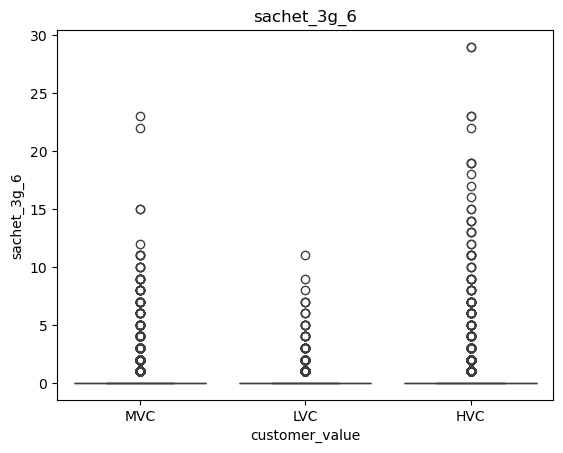

maximum value for sachet_3g_7 is: 33 
minimum value for sachet_3g_7 is: 0 
median value for sachet_3g_7 is: 0.0


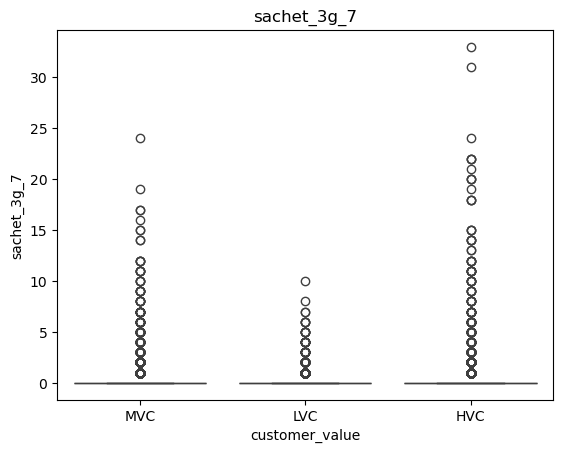

maximum value for sachet_3g_8 is: 41 
minimum value for sachet_3g_8 is: 0 
median value for sachet_3g_8 is: 0.0


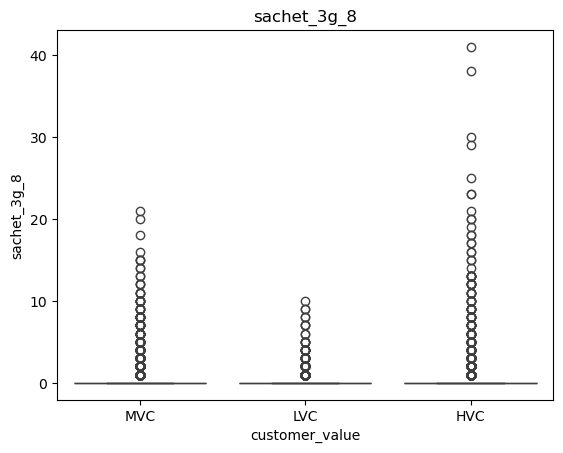

maximum value for aug_vbc_3g is: 12916.22 
minimum value for aug_vbc_3g is: 0.0 
median value for aug_vbc_3g is: 0.0


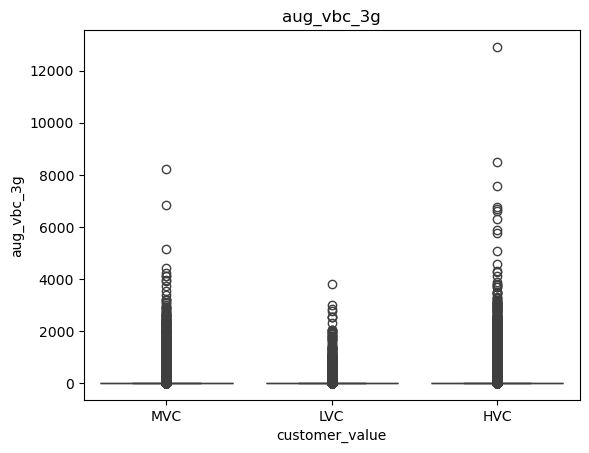

maximum value for jul_vbc_3g is: 9165.6 
minimum value for jul_vbc_3g is: 0.0 
median value for jul_vbc_3g is: 0.0


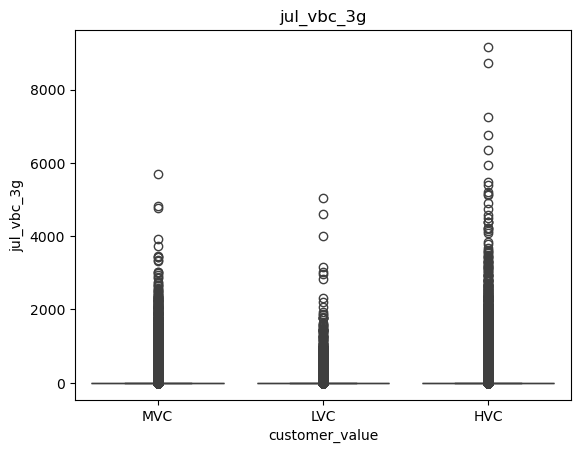

maximum value for jun_vbc_3g is: 11166.21 
minimum value for jun_vbc_3g is: 0.0 
median value for jun_vbc_3g is: 0.0


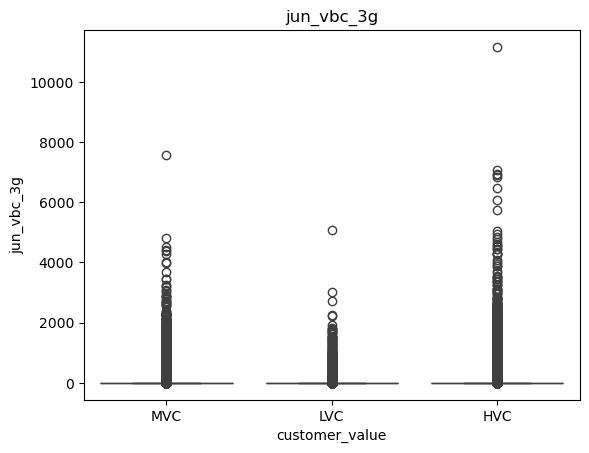

maximum value for churn_probability is: 1 
minimum value for churn_probability is: 0 
median value for churn_probability is: 0.0


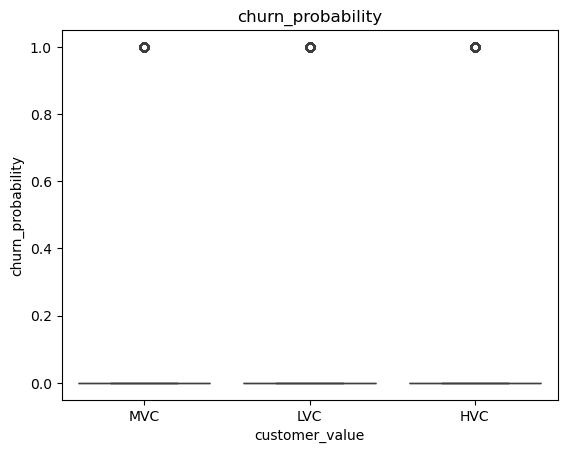

maximum value for avg_customer_Spend is: 961875.7386 
minimum value for avg_customer_Spend is: 97.5557 
median value for avg_customer_Spend is: 5699.3265


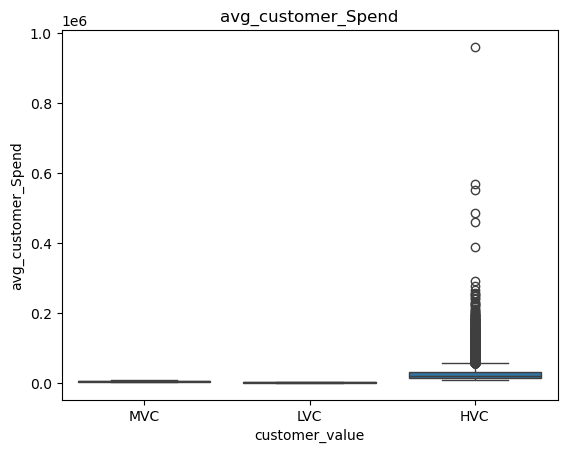

In [50]:
for col in data_v1.columns: 
    if is_numeric_dtype(data_v1[col]):
        plt.title(col)
        sns.boxplot(x = data_v1['customer_value'],y=data_v1[col], data = data_v1)
        print ("maximum value for",col, "is:",data_v1[col].max(),
               "\nminimum value for",col, "is:", data_v1[col].min(),
              "\nmedian value for",col, "is:", data_v1[col].quantile(0.50))
        plt.show()

## <font color= Red> Observations

1. Almost all columns contain outliers.  
2. Outliers will not be removed from all columns. For example, columns such as **SACHET**, **monthly_3g**, and **spl** have minimal differences between their maximum and median values.  
3. Certain columns, such as **std recharge** and **roaming**, are excluded from outlier analysis because they contribute to revenue, and dissatisfaction in these areas could lead to increased churn.  
4. Therefore, outliers are removed only from columns with a significant difference between the mean and median, particularly in cases involving total minutes of usage, including both on-net and off-net usage.  
5. Values above the 99th percentile (assumed) are treated as outliers.

In [52]:
outlier_cols=['total_ic_mou_6','total_og_mou_6','onnet_mou_6','offnet_mou_6','total_rech_amt_6','total_ic_mou_7','total_og_mou_7','onnet_mou_7','offnet_mou_7','total_rech_amt_7','total_ic_mou_8','total_og_mou_8','onnet_mou_8','offnet_mou_8','total_rech_amt_8',]


In [53]:
data_v1[outlier_cols].describe(percentiles=[0,0.25,0.5,0.75,0.99])

,total_ic_mou_6,total_og_mou_6,onnet_mou_6,offnet_mou_6,total_rech_amt_6,total_ic_mou_7,total_og_mou_7,onnet_mou_7,offnet_mou_7,total_rech_amt_7,total_ic_mou_8,total_og_mou_8,onnet_mou_8,offnet_mou_8,total_rech_amt_8
count,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000
mean,199.710640,306.451436,129.236765,194.825731,328.139788,201.878029,310.572674,129.993840,193.112523,322.376363,198.486034,304.513065,127.641721,191.002562,323.846355
std,290.114823,465.502866,294.605405,311.131642,404.211068,296.771338,479.131770,305.867956,316.878225,411.070120,288.336731,477.936832,304.373330,316.270571,426.181405
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
0%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,38.640000,44.780000,8.060000,36.880000,110.000000,41.340000,42.910000,7.260000,33.980000,100.000000,38.290000,38.710000,7.360000,34.390000,90.000000
50%,114.780000,145.280000,34.110000,96.480000,229.000000,116.330000,141.230000,32.280000,91.885000,220.000000,114.610000,138.360000,32.100000,91.800000,225.000000
75%,251.070000,374.305000,113.100000,223.540000,438.000000,249.470000,380.045000,108.940000,218.350000,430.000000,249.710000,370.895000,106.280000,216.410000,436.000000
99%,1366.030000,2235.611000,1429.040400,1520.310000,1683.020000,1382.071400,2275.607000,1461.342200,1517.838600,1712.000000,1353.297000,2242.854800,1448.891000,1492.232400,1706.020000
max,7716.140000,10674.030000,7376.710000,8362.360000,35190.000000,9699.010000,8285.640000,8157.780000,7043.980000,40335.000000,10830.380000,14043.060000,10752.560000,14007.340000,45320.000000


In [54]:
data_v2 = data_v1.copy()
for col in outlier_cols:
    if is_numeric_dtype(data_v2[col]):
        if data_v2[col].max() / data_v2[col].quantile(0.99) > 6:
            data_v2 = data_v2[data_v2[col] < data_v2[col].quantile(0.99)]


In [55]:
data_v2.shape

(67919, 123)

## <font color= Red> Observations
1.Among the identified outliers, only cases with extremely high deviations are removed, specifically when the ratio between the maximum value and the 99th percentile exceeds six times.

In [57]:
# few key columns were identified and outliers seen in those columns were eliminated resulting trimming dataset by ~3% which is accecptable
round(((69999-data_v2.shape[0])/69999)*100,2)

2.97

In [58]:
data_v2.describe()

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability,avg_customer_Spend
count,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.00000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000,67919.000000
mean,115.851980,114.126795,109.212212,178.387921,174.833208,171.220854,8.622300,6.388211,6.240665,11.837484,8.508075,8.339939,41.184354,39.866901,38.513941,85.955711,83.617959,83.414758,3.432677,3.474503,3.331000,1.052557,1.270594,1.309621,131.071941,127.424152,125.880284,69.044007,70.003511,66.317961,75.360361,76.346320,72.364057,1.043755,1.001456,0.972521,145.762095,147.649717,140.043854,0.402907,0.426989,0.464491,3.650412,4.568689,4.544742,0.434533,0.023748,0.029019,278.238186,277.172218,266.993813,41.246233,39.463432,39.778550,98.863953,96.712937,99.210724,11.063751,11.362883,10.588551,151.959805,148.2861

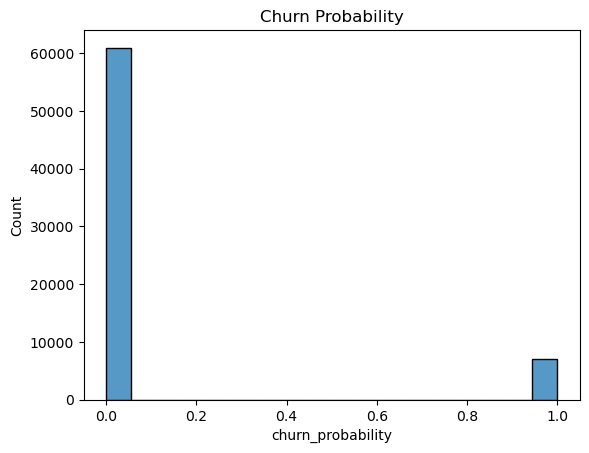

churn_probability
0    60944
1     6975
Name: count, dtype: int64

In [59]:
sns.histplot(data_v2['churn_probability'])
plt.title("Churn Probability")
plt.show()
data_v2['churn_probability'].value_counts()

#### A big class imbalance is seen between churn (12%) and active cases (88%). 

In [61]:
# of churn in the filtered dataset

round((data_v2['churn_probability'].value_counts()[1]/data_v2['churn_probability'].value_counts()[0])*100,2)

11.44

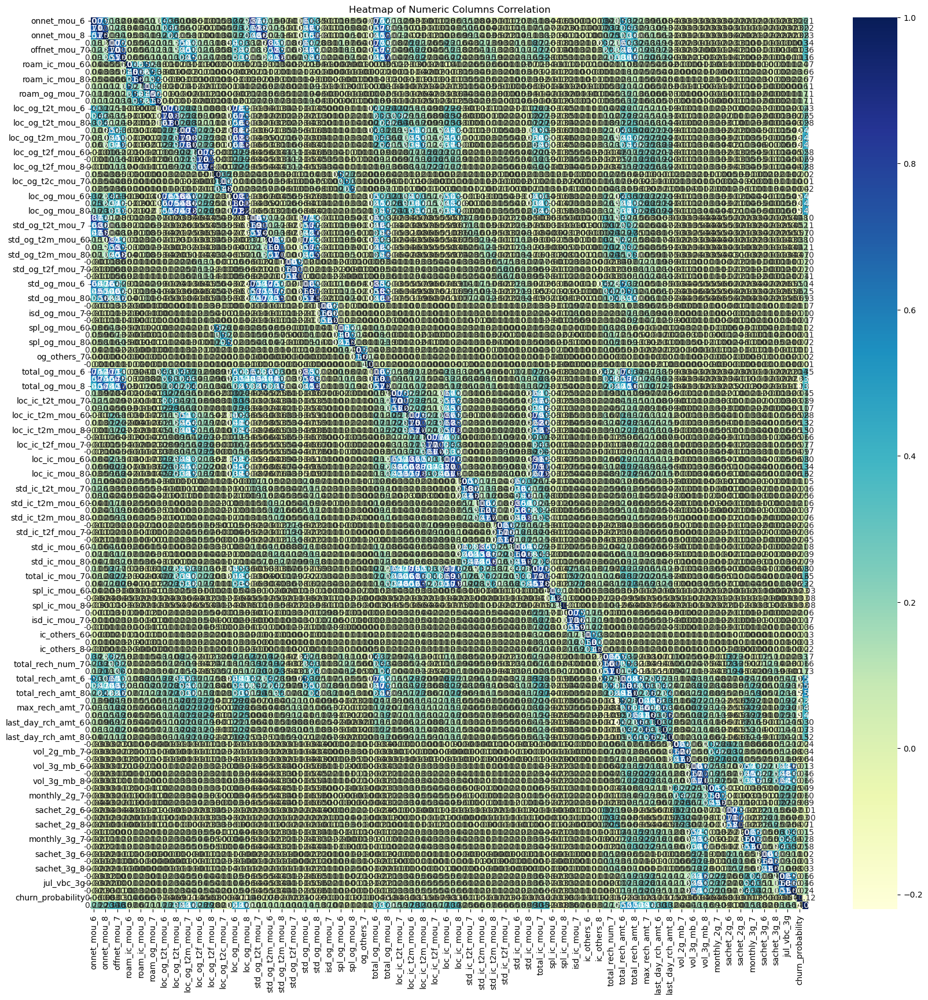

In [62]:
# correlation plot of whole dataset

numeric_data = data_v2.select_dtypes(include=['number'])

# Create the heatmap
plt.figure(figsize=(20, 20)) 
sns.heatmap(numeric_data.corr(), cmap="YlGnBu", annot=True, fmt=".2f") 
plt.title("Heatmap of Numeric Columns Correlation")
plt.show()

In [63]:
June_month =[]
July_month = []
August_month = []
others=[]
for i in data_v2.columns:
    if '6' in i or 'jun' in i.lower():
        June_month.append(i)
    elif '7' in i or 'jul' in i.lower():
        July_month.append(i)
    elif '8' in i or 'aug' in i.lower():
        August_month.append(i)
    else:
        others.append(i)

print(June_month, len(June_month))
print(July_month, len(July_month))
print(August_month, len(August_month))
print(others)

['onnet_mou_6', 'offnet_mou_6', 'roam_ic_mou_6', 'roam_og_mou_6', 'loc_og_t2t_mou_6', 'loc_og_t2m_mou_6', 'loc_og_t2f_mou_6', 'loc_og_t2c_mou_6', 'loc_og_mou_6', 'std_og_t2t_mou_6', 'std_og_t2m_mou_6', 'std_og_t2f_mou_6', 'std_og_mou_6', 'isd_og_mou_6', 'spl_og_mou_6', 'og_others_6', 'total_og_mou_6', 'loc_ic_t2t_mou_6', 'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_6', 'loc_ic_mou_6', 'std_ic_t2t_mou_6', 'std_ic_t2m_mou_6', 'std_ic_t2f_mou_6', 'std_ic_mou_6', 'total_ic_mou_6', 'spl_ic_mou_6', 'isd_ic_mou_6', 'ic_others_6', 'total_rech_num_6', 'total_rech_amt_6', 'max_rech_amt_6', 'last_day_rch_amt_6', 'vol_2g_mb_6', 'vol_3g_mb_6', 'monthly_2g_6', 'sachet_2g_6', 'monthly_3g_6', 'sachet_3g_6', 'jun_vbc_3g'] 40
['onnet_mou_7', 'offnet_mou_7', 'roam_ic_mou_7', 'roam_og_mou_7', 'loc_og_t2t_mou_7', 'loc_og_t2m_mou_7', 'loc_og_t2f_mou_7', 'loc_og_t2c_mou_7', 'loc_og_mou_7', 'std_og_t2t_mou_7', 'std_og_t2m_mou_7', 'std_og_t2f_mou_7', 'std_og_mou_7', 'isd_og_mou_7', 'spl_og_mou_7', 'og_others_7', 'total

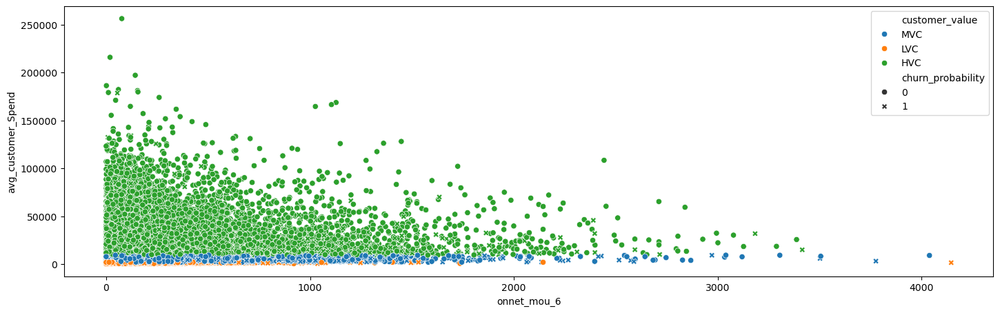

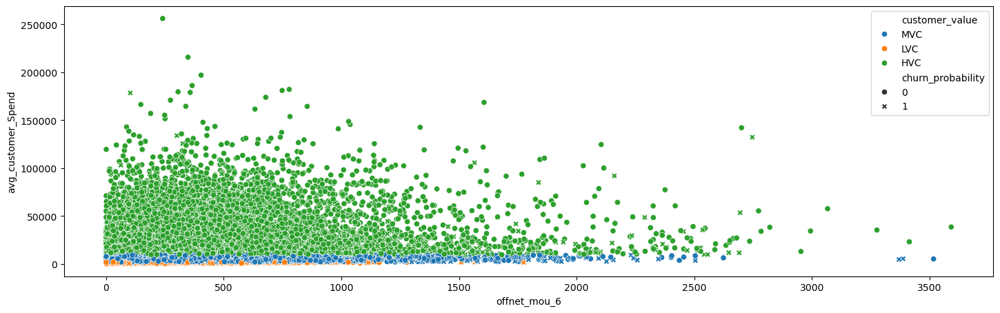

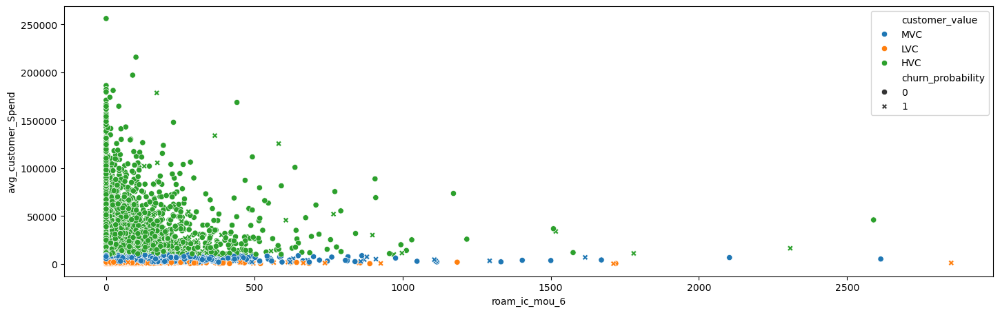

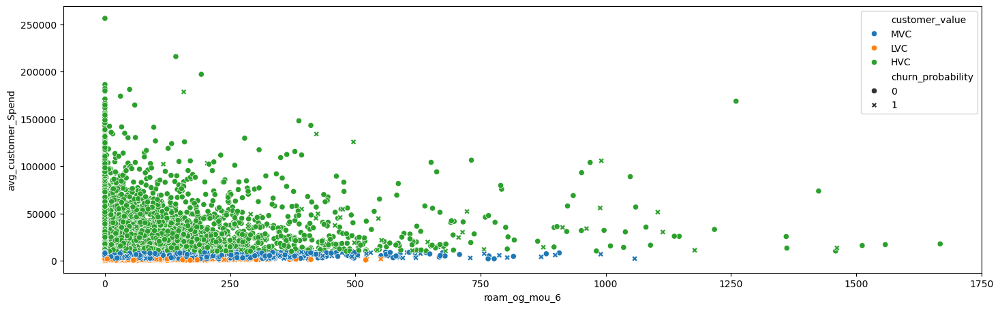

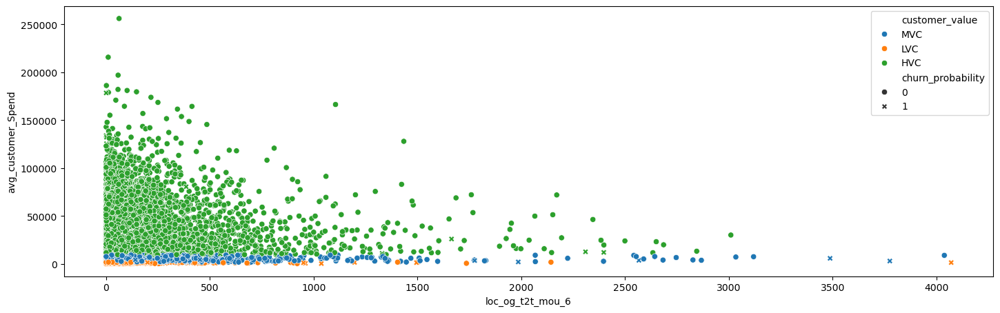

...

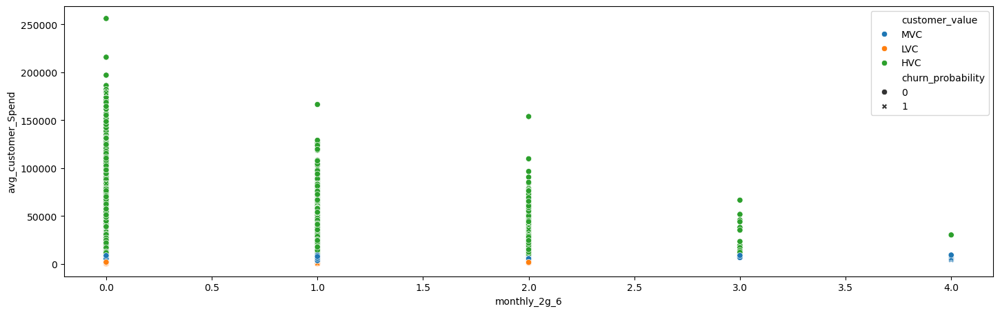

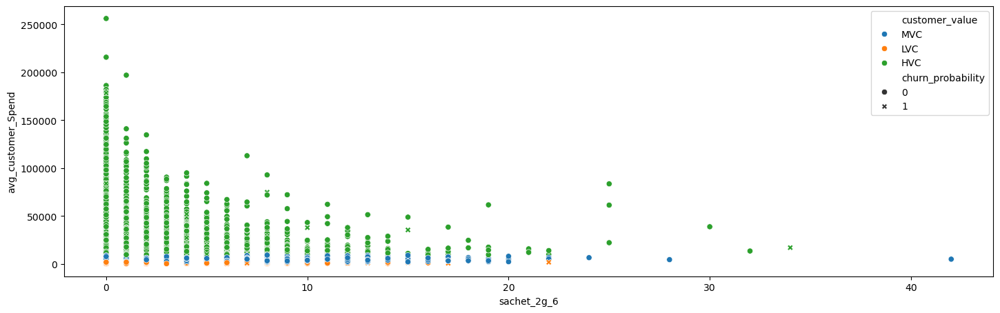

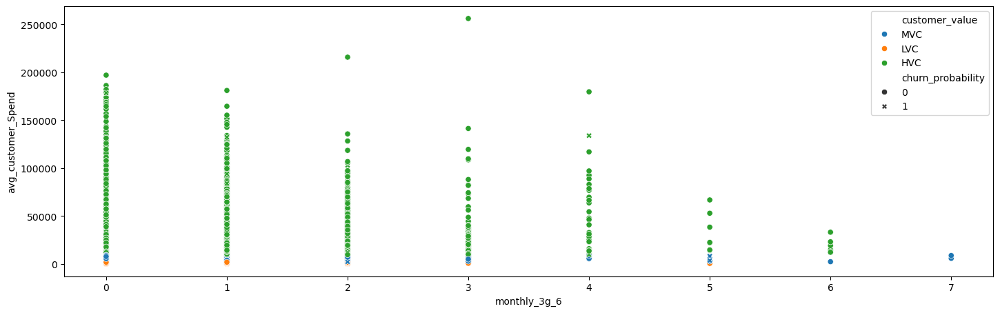

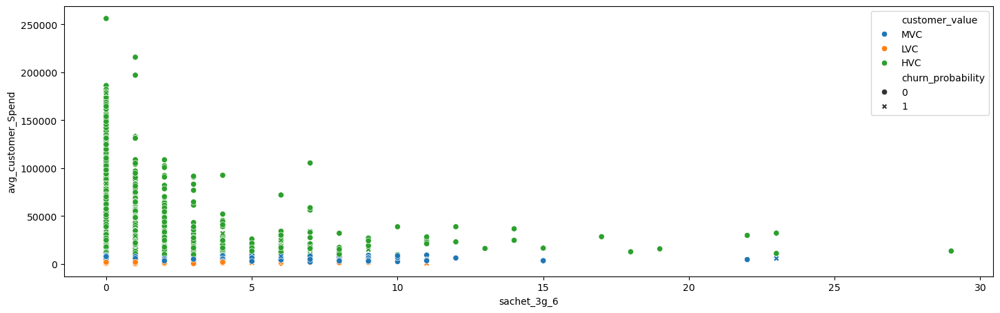

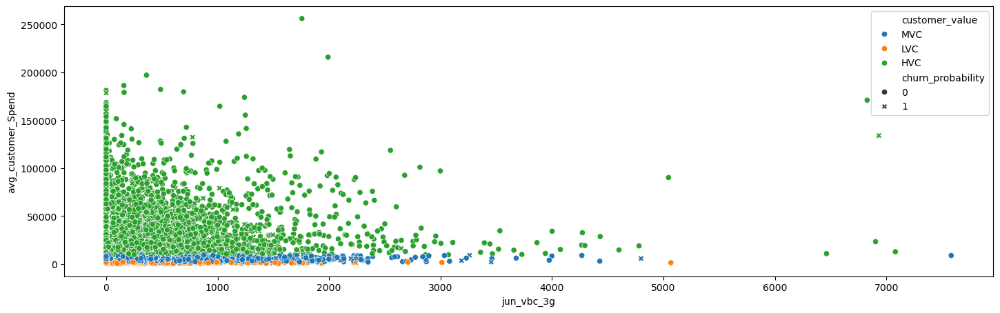

In [64]:
for i in range(len(June_month)):
    plt.figure(figsize=(80, 60))
    plt.subplot(10,4,i+1)
    sns.scatterplot(x = data_v2[June_month[i]], y = 'avg_customer_Spend', data = data_v2, hue='customer_value',style='churn_probability',sizes='churn_probability')
    plt.show()

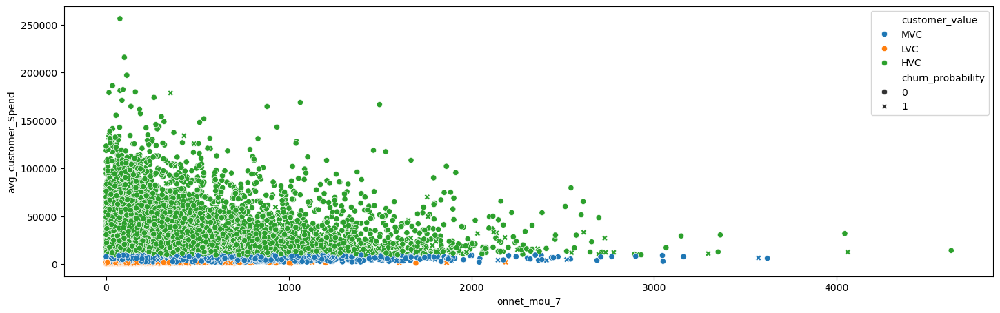

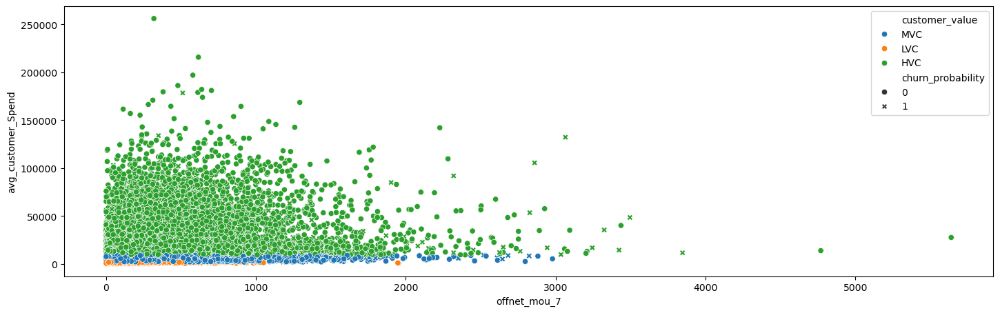

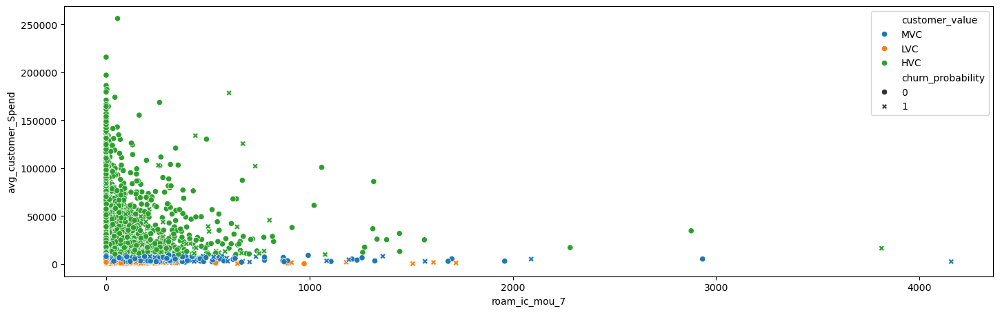

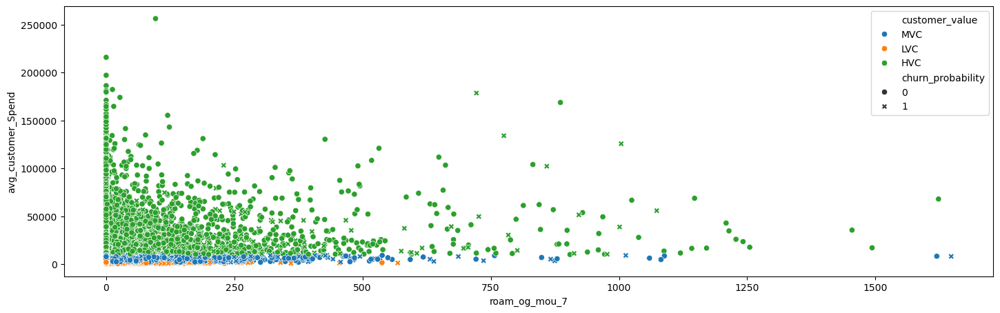

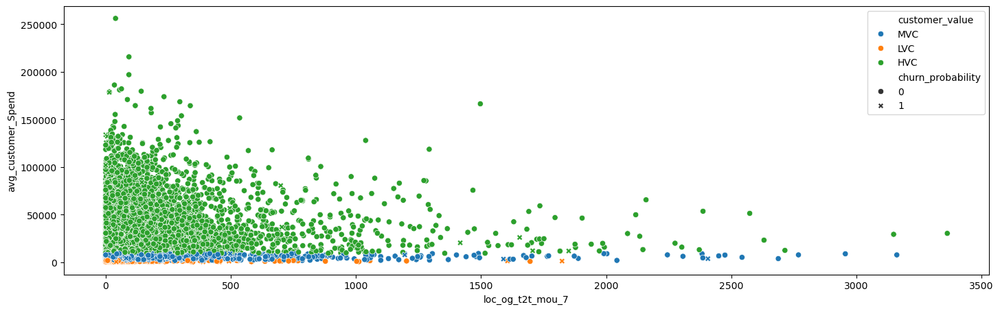

...

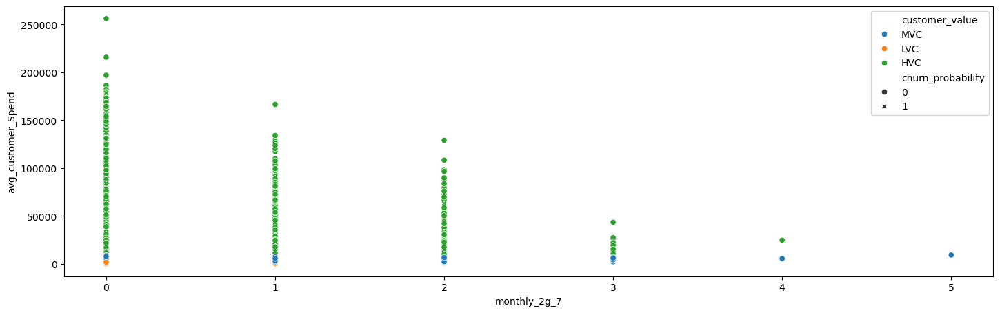

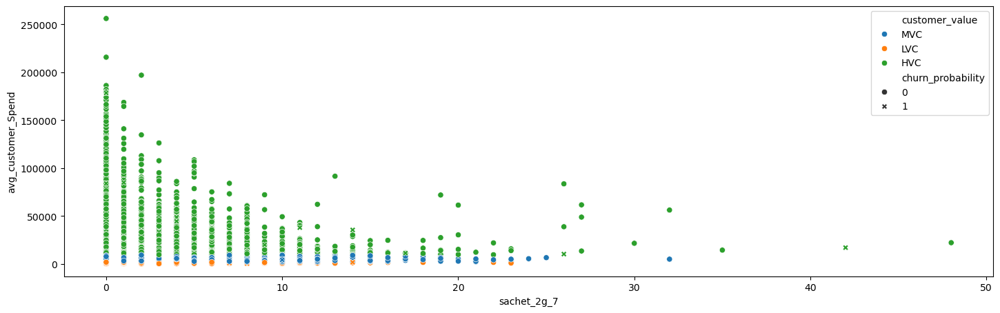

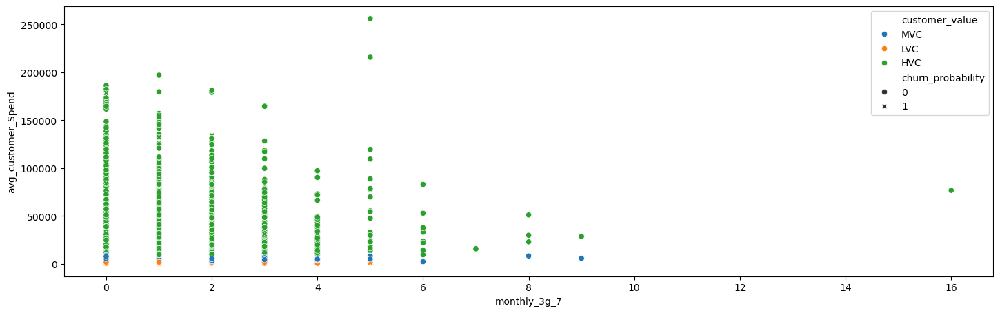

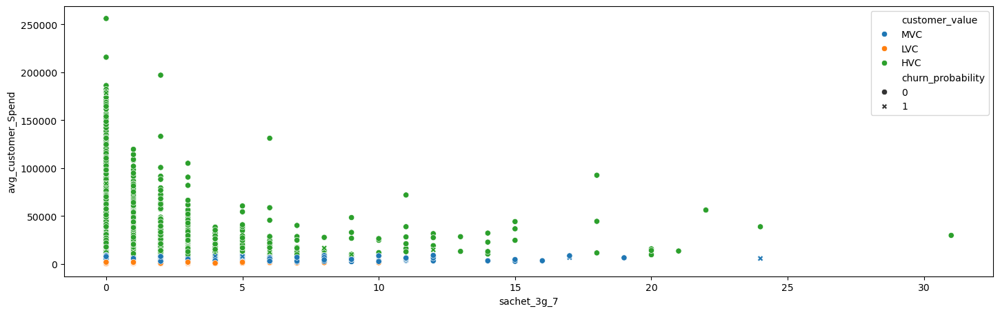

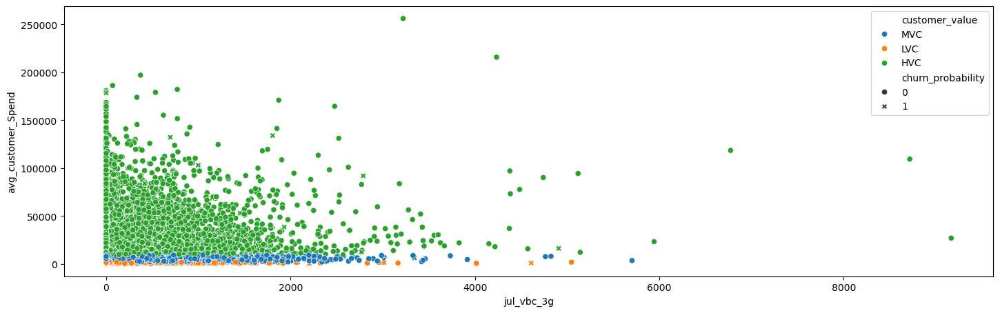

In [65]:
for i in range(len(July_month)):
    plt.figure(figsize=(80, 60))
    plt.subplot(10,4,i+1)
    sns.scatterplot(x = data_v2[July_month[i]], y = 'avg_customer_Spend', data = data_v2, hue='customer_value',style='churn_probability',sizes='churn_probability')
    plt.show()

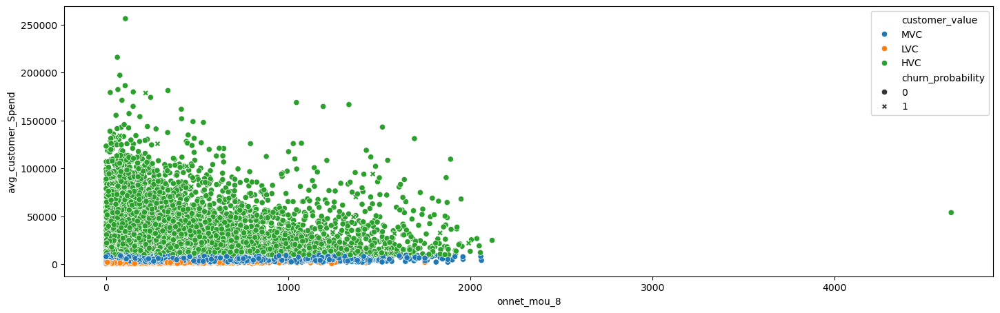

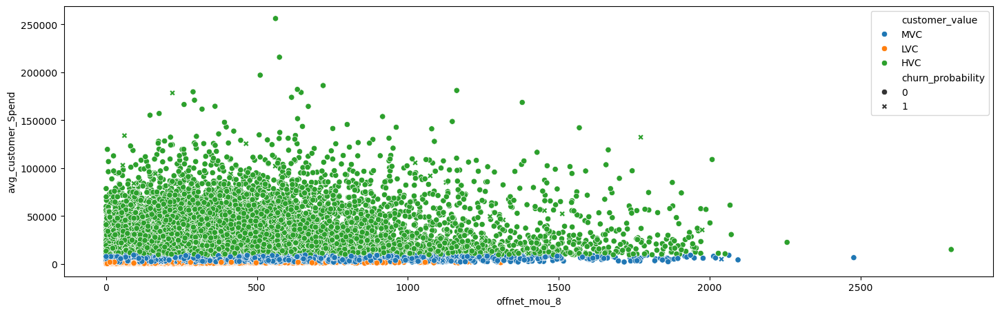

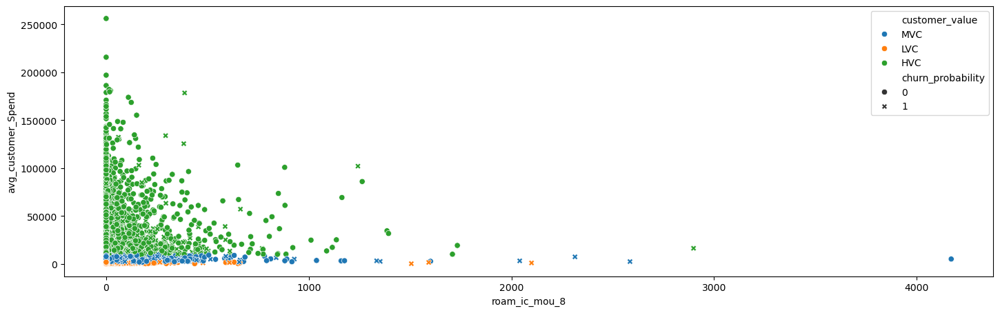

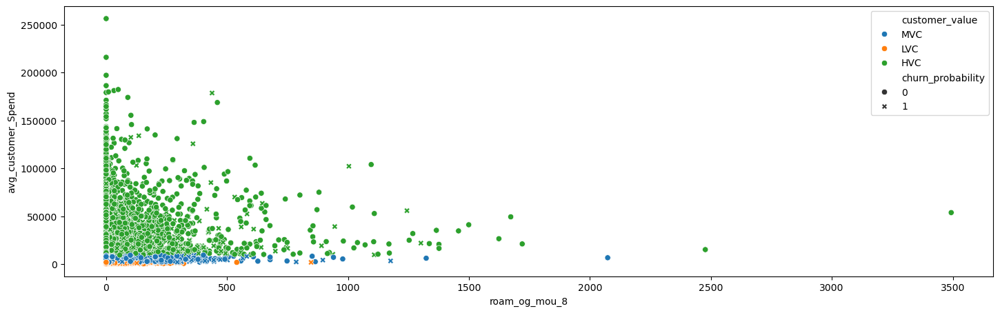

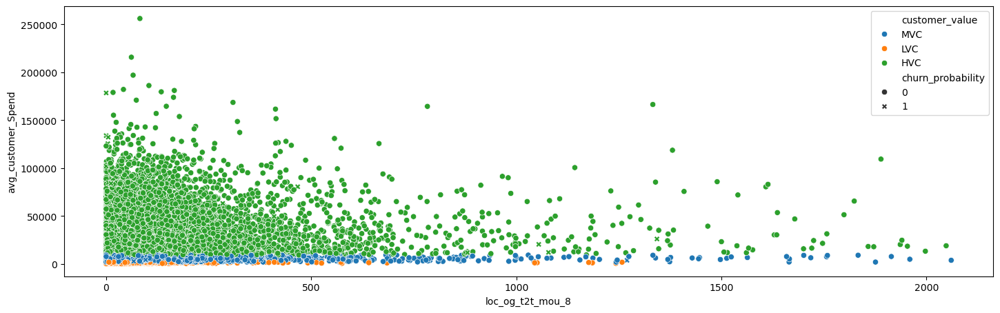

...

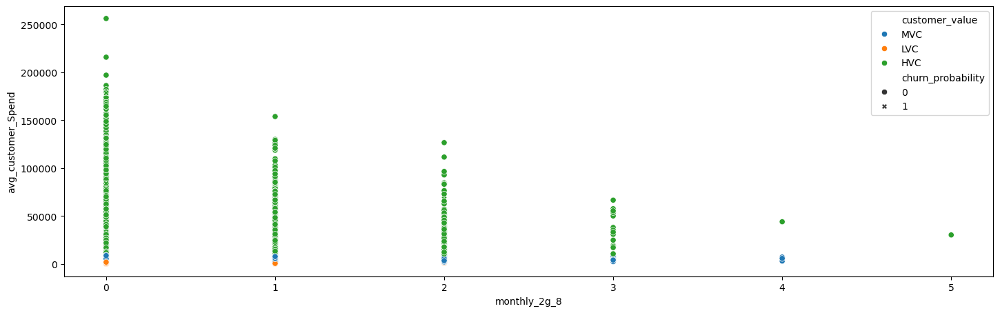

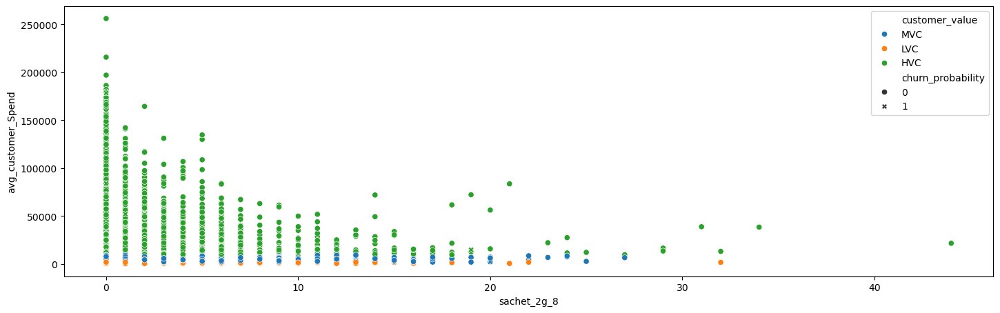

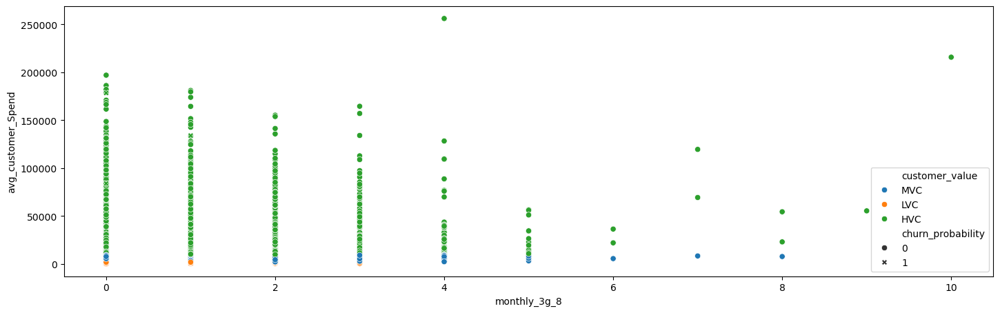

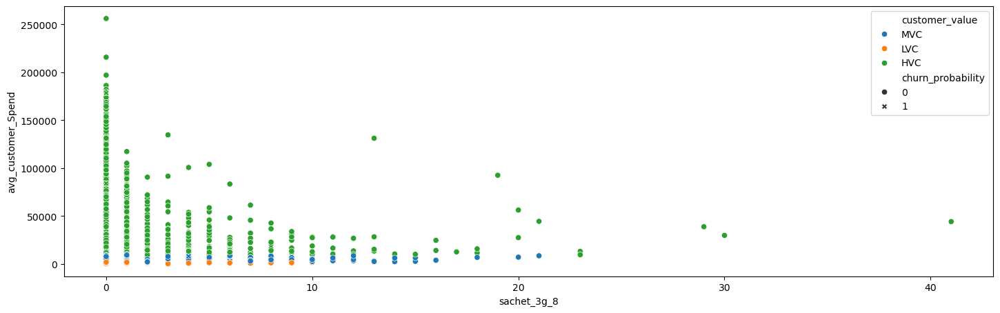

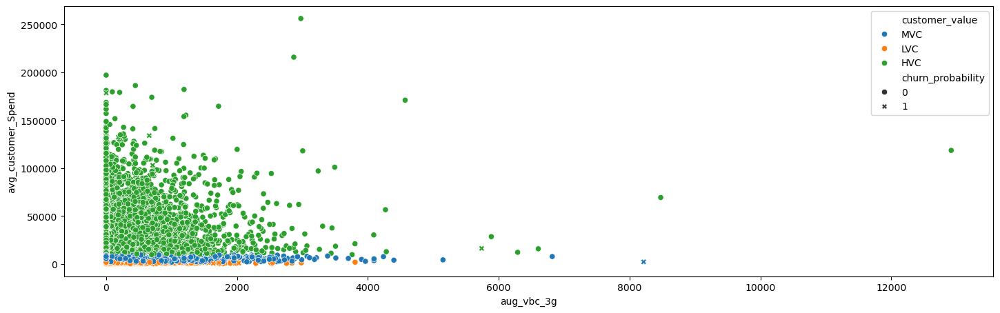

In [66]:
for i in range(len(August_month)):
    plt.figure(figsize=(80, 60))
    plt.subplot(10,4,i+1)
    sns.scatterplot(x = data_v2[August_month[i]], y = 'avg_customer_Spend', data = data_v2, hue='customer_value',style='churn_probability',sizes='churn_probability')
    plt.show()

#### Visually more churns ca be seen in high value customers in std_outgoing calls followed by roaming

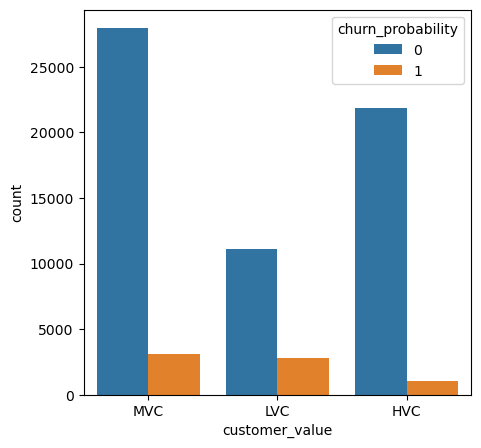

In [68]:
plt.figure(figsize=(5,5))
sns.countplot(x="customer_value",hue="churn_probability", data=data_v2)
plt.show()

##  <font color= Green> Key insights from EDA -

 - Most customers who are highvalue as per our analysis have a lower churn rate.
 - Targeting the middle MVC and HVC is beneficial to the company
 - Mostly the churn probabilty is negetively correlated with most variables which means predictor variables donot show a clear pattern with the target variable
 - There is a big class imbalance between the most of 88% of the data is active users
 - only few variables(like std_og, roam etc) gives a clear identification how it is related to revenue and churn
 - In this dataset June sees highest churn

In [70]:
data_v2['customer_value'] = data_v2['customer_value'].apply(lambda x:2 if x=='HVC' else (0 if x=='LVC' else 1))

## 3. Create X, y and then Train test split

In [72]:
X=data_v2.drop("churn_probability",axis=1)

y=data_v2.churn_probability
X.shape

(67919, 122)

In [73]:
y.shape

(67919,)

In [74]:
X_train, X_test, y_train, y_test= train_test_split(X, y, train_size = 0.7, test_size = 0.3, random_state = 42,\
                                                   stratify=data_v2.churn_probability.values)
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(47543, 122)
(47543,)
(20376, 122)
(20376,)


In [75]:
X_train.head()

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,avg_customer_Spend,customer_value
51523,435.23,94.11,96.33,124.39,40.290,47.26,0.0,0.0,0.0,0.0,0.0,0.0,435.23,94.11,96.33,121.01,40.29,39.53,0.00,0.00,0.00,0.00,0.0,0.0,556.24,134.41,135.86,0.0,0.0,0.0,3.38,0.00,7.73,0.0,0.0,0.0,3.38,0.00,7.730,0.0,0.0,0.0,5.28,7.09,6.11,11.93,0.0,0.0,576.84,141.51,149.71,164.11,204.14,69.94,97.46,175.08,121.58,0.00,0.00,0.00,261.58,379.23,191.53,0.0,0.0,0.0,5.73,5.98,6.49,0.00,0.0,0.0,5.73,5.98,6.49,267.53,385.24,198.16,0.21,0.03,0.0,0.0,0.0,0.0,0.00,0.00,0.13,43,8,11,700,160,220,30,50,30,30,30,30,0.00,0.0,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,20441.9809,2
46168,0.78,0.45,0.00,75.04,39.460,86.04,0.0,0.0,0.0,0.0,0.0,0.0,0.78,0.45,0.00,62.56,39.46,85.93,5.28,0.00,0.00,1.51,0.0,0.0,68.63,39.91,85.93,0.0,0.0,0.0,0.00,0.00,0.11,0.0,0.0,0.0,0.00,0.00,0.110,0.0,0.0,0.0,9.01,0.43,0.56,0.78,0.0,0.0,78.43,40.34,86.61,104.59,2.10,0.00,304.96,214.69,156.09,0.68,1.46,3.86,410.24,218.26,159.96,0.0,0.0,0.0,0.00,0.59,2.89,0.26,0.0,0.0,0.26,0.59,2.89,410.61,221.48,163.58,0.00,0.00,0.0,0.0,0.0,0.0,0.10,2.61,0.71,14,9,16,130,70,160,10,10,10,10,10,10,0.00,0.0,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,6553.2594,1
29190,34.11,32.28,32.10,96.48,91.885,91.80,0.0,0.0,0.0,0.0,0.0,0.0,11.91,11.58,11.74,41.03,40.17,40.35,0.00,0.00,0.00,0.00,0.0,0.0,65.19,63.43,63.52,0.0,0.0,0.0,3.98,3.71,3.30,0.0,0.0,0.0,11.73,11.26,10.505,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.00,0.00,0.00,15.74,15.83,16.04,56.46,56.93,58.21,0.88,0.91,0.93,92.43,92.51,93.89,0.0,0.0,0.0,2.04,2.06,2.03,0.00,0.0,0.0,5.91,5.98,5.83,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.00,0.00,4,0,0,130,0,0,50,0,0,30,0,0,0.00,0.0,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,5486.9723,1
29067,34.11,32.28,32.10,96.48,91.885,91.80,0.0,0.0,0.0,0.0,0.0,0.0,11.91,11.58,11.74,41.03,40.17,40.35,0.00,0.00,0.00,0.00,0.0,0.0,65.19,63.43,63.52,0.0,0.0,0.0,3.98,3.71,3.30,0.0,0.0,0.0,11.73,11.26,10.505,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.00,0.00,0.00,15.74,15.83,16.04,56.46,56.93,58.21,0.88,0.91,0.93,92.43,92.51,93.89,0.0,0.0,0.0,2.04,2.06,2.03,0.00,0.0,0.0,5.91,5.98,5.83,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.00,0.00,1,0,0,106,0,0,106,0,0,106,0,0,0.00,0.0,0.00,0.00,0.00,0.00,0,0,0,0,0,

In [76]:
var_cols=X_train.columns

### Feature Scaling

In [78]:
scaler = StandardScaler()

X_train= scaler.fit_transform(X_train)
X_train=pd.DataFrame(X_train,columns=var_cols)
X_test= scaler.transform(X_test)
X_test=pd.DataFrame(X_test,columns=var_cols)

In [79]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)
X_train.describe()

(47543, 122)
(47543,)
(20376, 122)
(20376,)


,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,avg_customer_Spend,customer_value
count,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04,4.754300e+04
mean,-3.198287e-17,4.334127e-17,8.025607e-17,1.262875e-16,3.258068e-17,-1.105950e-17,-4.603142e-17,1.434745e-17,6.874822e-18,-1.942884e-17,-2.734984e-17,2.869491e-17,3.915659e-17,-5.978106e-19,-1.345074e-18,1.046169e-17,6.224703e-17,8.817706e-17,-1.158258e-17,-3.041361e-17,-2.570586e-17,-2.391242e-18,-1.374964e-17,5.141171e-17,1.389910e-16,-8.877487e-17,1.818839e-16,1.434745e-17,-6.844931e-17,1.449691e-17,-2.929272e-17,1.733651e-17,-6.725369e-17,-4.931937e-17,-1.076059e-17,-5.978106e-19,2.600476e-17,1.046169e-17,-9.071776e-17,3.736316e-18,-9.116612e-18,1.763541e-17,-1.150785e-17,1.815850e-17,4.827321e-17,-1.330

## Performing PCA

#### To capture all the information in principal components and improve the data modeling and performance


In [81]:
pca = PCA(random_state=42)
pca.fit(X_train)
pca.explained_variance_ratio_

array([1.28743674e-01, 7.81756091e-02, 5.09797898e-02, 4.36128888e-02,
       3.53015811e-02, 3.20633903e-02, 2.57304935e-02, 2.53166828e-02,
       2.41849057e-02, 2.40444953e-02, 2.22379661e-02, 2.20165094e-02,
       2.10612698e-02, 1.94698236e-02, 1.75397908e-02, 1.74004809e-02,
       1.54702264e-02, 1.43792018e-02, 1.42324392e-02, 1.37863277e-02,
       1.28512424e-02, 1.26612142e-02, 1.24717176e-02, 1.22356652e-02,
       1.15709241e-02, 1.05649666e-02, 9.80228332e-03, 9.40165421e-03,
       9.24158216e-03, 8.49665425e-03, 8.42054695e-03, 8.34239176e-03,
       8.15608808e-03, 8.05693671e-03, 7.72786695e-03, 7.47200134e-03,
       7.04320214e-03, 6.96171580e-03, 6.47472125e-03, 6.32083089e-03,
       6.23092787e-03, 5.96837611e-03, 5.93542108e-03, 5.80480170e-03,
       5.49746219e-03, 5.03302899e-03, 4.75777951e-03, 4.53852657e-03,
       4.27994357e-03, 4.25886015e-03, 4.22603751e-03, 4.14512081e-03,
       4.12439713e-03, 4.11113415e-03, 3.92203711e-03, 3.83121398e-03,
      

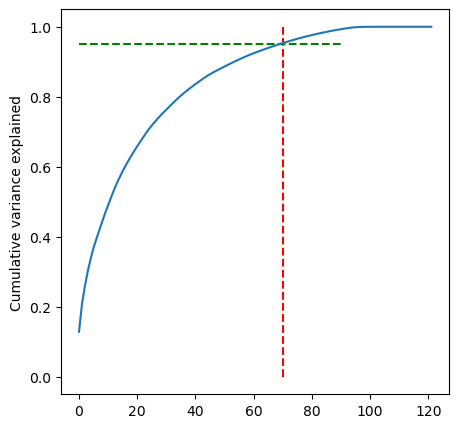

In [82]:
#scree plot

var_cumu = np.cumsum(pca.explained_variance_ratio_)
fig = plt.figure(figsize=[5,5])
plt.vlines(x=70, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=90, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [83]:
#we can see that less than 70 PCs is explaining around 95% of the total variance of the dataset.
#Perform PCA with 70 components
pca_final = IncrementalPCA(n_components=70)
train_pca = pca_final.fit_transform(X_train)
train_pca.shape

(47543, 70)

In [84]:
cormat = np.corrcoef(train_pca.transpose())

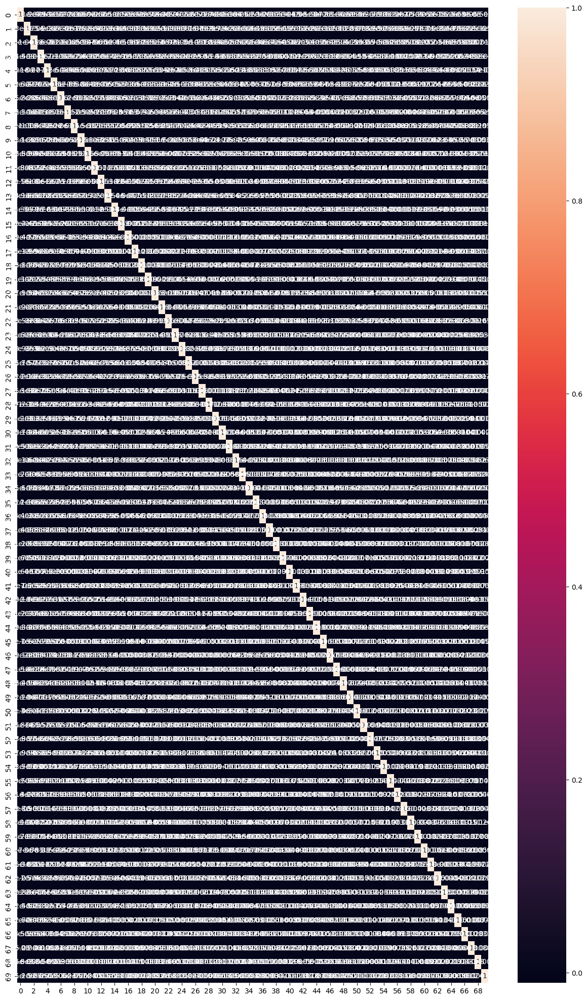

In [85]:
plt.figure(figsize=[15,25])
sns.heatmap(cormat, annot=True)
plt.show()

In [86]:
#the principal components are not correlated

<Axes: >

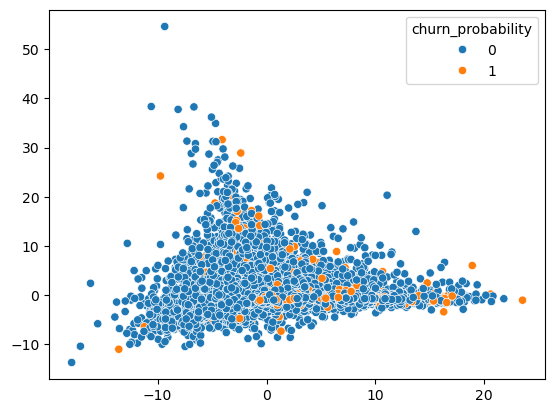

In [87]:
sns.scatterplot(x=train_pca[:,1], y=train_pca[:,2], hue=y_train)

In [88]:

#Applying the transformation on the test set
test_pca = pca_final.transform(X_test)
test_pca.shape

(20376, 70)

## Applying logistic regression (with default arguments) on the data on our Principal components

In [90]:
lr_pca = LogisticRegression()
lr_pca=lr_pca.fit(train_pca, y_train)

#predict probability on test data set
pred_probs_test = lr_pca.predict_proba(test_pca)

auc_score = metrics.roc_auc_score(y_test, pred_probs_test[:,1])

print("AUC score for train data",round(auc_score,2))

AUC score for train data 0.88


In [91]:
#predict probability on train data set
pred_probs_train = lr_pca.predict_proba(train_pca)

auc_score= metrics.roc_auc_score(y_train, pred_probs_train[:,1])


print("AUC score for test data",round(auc_score,2))

AUC score for test data 0.88


In [92]:
#calculate probability
pred_probs_test

array([[0.98563744, 0.01436256],
       [0.97303138, 0.02696862],
       [0.99685577, 0.00314423],
       ...,
       [0.96417855, 0.03582145],
       [0.95172716, 0.04827284],
       [0.97554196, 0.02445804]])

In [93]:
def get_confusion_matrix(y_test,y_pred):
    cm = confusion_matrix(y_test, y_pred)
    print('The confusion Matrix : \n',cm)
    
    TP = cm[1,1] # true positives 
    TN = cm[0,0] # true negatives
    FP = cm[0,1] # false positives
    FN = cm[1,0] # false negatives

    accuracy = metrics.accuracy_score(y_true=y_test,y_pred=y_pred)
    recall = TP/(FN+TP)
    specificity = TN/(TN+FP)
    precision = TP/(FP+TP)

    print("Accuracy = {:.2f}".format(accuracy))
    print("Sensitivity/Recall = {:.2f}".format(recall))
    print("Specificity = {:.2f}".format(specificity))
    print("Precision = {:.2f}".format(precision))

#### Metrics on Train data

In [95]:
get_confusion_matrix(y_train, lr_pca.predict(train_pca))

The confusion Matrix : 
 [[42184   477]
 [ 4101   781]]
Accuracy = 0.90
Sensitivity/Recall = 0.16
Specificity = 0.99
Precision = 0.62


#### Metrics on test data

In [97]:
get_confusion_matrix(y_test, lr_pca.predict(test_pca))

The confusion Matrix : 
 [[18078   205]
 [ 1773   320]]
Accuracy = 0.90
Sensitivity/Recall = 0.15
Specificity = 0.99
Precision = 0.61


### Hyperparameter tuning - PCA and Logistic Regression

In [99]:
# specify range of hyperparameters to tune

w = [{0: 0.1, 1: 0.9}, {0: 0.2, 1: 0.8}, {0: 0.15, 1: 0.85}, {0: 0.05, 1: 0.95}]
hyper_params = [
    {"class_weight": w, "C": [0.1, 0.5, 1, 2, 3, 4, 5, 10], "penalty": ["l1", "l2"]}
]

# create a 5 fold cross-validation scheme

folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=100)


In [100]:
estimator_model=LogisticRegression()
estimator_model

lr_pca2 = GridSearchCV(estimator = estimator_model, 
                          param_grid = hyper_params, 
                          scoring= 'roc_auc', 
                          cv = folds, 
                          return_train_score=True,
                          verbose = 1)  
lr_pca2.fit(train_pca, y_train)


Fitting 5 folds for each of 64 candidates, totalling 320 fits


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=100, shuffle=True),
             estimator=LogisticRegression(),
             param_grid=[{'C': [0.1, 0.5, 1, 2, 3, 4, 5, 10],
                          'class_weight': [{0: 0.1, 1: 0.9}, {0: 0.2, 1: 0.8},
                                           {0: 0.15, 1: 0.85},
                                           {0: 0.05, 1: 0.95}],
                          'penalty': ['l1', 'l2']}],
             return_train_score=True, scoring='roc_auc', verbose=1)

In [101]:
gridcv = pd.DataFrame(lr_pca2.cv_results_)
gridcv

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_class_weight,param_penalty,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.013720,0.001754,0.000000,0.000000,0.1,"{0: 0.1, 1: 0.9}",l1,"{'C': 0.1, 'class_weight': {0: 0.1, 1: 0.9}, '...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.170532,0.008630,0.007728,0.001027,0.1,"{0: 0.1, 1: 0.9}",l2,"{'C': 0.1, 'class_weight': {0: 0.1, 1: 0.9}, '...",0.872954,0.871483,0.875796,0.871519,0.868700,0.872090,0.002309,24,0.874364,0.874706,0.874499,0.875388,0.876306,0.875053,0.000719
2,0.012698,0.000981,0.000000,0.000000,0.1,"{0: 0.2, 1: 0.8}",l1,"{'C': 0.1, 'class_weight': {0: 0.2, 1: 0.8}, '...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.187443,0.018489,0.006531,0.000656,0.1,"{0: 0.2, 1: 0.8}",l2,"{'C': 0.1, 'class_weight': {0: 0.2, 1: 0.8}, '...",0.875215,0.872592,0.877168,0.872619,0.869534,0.873425,0.002596,8,0.875645,0.876333,0.875651,0.876672,0.877244,0.876309,0.000613
4,0.012977,0.005746,0.000000,0.000000,0.1,"{0: 0.15, 1: 0.85}",l1,"{'C': 0.1, 'class_weight': {0: 0.15, 1: 0.85},...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,0.157503,0.014886,0.005452,0.000860,0.1,"{0: 0.15, 1: 0.85}",l2,"{'C': 0.1, 'class_weight': {0: 0.15, 1: 0.85},...",0.874345,0.872271,0.876765,0.872306,0.869338,0.873005,0.002466,16,0.875256,0.875849,0.875316,0.876292,0.876976,0.875938,0.000642
6,0.010558,0.000779,0.000000,0.000000,0.1,"{0: 0.05, 1: 0.95}",l1,"{'C': 0.1, 'class_weight': {0: 0.05, 1: 0.95},...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,0.150441,0.015318,0.003950,0.002467,0.1,"{0: 0.05, 1: 0.95}",l2,"{'C': 0.1, 'class_weight': {0: 0.05, 1: 0.95},...",0.869595,0.868701,0.873141,0.869270,0.866812,0.869504,0.002058,25,0.872245,0.872164,0.872366,0.872887,0.874257,0.872784,0.000778
8,0.012228,0.000783,0.000000,0.000000,0.5,"{0: 0.1, 1: 0.9}",l1,"{'C': 0.5, 'class_weight': {0: 0.1, 1: 0.9}, '...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,0.197876,0.021681,0.005856,0.002958,0.5,"{0: 0.1, 1: 0.9}",l2,"{'C': 0.5, 'class_weight': {0: 0.1, 1: 0.9}, '...",0.872904,0.871464,0.875819,0.871507,0.868833,0.872106,0.002276,23,0.874433,0.874776,0.874530,0.875420,0.876375,0.875107,0.000721


In [102]:
# print best hyperparameters

print("Best AUC: ", lr_pca2.best_score_)
print("Best hyperparameters: ", lr_pca2.best_params_)
#similar AUC score received 
lr_pca2_final=lr_pca2.best_estimator_


Best AUC:  0.8736323120626637
Best hyperparameters:  {'C': 10, 'class_weight': {0: 0.2, 1: 0.8}, 'penalty': 'l2'}


In [103]:
#AUC score on test set
lr_pca2_final.fit(train_pca, y_train)

pred_probs_test = lr_pca2_final.predict_proba(test_pca)

metrics.roc_auc_score(y_test, pred_probs_test[:,1])


0.8829605481520185

In [104]:
pred_probs_train = lr_pca2_final.predict_proba(train_pca)
y_train_pred=pd.DataFrame()
y_train_pred["churn_proba"]=pred_probs_train[:,1]
y_train_pred

,churn_proba
0,1.251884e-01
1,1.764885e-01
2,4.987706e-01
3,6.436128e-01
4,2.370371e-02
...,...
47538,6.714747e-01
47539,8.007995e-02
47540,8.821035e-03
47541,9.520740e-07


In [105]:
# Let's create columns with different probability cutoffs 
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred[i]= y_train_pred.churn_proba.map(lambda x: 1 if x > i else 0)
y_train_pred.head()


,churn_proba,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0.125188,1,1,0,0,0,0,0,0,0,0
1,0.176488,1,1,0,0,0,0,0,0,0,0
2,0.498771,1,1,1,1,1,0,0,0,0,0
3,0.643613,1,1,1,1,1,1,1,0,0,0
4,0.023704,1,0,0,0,0,0,0,0,0,0


In [106]:
# Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.

cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train, y_train_pred[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.102686  1.000000  0.000000
0.1   0.1  0.512357  0.943261  0.463046
0.2   0.2  0.660875  0.901270  0.633365
0.3   0.3  0.758745  0.854158  0.747826
0.4   0.4  0.830049  0.802130  0.833243
0.5   0.5  0.876154  0.715281  0.894564
0.6   0.6  0.901268  0.583367  0.937648
0.7   0.7  0.903666  0.326096  0.969762
0.8   0.8  0.900806  0.125768  0.989499
0.9   0.9  0.898218  0.037280  0.996742


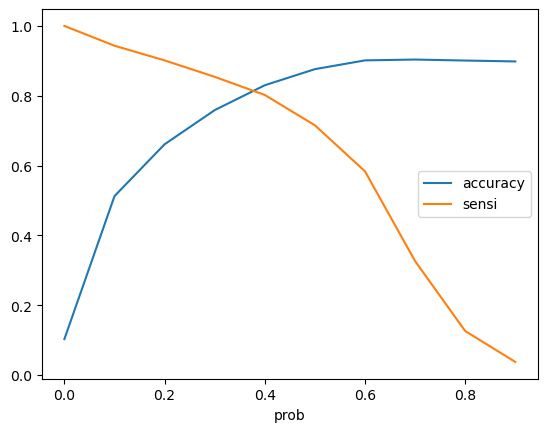

In [107]:
cutoff_df.plot.line(x='prob', y=['accuracy','sensi'])
plt.show()

In [108]:
pred_probs_test = lr_pca2_final.predict_proba(test_pca)[:,1]
test_prediction=pd.DataFrame()
test_prediction["actual"]=y_test
test_prediction["proba"]=pred_probs_test

test_prediction["predicted_.33"]=test_prediction.proba.map(lambda x: 1 if x > .33 else 0)
test_prediction["predicted_.6"]=test_prediction.proba.map(lambda x: 1 if x > .6 else 0)
test_prediction.head(5)

,actual,proba,predicted_.33,predicted_.6
56733,0,0.074576,0,0
33442,0,0.089722,0,0
60427,0,0.017672,0,0
10627,0,0.172040,0,0
56394,0,0.079214,0,0


In [109]:
print("with cutoff .33, the test accuracy score is",metrics.accuracy_score(test_prediction.actual,test_prediction["predicted_.33"]))
print("with cutoff .6, the test accuracy score is",metrics.accuracy_score(test_prediction.actual,test_prediction["predicted_.6"]))

with cutoff .33, the test accuracy score is 0.7838633686690224
with cutoff .6, the test accuracy score is 0.9002748331370239


In [110]:
cm33=confusion_matrix(test_prediction.actual,test_prediction["predicted_.33"])
cm60=confusion_matrix(test_prediction.actual,test_prediction["predicted_.6"])

print("with cutoff .33, the test sensitivity is",cm33[1,1]/(cm33[1,0]+cm33[1,1]))
print("with cutoff .6, the test sensitivity is",cm60[1,1]/(cm60[1,0]+cm60[1,1]))
    

with cutoff .33, the test sensitivity is 0.8494983277591973
with cutoff .6, the test sensitivity is 0.5785953177257525


## Prediction on unseen data using logistic regression

In [112]:
#for kaggle submission, apply this model on unseen data
unseen.shape
unseen.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g
0,69999,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,91.882,65.330,64.445,31.78,20.23,23.11,60.16,32.16,34.83,0.00,0.00,0.00,0.00,0.00,0.00,24.88,20.23,21.06,18.13,10.89,8.36,0.00,13.58,0.00,0.0,0.00,0.03,43.01,44.71,29.43,6.90,0.00,2.05,42.03,7.68,26.43,0.0,0.0,0.0,0.0,0.0,0.0,48.93,7.68,28.48,0.0,0.0,0.0,0.00,0.00,0.03,0.0,0.0,0.0,91.94,52.39,57.94,30.33,37.56,21.98,10.21,4.59,9.53,0.26,0.00,0.00,40.81,42.16,31.51,0.00,0.00,0.00,0.36,1.04,4.34,0.0,0.0,0.00,0.0,0.0,0.0,0.36,1.04,4.34,41.73,43.56,36.26,0.54,0.34,0.39,0.00,0.00,0.00,0.0,0.0,0.00,5,5,4,103,90,60,50,30,30,6/21/2014,7/26/2014,8/24/2014,30,30,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1692,0.00,0.00,0.00
1,70000,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,414.168,515.568,360.868,75.51,41.21,19.84,474.34,621.84,394.94,0.00,0.00,0.00,0.00,0.00,0.00,75.51,41.21,19.84,473.61,598.08,377.26,0.73,0.00,0.00,0.0,0.00,0.00,549.86,639.29,397.11,0.00,0.00,0.00,0.00,23.76,17.68,0.0,0.0,0.0,0.0,0.0,0.0,0.00,23.76,17.68,0.0,0.0,0.8,0.00,0.00,0.00,0.0,0.0,0.0,549.86,663.06,415.59,19.99,26.95,2.61,160.19,122.29,184.81,1.49,0.00,0.00,181.69,149.24,187.43,0.00,0.00,0.00,0.00,12.51,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.00,12.51,0.00,296.33,339.64,281.66,0.00,0.00,0.00,114.63,177.88,94.23,0.0,0.0,0.00,5,4,5,500,500,500,250,250,250,6/19/2014,7/16/2014,8/24/2014,250,0,0,NaN,NaN,Na

### Apply scaling on unseen data

In [114]:
# capture customer id
Final_pred=pd.DataFrame()
Final_pred['id']=unseen.id
Final_pred.head(5)

,id
0,69999
1,70000
2,70001
3,70002
4,70003


Applying all the Pre-processing on the test data

In [116]:
unseen_v1 = unseen.drop(drop_list,axis=1)
unseen_v1 = unseen_v1.drop('id',axis=1)

In [117]:
unseen_v1 = unseen_v1.drop(date_drop,axis=1)

In [118]:
#imputing with median

unseen_v1[cols_with_nulls] = median_imputation.fit_transform(unseen_v1[cols_with_nulls])

In [119]:
unseen_v1['aon_months'] = unseen_v1['aon'].apply(lambda x: round((x/365)*12,2))
unseen_v1['mean_arpu'] = round((unseen_v1['arpu_6']+unseen_v1['arpu_7']+unseen_v1['arpu_8'])/3,2)
unseen_v1['avg_customer_Spend'] = unseen_v1['aon_months']*unseen_v1['mean_arpu']
unseen_v1.drop(columns = ['aon','arpu_6','arpu_7','arpu_8','mean_arpu','aon_months'],axis=1,inplace=True)

In [120]:
unseen_v1['customer_value'] = unseen_v1['avg_customer_Spend'].apply(
    lambda x: 'HCV' if x > HVC else ('LCV' if x < LVC else 'MCV')) # MVC- Medium value customers
unseen_v1['customer_value'].value_counts()

customer_value
MCV    13497
HCV    10416
LCV     6087
Name: count, dtype: int64

In [121]:
unseen_v1.shape

(30000, 122)

In [122]:
unseen_v1['customer_value'] = unseen_v1['customer_value'].apply(lambda x:2 if x=='HVC' else (0 if x=='LVC' else 1))

In [123]:
unseen_v1.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 122 columns):
 #    Column              Dtype  
---   ------              -----  
 0    onnet_mou_6         float64
 1    onnet_mou_7         float64
 2    onnet_mou_8         float64
 3    offnet_mou_6        float64
 4    offnet_mou_7        float64
 5    offnet_mou_8        float64
 6    roam_ic_mou_6       float64
 7    roam_ic_mou_7       float64
 8    roam_ic_mou_8       float64
 9    roam_og_mou_6       float64
 10   roam_og_mou_7       float64
 11   roam_og_mou_8       float64
 12   loc_og_t2t_mou_6    float64
 13   loc_og_t2t_mou_7    float64
 14   loc_og_t2t_mou_8    float64
 15   loc_og_t2m_mou_6    float64
 16   loc_og_t2m_mou_7    float64
 17   loc_og_t2m_mou_8    float64
 18   loc_og_t2f_mou_6    float64
 19   loc_og_t2f_mou_7    float64
 20   loc_og_t2f_mou_8    float64
 21   loc_og_t2c_mou_6    float64
 22   loc_og_t2c_mou_7    float64
 23   loc_og_t2c_mou_8    float64
 24   

In [124]:
unseen_v2=unseen_v1.copy()

In [125]:
var=unseen_v2.columns
unseen_v2[var] = scaler.transform(unseen_v2[var])

In [126]:
unseen_v2_pca_70 = pca_final.transform(unseen_v2)

In [127]:
Final_pred['churn_probability'] = lr_pca2_final.predict(unseen_v2_pca_70)

# Random Forest

In [129]:
forest = RandomForestClassifier(
    random_state=42, 
    n_jobs=-1, 
    oob_score=True, 
    class_weight={0: 0.2, 1: 0.8}
)
#using same weight as logistic regression model, to reduce number of fits
params = {
    'n_estimators': [100, 200, 300],
    'min_samples_leaf': [40,30,60],
}

folds = StratifiedKFold(n_splits = 5, shuffle = True, random_state = 42)

In [130]:
#performing CV search
grid_search = GridSearchCV(
    estimator=forest,
    param_grid=params,
    scoring='roc_auc',
    cv=folds,
    n_jobs=-1,
    verbose=3
)

grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 9 candidates, totalling 45 fits


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=RandomForestClassifier(class_weight={0: 0.2, 1: 0.8},
                                              n_jobs=-1, oob_score=True,
                                              random_state=42),
             n_jobs=-1,
             param_grid={'min_samples_leaf': [40, 30, 60],
                         'n_estimators': [100, 200, 300]},
             scoring='roc_auc', verbose=3)

In [131]:
print("best roc_auc",grid_search.best_score_)

best roc_auc 0.9388107488548982


In [132]:
#select the model which gives best score
rf_best = grid_search.best_estimator_
rf_best

RandomForestClassifier(class_weight={0: 0.2, 1: 0.8}, min_samples_leaf=30,
                       n_estimators=300, n_jobs=-1, oob_score=True,
                       random_state=42)

In [133]:
#check AUC score on training dataset
metrics.roc_auc_score(y_train, rf_best.predict_proba(X_train)[:,1])


0.9741151795102039

In [134]:
#check AUC score on test dataset
metrics.roc_auc_score(y_test, rf_best.predict_proba(X_test)[:,1])

0.939950612965935

#### Both test and train AUC in random forest has been improved and better than logistic regression

In [136]:
#lets find out the cut-off for highest accuracy and higher sensitivity
# Let's create columns with different probability cutoffs 

y_train_rf_pred=pd.DataFrame()
y_train_rf_pred["churn_proba"]=rf_best.predict_proba(X_train)[:,1]
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_rf_pred[i]= y_train_rf_pred["churn_proba"].map(lambda x: 1 if x > i else 0)
y_train_rf_pred.head()

,churn_proba,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0.049816,1,0,0,0,0,0,0,0,0,0
1,0.028125,1,0,0,0,0,0,0,0,0,0
2,0.992681,1,1,1,1,1,1,1,1,1,1
3,0.994144,1,1,1,1,1,1,1,1,1,1
4,0.024390,1,0,0,0,0,0,0,0,0,0


In [137]:
cutoff_rf_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train, y_train_rf_pred[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_rf_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_rf_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.102812  1.000000  0.000141
0.1   0.1  0.726584  1.000000  0.695295
0.2   0.2  0.869129  0.973986  0.857129
0.3   0.3  0.918558  0.911102  0.919411
0.4   0.4  0.937656  0.845555  0.948196
0.5   0.5  0.943146  0.767718  0.963222
0.6   0.6  0.942810  0.688652  0.971895
0.7   0.7  0.942978  0.630070  0.978786
0.8   0.8  0.943104  0.577632  0.984928
0.9   0.9  0.932945  0.397173  0.994257


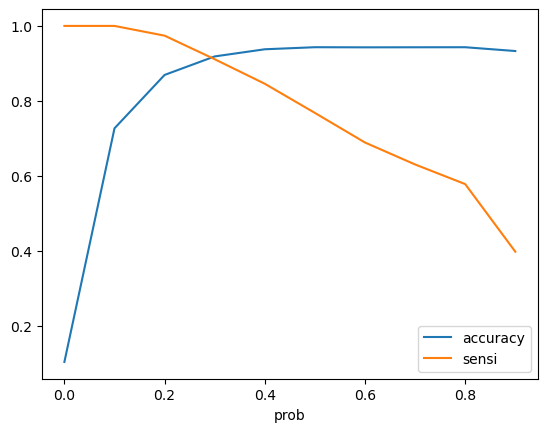

In [138]:
# Let's plot accuracy sensitivity and specificity for various probabilities.
cutoff_rf_df.plot.line(x='prob', y=['accuracy','sensi'])
plt.show()

In [143]:
#based on above graph, for highest accuracy, we are taking the cut off .6 
#for higher sentivity with as high as possible accuracy,  we can take cutoff probability of .3

test_rf_prediction=pd.DataFrame()
test_rf_prediction["actual"]=y_test
test_rf_prediction["proba"]=rf_best.predict_proba(X_test)[:,1]
test_rf_prediction["predicted_.3"]=test_rf_prediction["proba"].map(lambda x: 1 if x>.3 else 0)
test_rf_prediction["predicted_.6"]=test_rf_prediction["proba"].map(lambda x: 1 if x>.6 else 0)

In [140]:
test_rf_prediction.head()

,actual,proba,predicted_.25,predicted_.6
56733,0,0.020141,0,0
33442,0,0.024656,0,0
60427,0,0.043725,0,0
10627,0,0.019825,0,0
56394,0,0.162451,0,0


In [145]:
#check test accuracy with .6 of cutoff probobility
print("Using random forest the test accuracy is",metrics.accuracy_score(test_rf_prediction["actual"],test_rf_prediction["predicted_.6"]))
confusion=metrics.confusion_matrix(test_rf_prediction["actual"],test_rf_prediction["predicted_.6"])
confusion

#we got more test accuracy than logistic regression model

Using random forest the test accuracy is 0.940616411464468


array([[17772,   511],
       [  699,  1394]], dtype=int64)

In [147]:
#check sensitivity with .3 of cutoff probability

confusion=metrics.confusion_matrix(test_rf_prediction["actual"],test_rf_prediction["predicted_.3"])
sensi_rf_test=confusion[1,1]/(confusion[1,0]+confusion[1,1])
print("Using random forest the sensitivity on test set is",sensi_rf_test)

#we got more sensitivity on test data than logistic regression 
confusion

Using random forest the sensitivity on test set is 0.8270425226946966


array([[16662,  1621],
       [  362,  1731]], dtype=int64)

In [149]:
#as we got higher accuracy with RandonForest, lets use the same model on unseen data for kaggle submissin
unseen_rf_test=unseen_v2
unseen_rf_test.shape

(30000, 122)

In [151]:
#predict churn probalities and storing the same against id
#output the kaggle submission file based on cutoff prob of .6
pred_probs_rf_unseen = rf_best.predict_proba(unseen_rf_test)

submission_rf_data=pd.DataFrame()
submission_rf_data["id"]=unseen.id
submission_rf_data["proba"]=pred_probs_rf_unseen[:,1]
submission_rf_data["churn_probability"]=submission_rf_data["proba"].map(lambda x: 1 if x > .6 else 0)
submission_rf_data.head()

,id,proba,churn_probability
0,69999,0.072636,0
1,70000,0.088744,0
2,70001,0.793487,1
3,70002,0.115092,0
4,70003,0.049573,0


In [153]:
#preparing the file for submission
submission_rf_data=submission_rf_data.drop("proba", axis=1, errors="ignore")
submission_rf_data.head()

,id,churn_probability
0,69999,0
1,70000,0
2,70001,1
3,70002,0
4,70003,0


In [155]:
submission_rf_data.churn_probability.value_counts()

churn_probability
0    27431
1     2569
Name: count, dtype: int64

# XGBoost Classifier 

In [157]:
xgb_cf = xgb.XGBClassifier(n_jobs = -1,objective = 'binary:logistic')

In [159]:

xgb_cf.fit(X_train, y_train)  # default 

# Get our predictions
xgb_predictions = xgb_cf.predict(X_test)

In [160]:
#check AUC score on test dataset
metrics.roc_auc_score(y_test, xgb_cf.predict_proba(X_test)[:,1])

0.9383175319267056

In [163]:
#predict churn probalities and storing the same against id
pred_probs_xgb_unseen = xgb_cf.predict_proba(unseen_v2)

submission_xgb_data=pd.DataFrame()
submission_xgb_data["id"]=unseen.id
submission_xgb_data["proba"]=pred_probs_xgb_unseen[:,1]
submission_xgb_data["churn_probability"]=submission_xgb_data["proba"].map(lambda x: 1 if x > .5 else 0)
submission_xgb_data.head()

,id,proba,churn_probability
0,69999,0.001112,0
1,70000,0.008428,0
2,70001,0.879238,1
3,70002,0.104423,0
4,70003,0.002559,0


In [165]:
#preparing the file for submission
submission_xgb_data=submission_xgb_data.drop("proba", axis=1, errors="ignore")
submission_xgb_data.head()

,id,churn_probability
0,69999,0
1,70000,0
2,70001,1
3,70002,0
4,70003,0


# XGBoost with Randomized Search CV 

In [167]:
xgb_cl = xgb.XGBClassifier(n_jobs = -1,objective = 'binary:logistic',random_state=42, class_weight={0:0.2, 1: 0.8})

In [169]:
# A parameter grid for XGBoost
params = {
    "n_estimators": [100, 200, 300],  # no of trees
    "learning_rate": [0.05],  # eta
    "min_child_weight": [3, 5, 7,9],
    "gamma": [0.1],
    "subsample": [0.8],
    "colsample_bytree": [0.6, 0.8, 1.0],
}

folds = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)

param_comb = 800

sgb = RandomizedSearchCV(
    xgb_cl,
    param_distributions=params,
    n_iter=param_comb,
    scoring="roc_auc",
    n_jobs=-1,
    cv=folds,
    verbose=3,
    random_state=42,
)


In [171]:
sgb.fit(X_train,y_train)

Fitting 4 folds for each of 36 candidates, totalling 144 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=4, random_state=42, shuffle=True),
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           class_weight={0: 0.2, 1: 0.8},
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=Non...
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints=None,
                                           multi_strategy=None,
                                           n_estimators=None, n_jobs=-1,
                                           num_parallel_tree=None, ...),
                   n_iter=800, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.6, 0.8, 1.0],
                                        'gamma': [0.1], 'learning_rate': [0.05],
                                        'min_child_weight': [3, 5, 7, 9],
                                        'n_estimators': [100, 200, 300],
                                        'subsample': [0.8]},
                   random_state=42, scoring='roc_auc', verbose=3)

In [172]:
print("The best ROC_AUC is ",sgb.best_score_)
xgb_best=sgb.best_estimator_
xgb_best

The best ROC_AUC is  0.9431734973158379


XGBClassifier(base_score=None, booster=None, callbacks=None,
              class_weight={0: 0.2, 1: 0.8}, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.8, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0.1, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.05, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=7, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=-1, num_parallel_tree=None, ...)

In [175]:
#check AUC score on train dataset
metrics.roc_auc_score(y_train, xgb_best.predict_proba(X_train)[:,1])

0.9744759090370152

In [177]:
#check AUC score on test dataset
metrics.roc_auc_score(y_test, xgb_best.predict_proba(X_test)[:,1])

0.9462407398004496

In [179]:
y_train_xgb_pred=pd.DataFrame()
y_train_xgb_pred["churn_proba"]=xgb_best.predict_proba(X_train)[:,1]
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_xgb_pred[i]= y_train_xgb_pred["churn_proba"].map(lambda x: 1 if x > i else 0)
y_train_xgb_pred.head()

,churn_proba,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0.004770,1,0,0,0,0,0,0,0,0,0
1,0.006676,1,0,0,0,0,0,0,0,0,0
2,0.965890,1,1,1,1,1,1,1,1,1,1
3,0.973623,1,1,1,1,1,1,1,1,1,1
4,0.002992,1,0,0,0,0,0,0,0,0,0


In [181]:
cutoff_xgb_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train, y_train_xgb_pred[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_xgb_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_xgb_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.102686  1.000000  0.000000
0.1   0.1  0.911070  0.929742  0.908933
0.2   0.2  0.944661  0.874232  0.952720
0.3   0.3  0.952401  0.819951  0.967558
0.4   0.4  0.953032  0.758910  0.975247
0.5   0.5  0.953200  0.708316  0.981224
0.6   0.6  0.951497  0.634781  0.987741
0.7   0.7  0.943125  0.508808  0.992827
0.8   0.8  0.932251  0.361532  0.997562
0.9   0.9  0.911049  0.135190  0.999836


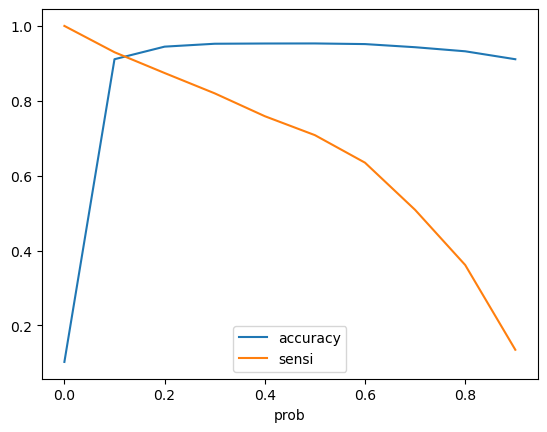

In [183]:
cutoff_xgb_df.plot.line(x='prob', y=['accuracy','sensi'])
plt.show()

In [185]:
#based on above graph, for highest accuracy, we are taking the cut off .5
#for higher sentivity with as high as possible accuracy,  we can take cutoff probabilities of .12

test_xgb_prediction=pd.DataFrame()
test_xgb_prediction["actual"]=y_test
test_xgb_prediction["proba"]=xgb_best.predict_proba(X_test)[:,1]
test_xgb_prediction["predicted_.12"]=test_xgb_prediction["proba"].map(lambda x: 1 if x>.12 else 0)
test_xgb_prediction["predicted_.5"]=test_xgb_prediction["proba"].map(lambda x: 1 if x>.5 else 0)

In [187]:
test_xgb_prediction.head()

,actual,proba,predicted_.12,predicted_.5
56733,0,0.005450,0,0
33442,0,0.011085,0,0
60427,0,0.009930,0,0
10627,0,0.005311,0,0
56394,0,0.023528,0,0


In [189]:
#check test accuracy with .5 of cutoff probobility
print("Using xgboost the test accuracy is",metrics.accuracy_score(test_xgb_prediction["actual"],test_xgb_prediction["predicted_.5"]))
confusion=metrics.confusion_matrix(test_xgb_prediction["actual"],test_xgb_prediction["predicted_.5"])
confusion
#we got more test accuracy than logistic regression model

Using xgboost the test accuracy is 0.9441499803690616


array([[17872,   411],
       [  727,  1366]], dtype=int64)

In [191]:
confusion=metrics.confusion_matrix(test_xgb_prediction["actual"],test_xgb_prediction["predicted_.12"])
sensi_xgb_test=confusion[1,1]/(confusion[1,0]+confusion[1,1])
print("Using XGBoost the sensitivity on test set is",sensi_xgb_test)

confusion

Using XGBoost the sensitivity on test set is 0.8399426660296225


array([[16699,  1584],
       [  335,  1758]], dtype=int64)

#### XGBoost is peforming like random forest with very minimul improvement over accuracy and sentivity

In [193]:
#as we got higher accuracy with RandonForest, lets use the same model on unseen data for kaggle submissin
unseen.head()
unseen_xgb_test=unseen_v2
unseen_xgb_test.shape

(30000, 122)

In [195]:
#output the kaggle submission file based on cutoff prob of .5
pred_probs_xgb_unseen = xgb_best.predict_proba(unseen_xgb_test)

submission_xgb_data_cv=pd.DataFrame()
submission_xgb_data_cv["id"]=unseen.id
submission_xgb_data_cv["proba"]=pred_probs_xgb_unseen[:,1]
submission_xgb_data_cv["churn_probability"]=submission_xgb_data_cv["proba"].map(lambda x: 1 if x > .5 else 0)
submission_xgb_data_cv.head()

,id,proba,churn_probability
0,69999,0.005532,0
1,70000,0.024321,0
2,70001,0.685536,1
3,70002,0.025272,0
4,70003,0.012647,0


In [197]:
#preparing the file for submission
submission_xgb_data_cv=submission_xgb_data_cv.drop("proba", axis=1, errors="ignore")
submission_xgb_data_cv.head()

,id,churn_probability
0,69999,0
1,70000,0
2,70001,1
3,70002,0
4,70003,0


# 7. Creating submission file


In [199]:
Final_pred.to_csv("HemalPatel_ManikeshBoyini_logistic.csv",index=False)

In [201]:
submission_rf_data.to_csv('HemalPatel_ManikeshBoyini_rf.csv',index=False)

In [205]:
submission_xgb_data.to_csv('submission_xgb.csv',index=False)

In [207]:
### Final model that is submitted in kaggle 
submission_xgb_data_cv.to_csv('submission_xgb_cv.csv',index=False)

## Recommendations

1. Customers who make calls while roaming tend to have a higher churn rate. Roaming packages and rates should be reassessed based on customer feedback.

2. Voice call usage, rather than data usage, has a greater impact on reducing churn, suggesting that network quality is good. However, it is surprising that data-related factors have a limited effect on churn. Since higher data recharge amounts are associated with lower churn, the company should introduce more attractive data offers to keep pace with advancements in electronic devices.

3. Unlike local calls, STD voice call usage does not contribute to reduced churn. The company should focus on optimizing STD rates to encourage more usage.

4. Moreover, the company should gather customer queries and complaints and integrate this feedback into its business strategies to further reduce churn rates.rates.